## Описание данных и стратегии


### Торговая логика

Представлены результаты тестов стратегии на исторических данных цены фьючерсного контракта 1000BONKUSDT.

Модель шортовая - сделка открывается продажей и закрывается покупкой. Основана на поиске дивергенции между тех. индикатором и ценой актива.

Даннная модель предназначена только для торговли активами с высокой капитализацией и ликвидностью. Одновременно может быть открыта только одна сделка по одной монете.

Алгоритм работы (пример торговли модели): 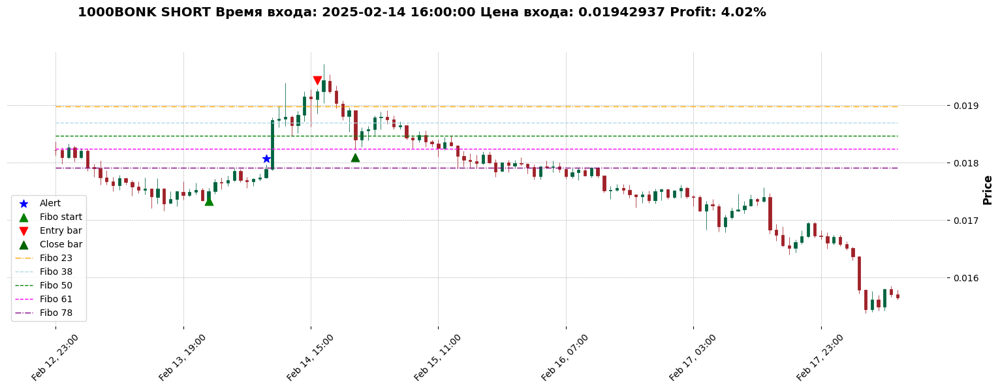

1. Алерт. При определенных рыночных условиях и значениях технических индикаторов (далее ТИ) срабатывает Алерт - сигнал на начало отслеживания моделью цены и поиска точки входа. Модель начинает отслеживать цену актива и искать точку входа, которая определяется относительно цены Алерта и ТИ. На графиках - синяя звезда.

2. Открытие сделки. Если точка входа найдена, то модель открывает сделку в шорт (продает базовый актив - далее БА). На графиках бар входа - красный треугольник. Если за t часов точка входа не найдена, то модель перестает отслеживать цену и ищет следующий Алерт.

3. Усреднение позиции. Если цена БА растет (рынок идет против нашей позиции), то модель совершает повторный вход каждые 4%. На графике не отмечено.

4. Закрытие сделки. При достижении ценой БА определенного уровня и/или соответствия технических индикаторов условиям выхода, модель закрывает сделку покупкой. На графике бар закрытия сделки - темно-зеленый  треугольник правее красного.

Прочие обозначения на графике:

- светло-зеленый треугольник левее красного - бар начала отсчета Фибоначчи

- линии fibo - уровни Фибоначчи.

Отметки на графике указывают на бар входа/выхода из сделки, а не на конкретную точку. Входы и выходы всегла по закрытию бара.

Используются исторические данные цены фьючерсного контракта 1000BONKUSDT за период с 2023-12-17 по 2025-03-19 (459 дней).

Источник данных: криптобиржа Binance

Таймфрейм: 1 час

## Результаты тестов

За период с 2023-12-17 по 2025-03-19 модель совершила 101 сделку и заработала +549% (за вычетом комиссии +512%).

Доля прибыли от всех прибыльных сделок к сумме % от всех прибыльных и убыточных сделок по модулю: 89% (за вычетом комиссии 87%).

Средняя прибыль на сделку +5,4%.

Частота сделок в среднем: 1,1 сделка в день.

ТОП-3 самых убыточных сделки принесли -22%, -13% и -11% соответственно.

ТОП-3 самых убыточных сделки: +74%, +40%, +30%.

Время в сделке варьиоуется от 1 до 49 часов, в среднем одна сделка длилась 12 часов.

Максимальное кол-во усреднений в 1 сделке - 22 входа.

Волатильность модели (стандартное отклонение прибыли за вычетом комиссии): 10,7%.

Коэффицент восстановления (сколько средних по прибыли сделок понадобится модели, чтобы восстановить накопленную прибыль после максимального убытка): 4 сделки / 4 дня.

### Легенда данных


Поля:

- 'timestamp' - временная метка в секундах

- 'date' - дата

- 'time' - время

- 'open' - цена открытия

- 'high' - максимальная цена

- 'low' - минимальная цена

- 'close' - цена закрытия

- 'volume' - реальные обемы

- 'close_time' - временная метка сремени закрытия в секундах

- 'quote_asset_volume' - объем торгов в валюте котировки USDT (сколько средств было вовлечено в торговлю)

- 'number_of_trades' - количество отдельных сделок, которые были выполнены. Каждая сделка может включать в себя покупку или продажу актива
       
-  'ignore' -

- taker_buy_base_asset_volume - сколько базового актива bonk было куплено в сделках, инициированных покупателями (тейкерами) в валюте базового актива (bonk)

- 'taker_buy_quote_asset_volume' - объем покупок тейкерами в валюте котировки USDT (quote asset) за определённый период времени (тейкер принимает уже существующие ордера, например, покупает по рыночной цене)

- ряд технических индикаторов.

## Загрузка и предобработка данных



### Загрузка данных

In [1]:
!pip install ta
!pip install plotly
!pip install nest_asyncio

!pip install mplfinance
!pip install --upgrade mplfinance

  Preparing metadata (setup.py) ... done
  Created wheel for ta: filename=ta-0.11.0-py3-none-any.whl size=29412 sha256=cf40b98454920307f3244baa73590f57b29cf29c5ef93b6c10aa922404a435b6
  Stored in directory: /root/.cache/pip/wheels/a1/d7/29/7781cc5eb9a3659d032d7d15bdd0f49d07d2b24fec29f44bc4
Successfully built ta
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.0/75.0 kB 3.2 MB/s eta 0:00:00


In [2]:
import pandas as pd
import numpy as np
import asyncio
import aiohttp
import ta
import shutil
from google.colab import files

import mplfinance as mpf
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import matplotlib.pyplot as plt

In [4]:
# получение данных с бинанс
async def fetch_binance_data(session, symbol, interval, limit=10):
    url = f"https://fapi.binance.com/fapi/v1/klines"
    params = {'symbol': symbol, 'interval': interval, 'limit': limit}

    try:
        async with session.get(url, params=params) as response:
            if response.status != 200:
                raise ValueError(f"Не удалось получить данные для {symbol}. Код: {response.status}")
            data = await response.json()
            columns = ['timestamp', 'open', 'high', 'low', 'close', 'volume', 'close_time',
                       'quote_asset_volume', 'number_of_trades', 'taker_buy_base_asset_volume',
                       'taker_buy_quote_asset_volume', 'ignore']
            bonk = pd.DataFrame(data, columns=columns)
            bonk['timestamp'] = pd.to_datetime(bonk['timestamp'], unit='ms')
            bonk[['open', 'high', 'low', 'close', 'volume']] = bonk[['open', 'high', 'low', 'close', 'volume']].astype(float)
            return bonk
    except Exception as e:
        print(f"Ошибка при получении данных {symbol}: {e}")
        return None

In [5]:
bonk = pd.read_excel('bonk_with_indic_1h.xlsx')
bonk

,Unnamed: 0.1,Unnamed: 0,timestamp,open,high,low,close,volume,quote_asset_volume,number_of_trades,...,ADX_24,ema,bulls_power,bears_power,bb_power,bb_power_24_sum,ind_rsi_fibo_start,fibo_start_price,fibo_potencial,RSI_18
0,0,0,1702774800000,0.021752,0.022663,0.021626,0.021885,1799097465,3.987555e+07,219060,...,0.000000,0.021885,3.554946,-1.183459,2,0,0,0.000000,0.0,NaN
1,1,1,1702778400000,0.021894,0.022463,0.021750,0.021770,1030023737,2.270501e+07,141623,...,0.000000,0.021876,2.684245,-0.575065,2,0,0,0.000000,0.0,NaN
2,2,2,1702782000000,0.021769,0.022618,0.021331,0.022389,1596517538,3.505544e+07,194214,...,0.000000,0.021917,3.199108,-2.673084,0,0,0,0.000000,0.0,NaN
3,3,3,1702785600000,0.022381,0.022659,0.021714,0.021813,1329851901,2.942883e+07,192165,...,0.000000,0.021909,3.425387,-0.887998,2,0,0,0.000000,0.0,NaN
4,4,4,1702789200000,0.021813,0.021861,0.020606,0.020963,1693637825,3.594160e+07,199060,...,0.000000,0.021833,0.128688,-5.619517,-5,0,0,0.000000,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10995,10995,10995,1742356800000,0.010970,0.010998,0.010872,0.010879,78997469,8.630878e+05,7348,...,17.061558,0.010717,2.625685,1.449940,4,-37,10988,0.010524,3.3,55.215938
10996,10996,10996,1742360400000,0.010879,0.010935,0.010855,0.010909,56621335,6.163823e+05,7314,...,17.047772,0.010732,1.891480,1.146046,3,-31,10988,0.010524,3.5,56.094418
10997,10997,10997,1742364000000,0.010909,0.010948,0.010850,0.010874,64429140,7.017728e+05,7150,...,17.062461,0.010743,1.904750,0.992559,2,-26,10988,0.010524,3.2,54.767328
10998,10998,10998,1742367600000,0.010873,0.010886,0.010705,0.010746,292893362,3.162336e+06,17461,...,16.657902,0.010744,1.325662,-0.359066,1,-22,10988,0.010524,2.1,50.171119


In [13]:
# монета
coin_name = "1000BONK"

In [6]:
bonk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11000 entries, 0 to 10999
Data columns (total 37 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   Unnamed: 0.1                  11000 non-null  int64         
 1   Unnamed: 0                    11000 non-null  int64         
 2   timestamp                     11000 non-null  int64         
 3   open                          11000 non-null  float64       
 4   high                          11000 non-null  float64       
 5   low                           11000 non-null  float64       
 6   close                         11000 non-null  float64       
 7   volume                        11000 non-null  int64         
 8   quote_asset_volume            11000 non-null  float64       
 9   number_of_trades              11000 non-null  int64         
 10  taker_buy_base_asset_volume   11000 non-null  int64         
 11  taker_buy_quote_asset_volume

In [7]:
bonk.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'timestamp', 'open', 'high', 'low',
       'close', 'volume', 'quote_asset_volume', 'number_of_trades',
       'taker_buy_base_asset_volume', 'taker_buy_quote_asset_volume',
       'date_time', 'date', 'body_len', 'body_len_percent', 'shadow_up',
       'close_lag_1', 'close_lag_2', 'close_lead_1', 'close_lead_2', 'SMA_12',
       'RSI_24', 'RSI_12', 'RSI_14', 'RSI_6', 'CCI_24', 'ADX_24', 'ema',
       'bulls_power', 'bears_power', 'bb_power', 'bb_power_24_sum',
       'ind_rsi_fibo_start', 'fibo_start_price', 'fibo_potencial', 'RSI_18'],
      dtype='object')

In [ ]:
# оставляем только нужные поля
bonk = bonk[['timestamp', 'open', 'high', 'low', 'close', 'volume',
       'quote_asset_volume', 'number_of_trades',
       'taker_buy_base_asset_volume', 'taker_buy_quote_asset_volume']]

bonk

,timestamp,open,high,low,close,volume,quote_asset_volume,number_of_trades,taker_buy_base_asset_volume,taker_buy_quote_asset_volume
0,1702774800000,0.021752,0.022663,0.021626,0.021885,1799097465,3.987555e+07,219060,891157138,1.975511e+07
1,1702778400000,0.021894,0.022463,0.021750,0.021770,1030023737,2.270501e+07,141623,500251108,1.102819e+07
2,1702782000000,0.021769,0.022618,0.021331,0.022389,1596517538,3.505544e+07,194214,769920231,1.691640e+07
3,1702785600000,0.022381,0.022659,0.021714,0.021813,1329851901,2.942883e+07,192165,654157793,1.448096e+07
4,1702789200000,0.021813,0.021861,0.020606,0.020963,1693637825,3.594160e+07,199060,800980385,1.700039e+07
...,...,...,...,...,...,...,...,...,...,...
10995,1742356800000,0.010970,0.010998,0.010872,0.010879,78997469,8.630878e+05,7348,35431263,3.870515e+05
10996,1742360400000,0.010879,0.010935,0.010855,0.010909,56621335,6.163823e+05,7314,31506570,3.430631e+05
10997,1742364000000,0.010909,0.010948,0.010850,0.010874,64429140,7.017728e+05,7150,28974529,3.157042e+05
10998,1742367600000,0.010873,0.010886,0.010705,0.010746,292893362,3.162336e+06,17461,122677588,1.325550e+06


In [ ]:
# кол-во уникальных значений в кажд столбце (в timestamp должно быть равно кол-ву строк)
bonk.nunique()

,0
timestamp,11000
open,8966
high,8995
low,8845
close,9039
volume,11000
quote_asset_volume,11000
number_of_trades,10337
taker_buy_base_asset_volume,11000
taker_buy_quote_asset_volume,11000


### Предобработка данных

In [ ]:
# timestamp к дате и времени
bonk['date_time'] = pd.to_datetime(bonk['timestamp'], unit='ms')
bonk['date_time']

<ipython-input-8-5a13fb224183>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bonk['date_time'] = pd.to_datetime(bonk['timestamp'], unit='ms')


,date_time
0,2023-12-17 01:00:00
1,2023-12-17 02:00:00
2,2023-12-17 03:00:00
3,2023-12-17 04:00:00
4,2023-12-17 05:00:00
...,...
10995,2025-03-19 04:00:00
10996,2025-03-19 05:00:00
10997,2025-03-19 06:00:00
10998,2025-03-19 07:00:00


In [ ]:
# дата
bonk['date'] = bonk['date_time'].dt.date
bonk['date']

<ipython-input-9-1f9a2f5fca25>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bonk['date'] = bonk['date_time'].dt.date


,date
0,2023-12-17
1,2023-12-17
2,2023-12-17
3,2023-12-17
4,2023-12-17
...,...
10995,2025-03-19
10996,2025-03-19
10997,2025-03-19
10998,2025-03-19


In [ ]:
# кол-во уникальных дат
print(f"Кол-во уникальных дат: {bonk['date'].nunique()}")
print(f"Начало периода: {bonk['date'].min()}")
print(f"Конец периода: {bonk['date'].max()}")

Кол-во уникальных дат: 459
Начало периода: 2023-12-17
Конец периода: 2025-03-19


In [ ]:
# проверка, что нет пропусков: если в каждой дате по 24 записи, кроме первой и последней даты, то пропусков нет
bonk.groupby(by='date')['date'].count().sort_values()

,date
date,
2025-03-19,9
2023-12-17,23
2025-03-10,24
2025-03-09,24
2025-03-08,24
...,...
2025-03-16,24
2025-03-17,24
2025-03-18,24


### Добавление новых признаков: предыдущие и последующие бары, +/- бар, длина тела  и тени бара

<ipython-input-12-8c8bad305173>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bonk['body_len'] = bonk['close'] - bonk['open']


<Axes: >

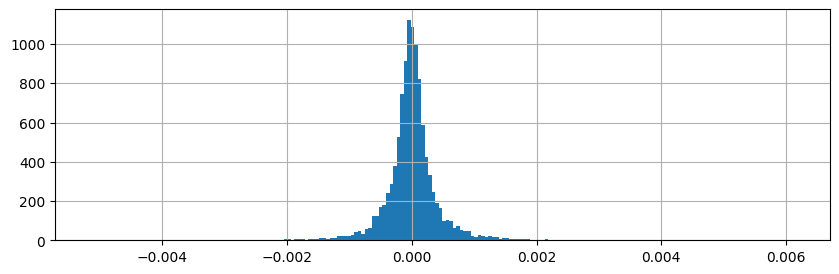

In [ ]:
# признак длина тела свечи
bonk['body_len'] = bonk['close'] - bonk['open']
bonk['body_len'].hist(bins=200, figsize=(10, 3))

<ipython-input-13-0ebdc44c2d47>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bonk['body_len_percent'] = round((bonk['body_len'] / bonk['open'])*100, 3)


<Axes: >

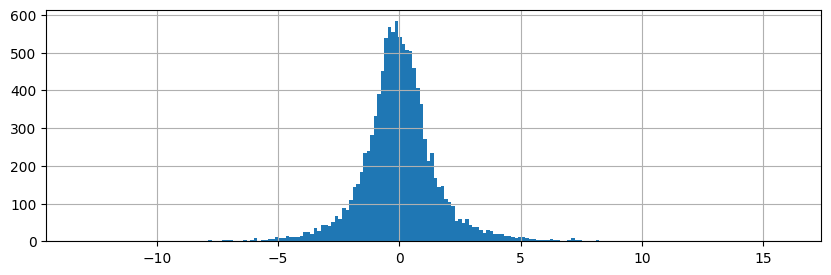

In [ ]:
# длина тела свечи в % от цены открытия
bonk['body_len_percent'] = round((bonk['body_len'] / bonk['open'])*100, 3)
bonk['body_len_percent'].hist(bins=200, figsize=(10, 3))

<ipython-input-14-8875c38300fe>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bonk['shadow_up'] = bonk.apply(get_shadow_up, axis=1)


<Axes: >

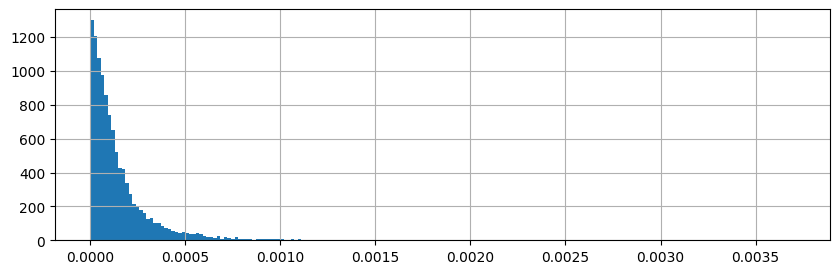

In [ ]:
# признак длина верхней тени в usdt (мб добавить в %)
def get_shadow_up(row):
  if row['body_len'] > 0:
    return row['high'] - row['close']
  else:
    return row['high'] - row['open']

bonk['shadow_up'] = bonk.apply(get_shadow_up, axis=1)
bonk['shadow_up'].hist(bins=200, figsize=(10, 3))

In [ ]:
# признаки: цена закрытия предыдущих баров от 1 до 16 включительно часов назад
for lag in range(1, 3):
  bonk[f"close_lag_{lag}"] = bonk['close'].shift(lag)
bonk.columns

Index(['timestamp', 'open', 'high', 'low', 'close', 'volume',
       'quote_asset_volume', 'number_of_trades', 'taker_buy_base_asset_volume',
       'taker_buy_quote_asset_volume', 'date_time', 'date', 'body_len',
       'body_len_percent', 'shadow_up', 'close_lag_1', 'close_lag_2'],
      dtype='object')

In [ ]:
# проверка, что лаги посчитались корректно
bonk[['close', 'close_lag_1', 'close_lag_2']].head(10)

,close,close_lag_1,close_lag_2
0,0.021885,NaN,NaN
1,0.021770,0.021885,NaN
2,0.022389,0.021770,0.021885
3,0.021813,0.022389,0.021770
4,0.020963,0.021813,0.022389
5,0.021345,0.020963,0.021813
6,0.020718,0.021345,0.020963
7,0.021409,0.020718,0.021345
8,0.021908,0.021409,0.020718
9,0.021487,0.021908,0.021409


In [ ]:
# признаки: цена закрытия последующих баров от 1 до 16 включительно часов после бара триггера
for lead in range(1, 3):
  bonk[f"close_lead_{lead}"] = bonk['close'].shift(-lead)
bonk.columns

Index(['timestamp', 'open', 'high', 'low', 'close', 'volume',
       'quote_asset_volume', 'number_of_trades', 'taker_buy_base_asset_volume',
       'taker_buy_quote_asset_volume', 'date_time', 'date', 'body_len',
       'body_len_percent', 'shadow_up', 'close_lag_1', 'close_lag_2',
       'close_lead_1', 'close_lead_2'],
      dtype='object')

In [ ]:
# проверка, что смещения вперед посчитались корректно
bonk[['close', 'close_lead_1', 'close_lead_2']].head(5)

,close,close_lead_1,close_lead_2
0,0.021885,0.021770,0.022389
1,0.021770,0.022389,0.021813
2,0.022389,0.021813,0.020963
3,0.021813,0.020963,0.021345
4,0.020963,0.021345,0.020718


### Расчет индикаторов

In [ ]:
bonk['SMA_12'] = bonk['close'].rolling(window=12).mean()

In [9]:
bonk['RSI_6'] = ta.momentum.rsi(bonk['close'], window=6)
bonk['RSI_8'] = ta.momentum.rsi(bonk['close'], window=8)
bonk['RSI_10'] = ta.momentum.rsi(bonk['close'], window=10)
bonk['RSI_12'] = ta.momentum.rsi(bonk['close'], window=12)
bonk['RSI_14'] = ta.momentum.rsi(bonk['close'], window=14)
bonk['RSI_18'] = ta.momentum.rsi(bonk['close'], window=18)
bonk['RSI_24'] = ta.momentum.rsi(bonk['close'], window=24)

In [10]:
bonk['RSI_6_low'] = ta.momentum.rsi(bonk['low'], window=6)
bonk['RSI_8_low'] = ta.momentum.rsi(bonk['low'], window=8)
bonk['RSI_10_low'] = ta.momentum.rsi(bonk['low'], window=10)
bonk['RSI_12_low'] = ta.momentum.rsi(bonk['low'], window=12)
bonk['RSI_14_low'] = ta.momentum.rsi(bonk['low'], window=14)
bonk['RSI_18_low'] = ta.momentum.rsi(bonk['low'], window=18)

In [ ]:
bonk['CCI_24'] = ta.trend.cci(bonk['high'], bonk['low'], bonk['close'], window=24)

In [ ]:
bonk['ADX_24'] = ta.trend.adx(bonk['high'], bonk['low'], bonk['close'], window=24)

#### Bulls Power и Bears Power

In [ ]:
# Рассчитываем Bulls Power и Bears Power
# Параметры
length = 24  # Длина EMA, можно настроить

# Расчет EMA
bonk['ema'] = bonk['close'].ewm(span=length, adjust=False).mean()

# Расчет bulls power и bears power в процентах
bonk['bulls_power'] = ((bonk['high'] - bonk['ema']) / bonk['ema']) * 100
bonk['bears_power'] = ((bonk['low'] - bonk['ema']) / bonk['ema']) * 100
bonk['bb_power'] = round(bonk['bulls_power'] + bonk['bears_power'], 1).astype(int)
# Выводим результаты
bonk[['bulls_power', 'bears_power', 'bb_power']][-10:]

,bulls_power,bears_power,bb_power
10990,2.533952,0.198284,2
10991,4.411365,1.894071,6
10992,3.155406,1.748742,4
10993,1.907230,1.167483,3
10994,2.630274,1.284793,3
10995,2.625685,1.449940,4
10996,1.891480,1.146046,3
10997,1.904750,0.992559,2
10998,1.325662,-0.359066,1
10999,0.414514,-0.060018,0


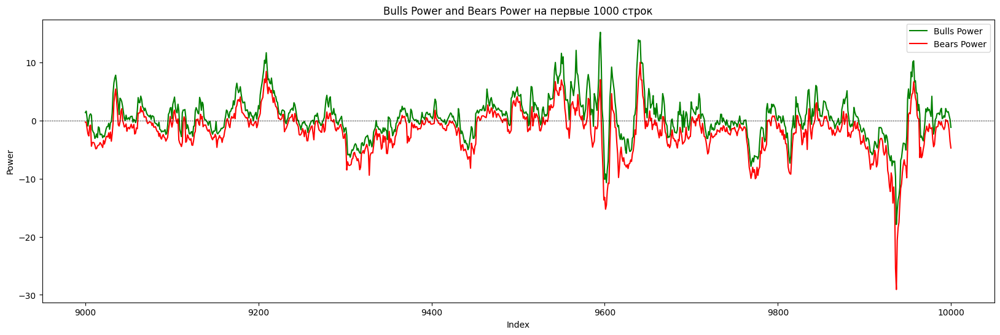

In [ ]:
# Визуализация Bulls Power и Bears Power - bb_power на первые 1000 строк
plt.figure(figsize=(20, 6))
plt.plot(bonk.loc[9000:10000]['bulls_power'], label='Bulls Power', color='green')
plt.plot(bonk.loc[9000:10000]['bears_power'], label='Bears Power', color='red')
plt.axhline(0, color='black', linewidth=0.5, linestyle='--')
plt.title('Bulls Power and Bears Power на первые 1000 строк')
plt.xlabel('Index')
plt.ylabel('Power')
plt.legend()
plt.show()

In [ ]:
# индикатор bb_power сумма последних 24 значений
# показывает накопленную за последние 24 часа силу быков и медведей, по нему идентиф. сильный тренд без перспектив затухания
bonk['bb_power_24_sum'] = bonk['bb_power'].rolling(window=24).sum()

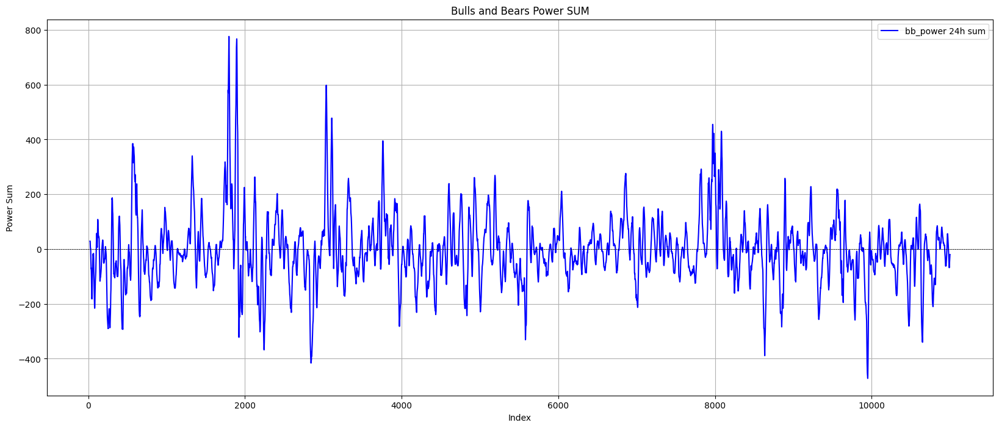

In [ ]:
# Визуализация Bulls Power и Bears Power - bb_power на первые 1000 строк
plt.figure(figsize=(20, 8))
plt.plot(bonk['bb_power_24_sum'], label='bb_power 24h sum', color='blue')
plt.axhline(0, color='black', linewidth=0.5, linestyle='--')
plt.title('Bulls and Bears Power SUM')
plt.xlabel('Index')
plt.ylabel('Power Sum')
plt.legend()
plt.grid(True)
plt.show()

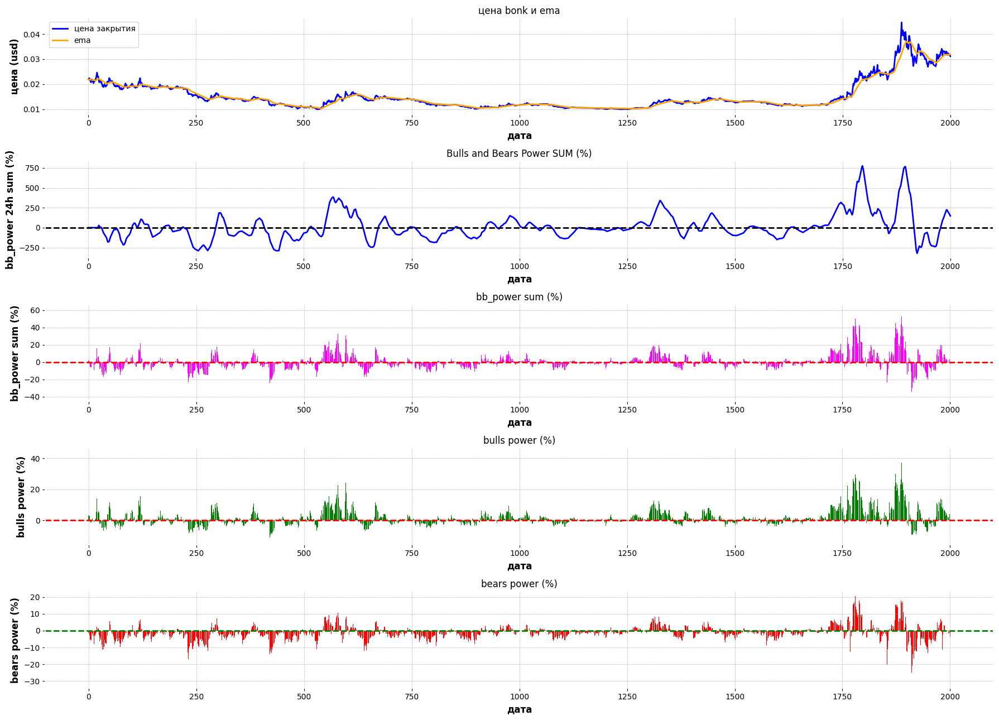

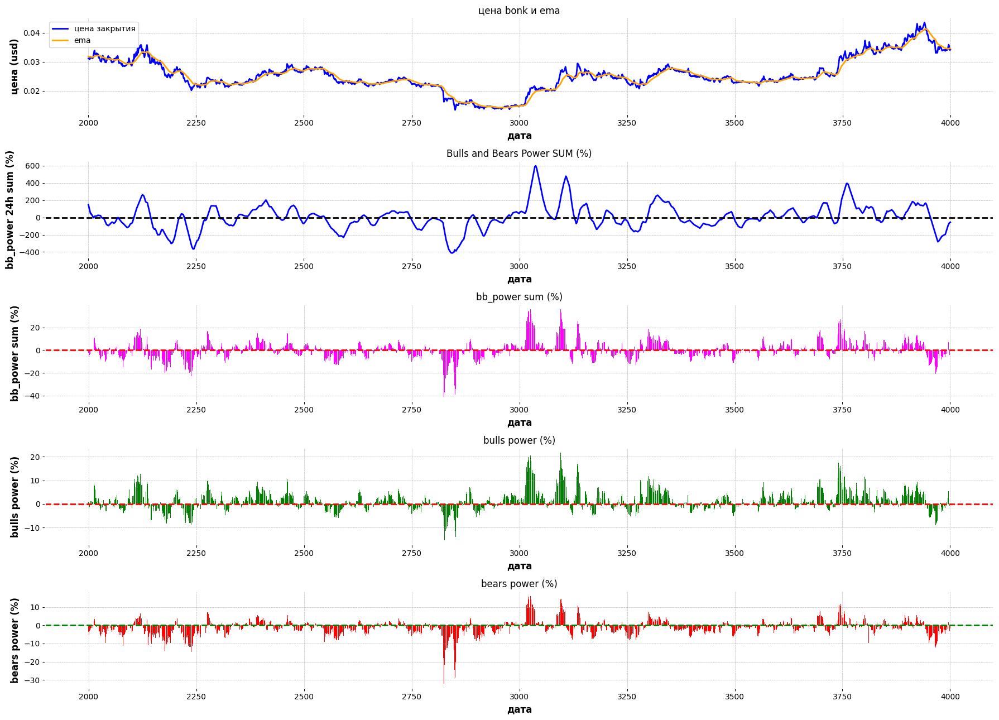

In [32]:
# цикл визуализаций для каждых 2 тыс строк
step = 2000 # кол-во строк на графике
for i in range(0, 2001, step): #bonk.shape[0]

  # визуализация
  plt.figure(figsize=(18, 13))

  # график цен и ema
  plt.subplot(5, 1, 1)
  plt.plot(bonk.loc[i:i+step]['close'], label='цена закрытия', color='blue')
  plt.plot(bonk.loc[i:i+step].index, bonk.loc[i:i+step]['ema'], label='ema', color='orange')
  plt.title('цена bonk и ema')
  plt.xlabel('дата')
  plt.ylabel('цена (usd)')
  plt.legend()

  # график bb_power_24_sum
  plt.subplot(5, 1, 2)
  plt.plot(bonk.loc[i:i+step].index, bonk.loc[i:i+step]['bb_power_24_sum'], color='blue', label='bb_power sum (%)')
  plt.title('Bulls and Bears Power SUM (%)')
  plt.xlabel('дата')
  plt.ylabel('bb_power 24h sum (%)')
  plt.axhline(0, color='black', linestyle='--')

  # график bb_power
  plt.subplot(5, 1, 3)
  plt.bar(bonk.loc[i:i+step].index, bonk.loc[i:i+step]['bb_power'], color='magenta', label='bb_power sum (%)')
  plt.title('bb_power sum (%)')
  plt.xlabel('дата')
  plt.ylabel('bb_power sum (%)')
  plt.axhline(0, color='red', linestyle='--')

  # график bulls power
  plt.subplot(5, 1, 4)
  plt.bar(bonk.loc[i:i+step].index, bonk.loc[i:i+step]['bulls_power'], color='green', label='bulls power (%)')
  plt.title('bulls power (%)')
  plt.xlabel('дата')
  plt.ylabel('bulls power (%)')
  plt.axhline(0, color='red', linestyle='--')

  # график bears power
  plt.subplot(5, 1, 5)
  plt.bar(bonk.loc[i:i+step].index, bonk.loc[i:i+step]['bears_power'], color='red', label='bears power (%)')
  plt.title('bears power (%)')
  plt.xlabel('дата')
  plt.ylabel('bears power (%)')
  plt.axhline(0, color='green', linestyle='--')

  plt.tight_layout()
  plt.show()

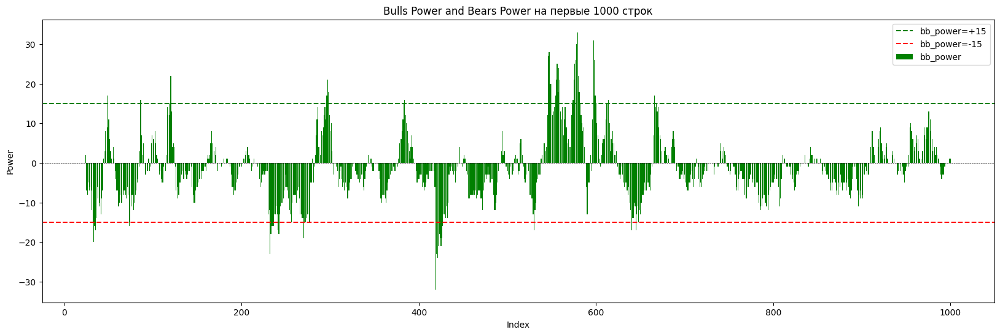

In [ ]:
# Визуализация Bulls Power и Bears Power - bb_power на первые 1000 строк
plt.figure(figsize=(20, 6))
plt.bar(bonk.loc[24:1000].index, bonk.loc[24:1000]['bb_power'], label='bb_power', color='green')
# Добавляем горизонтальную линию на уровне y=3
plt.axhline(15, color='g', linestyle='--', label='bb_power=+15')
plt.axhline(-15, color='r', linestyle='--', label='bb_power=-15')
plt.axhline(0, color='black', linewidth=0.5, linestyle='--')
plt.title('Bulls Power and Bears Power на первые 1000 строк')
plt.xlabel('Index')
plt.ylabel('Power')
plt.legend()
plt.show()

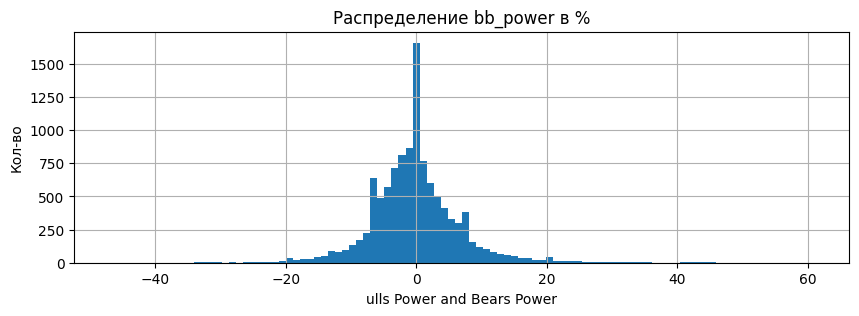

In [ ]:
# bb_power распределение
bonk['bb_power'].hist(bins=100, figsize=(10, 3))
plt.title('Распределение bb_power в %')
plt.xlabel('ulls Power and Bears Power')
plt.ylabel('Кол-во')
plt.show()

In [ ]:
# даты, когда bb_power больше 20
bonk[bonk['bb_power'] > 20]['date_time']

,date_time
20,2023-12-17 21:00:00
120,2023-12-22 01:00:00
297,2023-12-29 10:00:00
546,2024-01-08 19:00:00
547,2024-01-08 20:00:00
...,...
8877,2024-12-20 22:00:00
8878,2024-12-20 23:00:00
9595,2025-01-19 20:00:00
9640,2025-01-21 17:00:00


Text(0, 0.5, 'CCI_24')

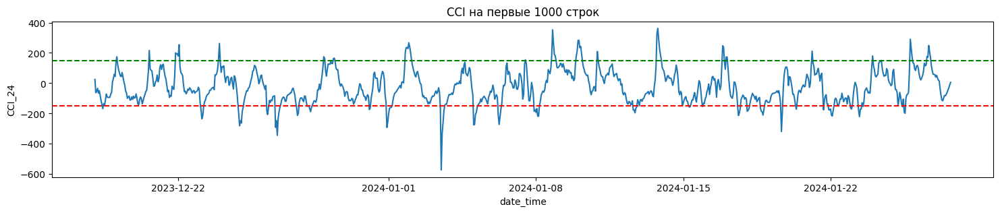

In [ ]:
# CCI_24 на первые 1000 строк
#bonk.loc[24:1000]['CCI_24'].plot(figsize=(18, 3))
plt.figure(figsize=(18, 3))
plt.plot(bonk.loc[24:1000]['date_time'], bonk.loc[24:1000]['CCI_24'])
# Добавляем горизонтальную линию на уровне y=3
plt.axhline(y=150, color='g', linestyle='--', label='CCI=+150')
plt.axhline(y=-150, color='r', linestyle='--', label='CCI=-150')
plt.title('CCI на первые 1000 строк')
plt.xlabel('date_time')
plt.ylabel('CCI_24')

Text(0, 0.5, 'RSI_24')

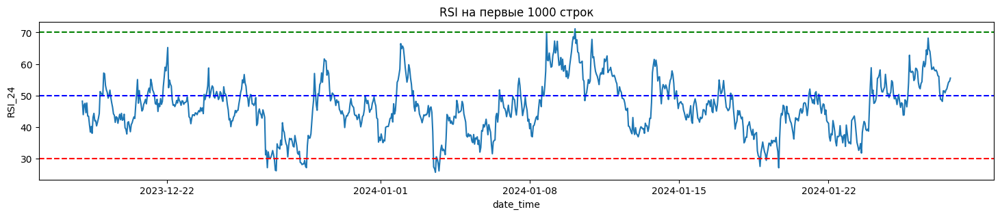

In [ ]:
# RSI_24 на первые 1000 строк
#bonk.loc[24:1000]['RSI_24'].plot(figsize=(18, 3))
plt.figure(figsize=(18, 3))
plt.plot(bonk.loc[24:1000]['date_time'], bonk.loc[24:1000]['RSI_24'])
# Добавляем горизонтальную линию на уровне y=3
plt.axhline(y=70, color='g', linestyle='--', label='RSI=70')
plt.axhline(y=50, color='b', linestyle='--', label='RSI=50')
plt.axhline(y=30, color='r', linestyle='--', label='RSI=30')
plt.title('RSI на первые 1000 строк')
plt.xlabel('date_time')
plt.ylabel('RSI_24')

#### Количество алертов за период (CCI >= 150)

In [ ]:
print(f"Количество алертов за период: {bonk[bonk['CCI_24']>=150].shape[0]}")
print(f"Количество алертов в месяц в среднем: {round(bonk[bonk['CCI_24']>=150].shape[0]/(bonk.shape[0]/24/30), 1)}")

Количество алертов за период: 930
Количество алертов в месяц в среднем: 60.9


### Добавление новых полей для условий выхода и входа  

#### FIBO: цена нулевого уровня для расчета фибо

In [ ]:
# Находим индексы, где RSI <=50 - откуда строить фибо
rsi_cross_50 = bonk.index[bonk['RSI_12'] <= 50].tolist()
rsi_cross_50[:10]

# Добавляем новый столбец для хранения индексов
bonk['ind_rsi_fibo_start'] = None

# Добавляем новый столбец для хранения цен начала рассчета фибо
bonk['fibo_start_price'] = None

# Для каждой строки находим ближайший предыдущий индекс, где rsi  был <= 50
for i in range(len(bonk)):
    # Ищем индексы, которые меньше текущего индекса
    prev_rsi = [idx for idx in rsi_cross_50 if idx < i]

    # Если такие индексы есть, берем последний
    if prev_rsi:
        bonk.at[i, 'ind_rsi_fibo_start'] = prev_rsi[-1]
        # дописываем в поле и текущий индекс цену закрытия бара, где rsi последний раз был меньше 50
        bonk.at[i, 'fibo_start_price'] = max(bonk.at[prev_rsi[-1], 'close'], bonk.at[prev_rsi[-1], 'open'])

bonk[['RSI_12', 'close', 'ind_rsi_fibo_start', 'fibo_start_price']]
# для проверки
# bonk.iloc[72:122][['RSI_24', 'close', 'ind_rsi_fibo_start', 'fibo_start_price']]

,RSI_12,close,ind_rsi_fibo_start,fibo_start_price
0,NaN,0.021885,None,None
1,NaN,0.021770,None,None
2,NaN,0.022389,None,None
3,NaN,0.021813,None,None
4,NaN,0.020963,None,None
...,...,...,...,...
10995,58.281725,0.010879,10988,0.010524
10996,59.523500,0.010909,10988,0.010524
10997,57.350841,0.010874,10988,0.010524
10998,50.060779,0.010746,10988,0.010524


#### Рост цены от цены расчета фибо до цены закрытия свечи алерта (пересечение CCI уровня 150 снизу вверх)

In [ ]:
# признак соблюдения условия входа
# потенциал фибо от нуля и до каждой цены закрытия (понадобятся только для баров входа)
def get_fibo_potencial(row):
  if row['fibo_start_price'] :
    return round(((row['close'] - row['fibo_start_price']) / row['close'])*100, 1)
bonk['fibo_potencial'] = bonk.apply(get_fibo_potencial, axis=1)

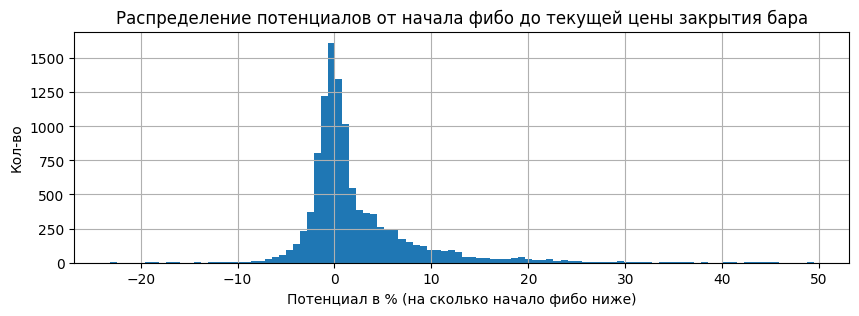

In [ ]:
# потенциал фибо от нуля и до каждой цены закрытия
bonk['fibo_potencial'].hist(bins=100, figsize=(10, 3))
plt.title('Распределение потенциалов от начала фибо до текущей цены закрытия бара')
plt.xlabel('Потенциал в % (на сколько начало фибо ниже)')
plt.ylabel('Кол-во')
plt.show()

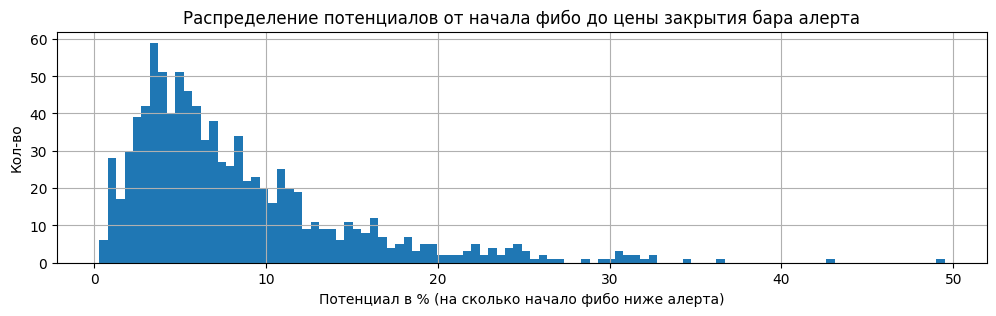

In [ ]:
bonk[bonk['CCI_24']>=150]['fibo_potencial'].hist(bins=100, figsize=(12, 3))
plt.title('Распределение потенциалов от начала фибо до цены закрытия бара алерта')
plt.xlabel('Потенциал в % (на сколько начало фибо ниже алерта)')
plt.ylabel('Кол-во')
plt.show()

#### Заполнение пропусков и сохранение датасета с индикаторами

In [11]:
# замена на нули строки с NAN
bonk = bonk.fillna(0)
# приводим индекс бара начала фибо ind_rsi_fibo_start к integer
bonk['ind_rsi_fibo_start'] = bonk['ind_rsi_fibo_start'].astype(int)

## Тесты стратегии

#### Ищем дивергенцию

In [16]:
# датафрейм для сделок
columns = ['alert_date', 'alert_price', 'open_date', 'open_price', 'close_date', 'close_price', 'close_rule', 'mpu', 'mpp', 'fibo_potencial', 'fibo_entry_potencial']

# Создание пустого DataFrame
trades = pd.DataFrame(columns=columns)
trades

,alert_date,alert_price,open_date,open_price,close_date,close_price,close_rule,mpu,mpp,fibo_potencial,fibo_entry_potencial


























Время и цена алерта: 2023-12-21 21:00:00 0.020197
Фибо достигнуто.


<ipython-input-17-b006f19705b6>:216: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  trades = pd.concat([trades, pd.DataFrame([new_trade])], ignore_index=True)


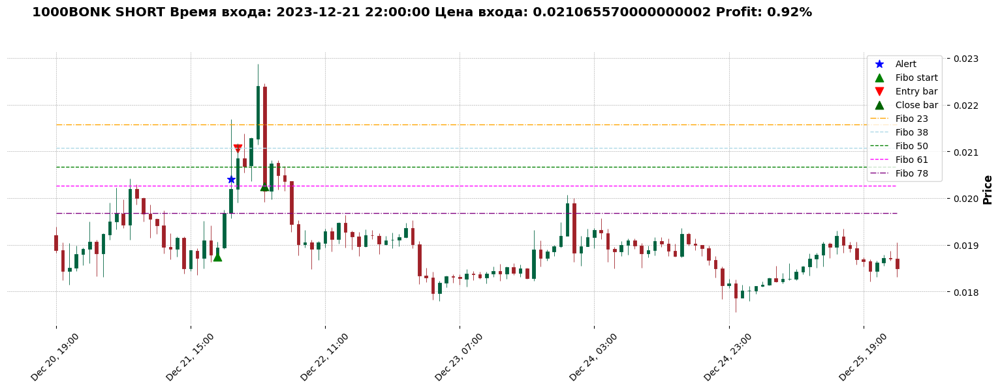

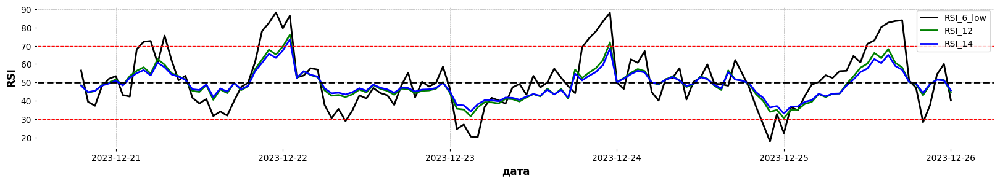

Алерт 2023-12-21 21:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 166 в 2023-12-23 23:00:00 с ценой закр 0.019892 нет дивергенции и обновления максимумов






















































Время и цена алерта: 2023-12-28 22:00:00 0.015425
Фибо достигнуто.


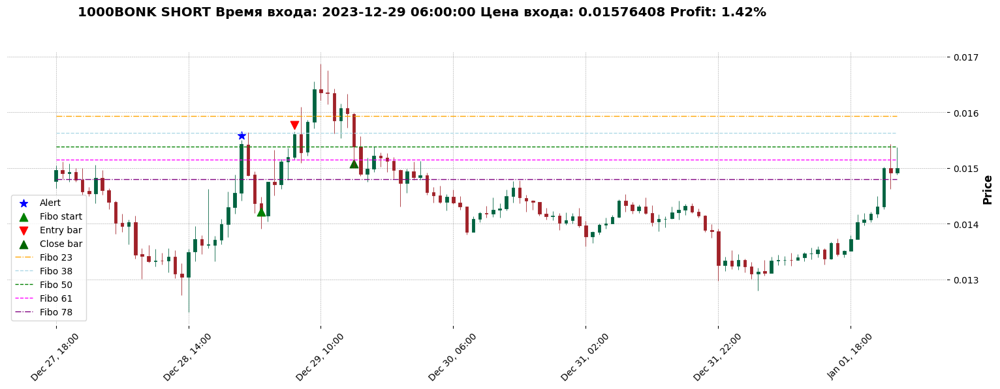

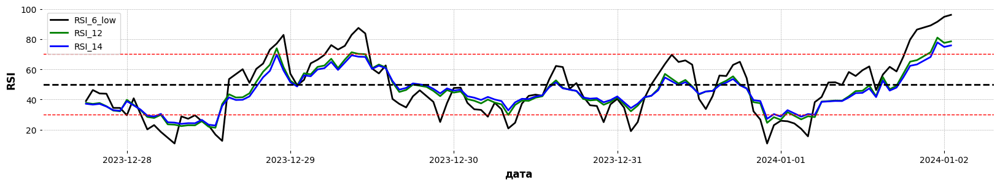

Алерт 2023-12-28 22:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 379 в 2024-01-01 20:00:00 с ценой закр 0.01407 нет дивергенции и обновления максимумов
На баре 380 в 2024-01-01 21:00:00 с ценой закр 0.01418 нет дивергенции и обновления максимумов
На баре 381 в 2024-01-01 22:00:00 с ценой закр 0.014308 нет дивергенции и обновления максимумов
На баре 382 в 2024-01-01 23:00:00 с ценой закр 0.015002 нет дивергенции и обновления максимумов




















На баре 380 в 2024-01-01 21:00:00 с ценой закр 0.01418 нет дивергенции и обновления максимумов
Время и цена алерта: 2024-01-01 20:00:00 0.01407
Фибо достигнуто.


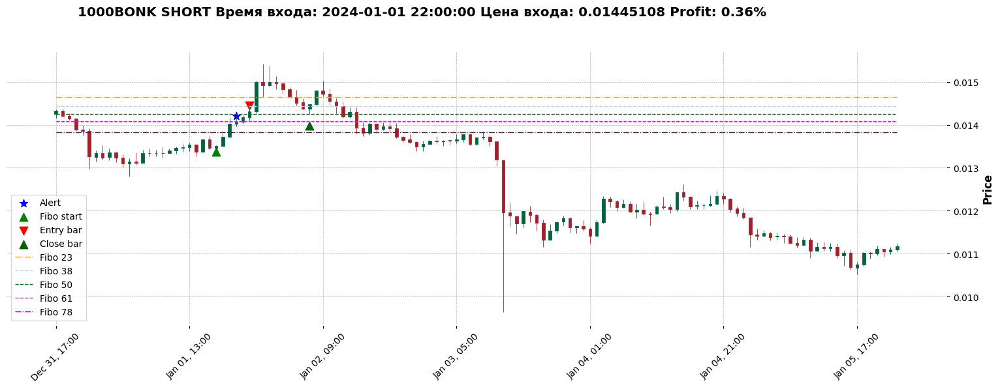

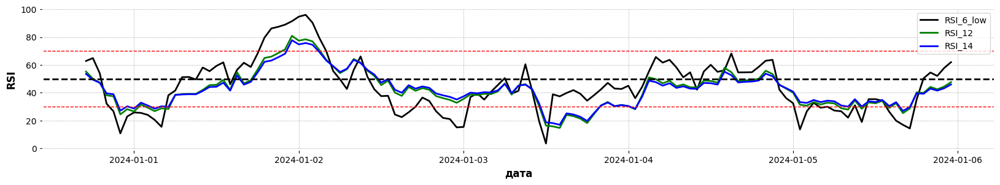

Алерт 2024-01-01 20:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























На баре 546 в 2024-01-08 19:00:00 с ценой закр 0.012757 нет дивергенции и обновления максимумов








Время и цена алерта: 2024-01-08 18:00:00 0.011175
Пересечение RSI 12


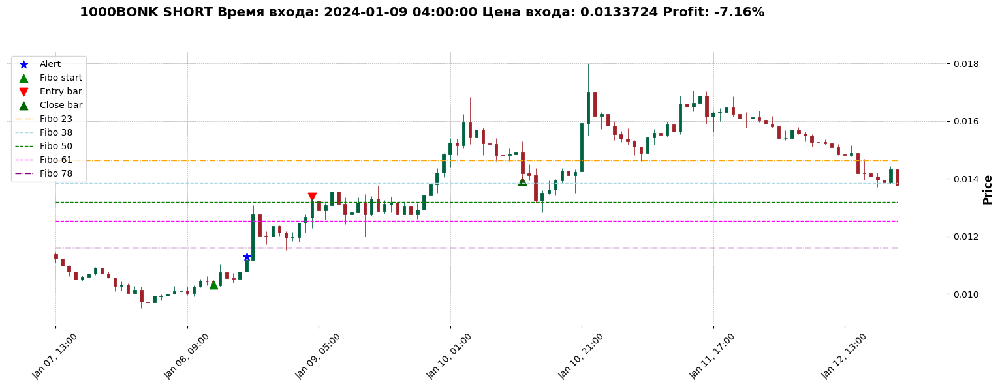

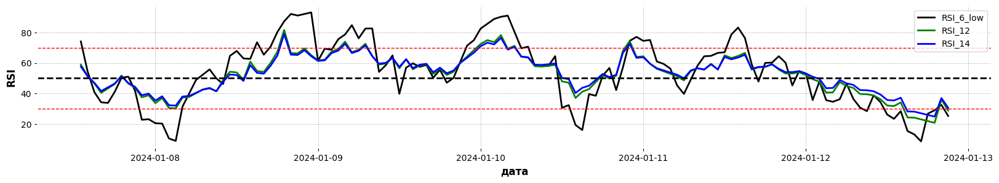

Алерт 2024-01-08 18:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























На баре 666 в 2024-01-13 19:00:00 с ценой закр 0.015127 нет дивергенции и обновления максимумов
Время и цена алерта: 2024-01-13 18:00:00 0.01486
Фибо достигнуто.


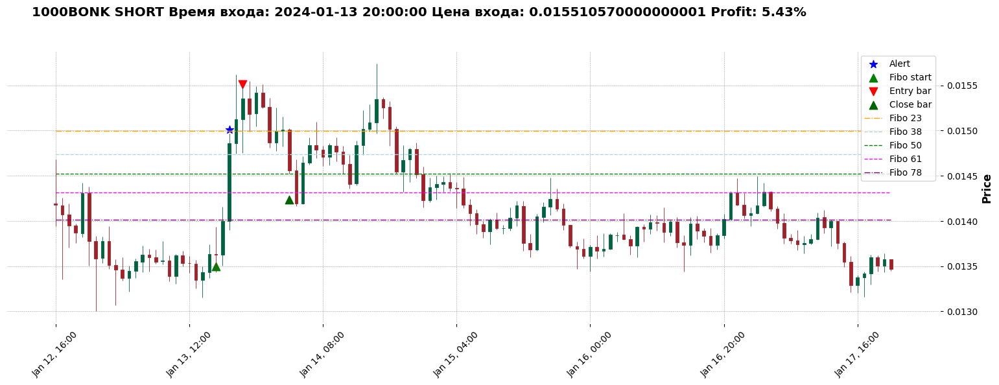

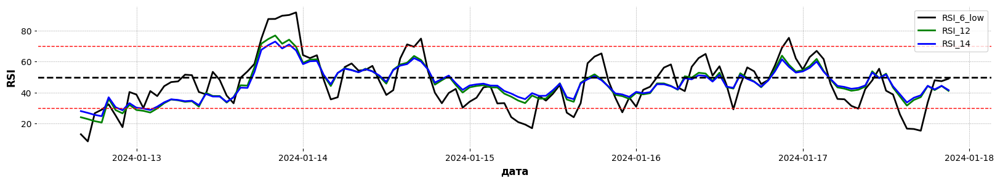

Алерт 2024-01-13 18:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!




Недостаточный потенциал отката: 3.4%



















На баре 745 в 2024-01-17 02:00:00 с ценой закр 0.014322 нет дивергенции и обновления максимумов
















































































Недостаточный потенциал отката: 3.8%





















































Время и цена алерта: 2024-01-25 19:00:00 0.011556
Фибо достигнуто.


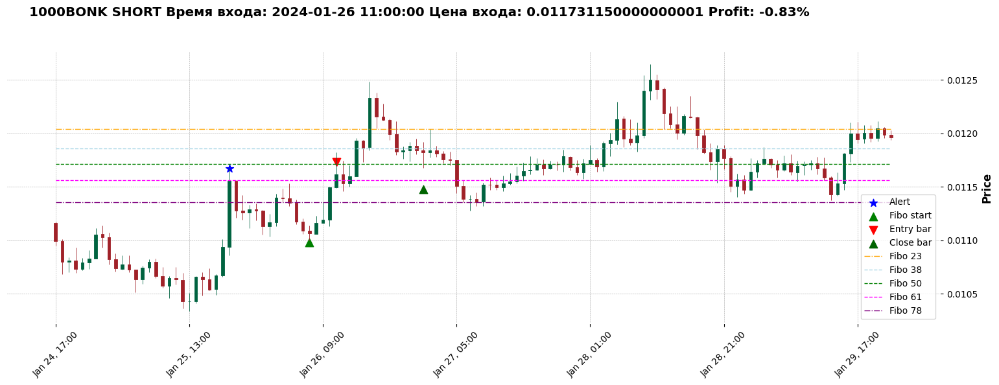

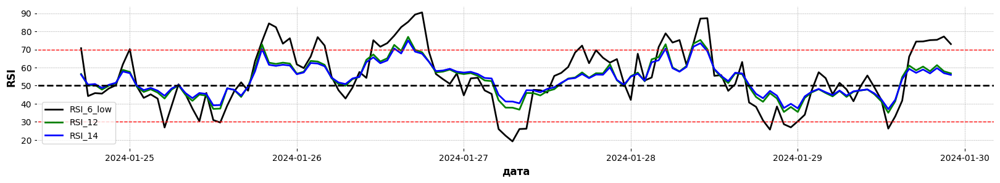

Алерт 2024-01-25 19:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 1012 в 2024-01-28 05:00:00 с ценой закр 0.012132 нет дивергенции и обновления максимумов



На баре 1016 в 2024-01-28 09:00:00 с ценой закр 0.012398 нет дивергенции и обновления максимумов
На баре 1017 в 2024-01-28 10:00:00 с ценой закр 0.012497 нет дивергенции и обновления максимумов





















Время и цена алерта: 2024-01-28 05:00:00 0.012132
Фибо достигнуто.


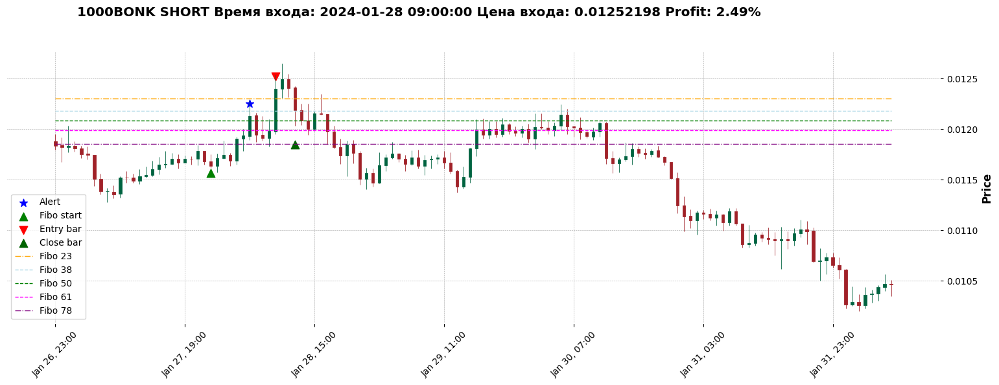

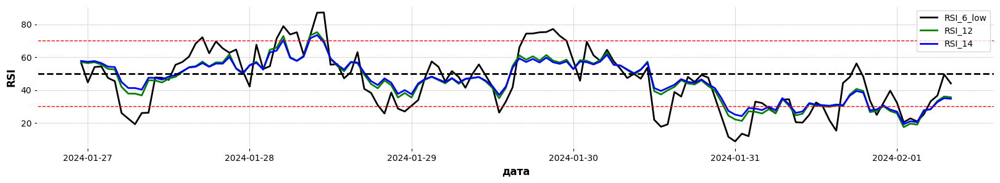

Алерт 2024-01-28 05:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!

На баре 1049 в 2024-01-29 18:00:00 с ценой закр 0.012003 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-01-29 16:00:00 0.011997
Пересечение RSI 12


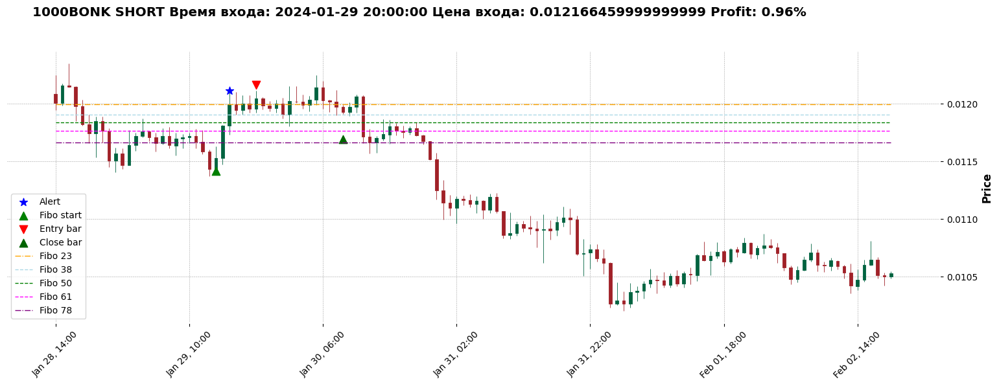

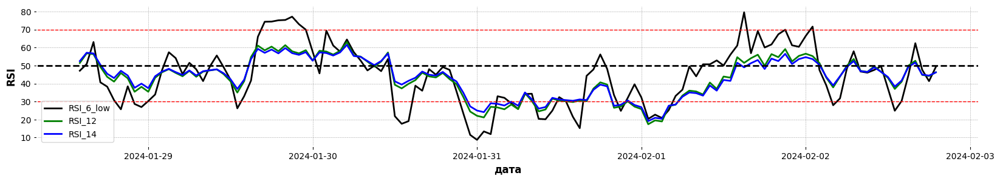

Алерт 2024-01-29 16:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


























Недостаточный потенциал отката: 1.4%
На баре 1263 в 2024-02-07 16:00:00 с ценой закр 0.01031 нет дивергенции и обновления максимумов

Недостаточный потенциал отката: 3.2%

Недостаточный потенциал отката: 3.9%
Время и цена алерта: 2024-02-07 12:00:00 0.010143
Пересечение RSI 12


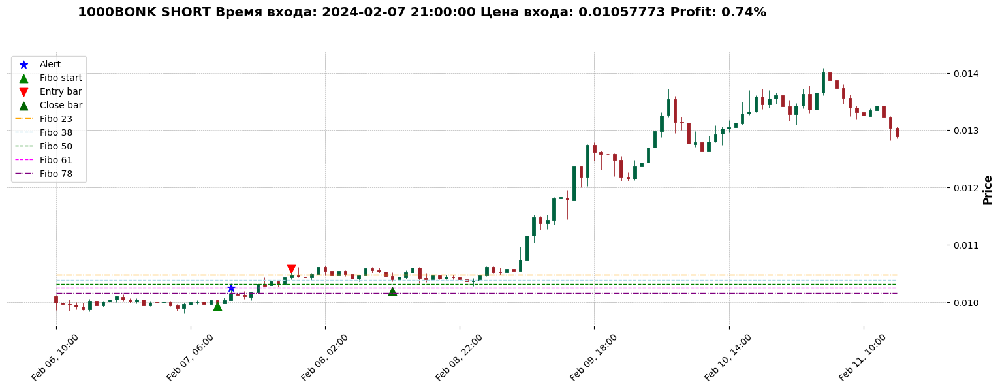

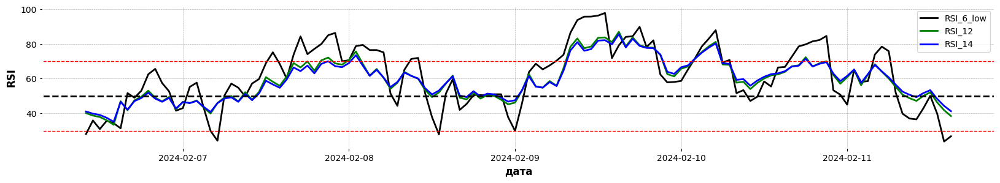

Алерт 2024-02-07 12:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 1303 в 2024-02-09 08:00:00 с ценой закр 0.011163 нет дивергенции и обновления максимумов
На баре 1304 в 2024-02-09 09:00:00 с ценой закр 0.011471 нет дивергенции и обновления максимумов


Время и цена алерта: 2024-02-09 07:00:00 0.01073
Пересечение RSI 12


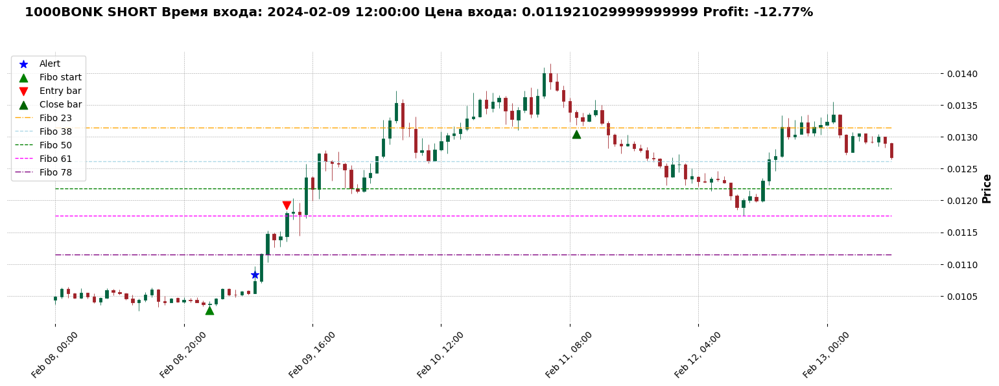

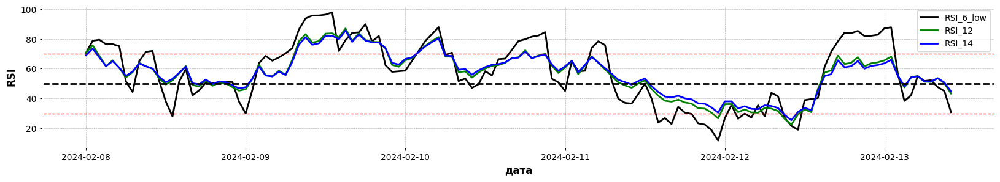

Алерт 2024-02-09 07:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


Время и цена алерта: 2024-02-12 17:00:00 0.013151
Фибо достигнуто.


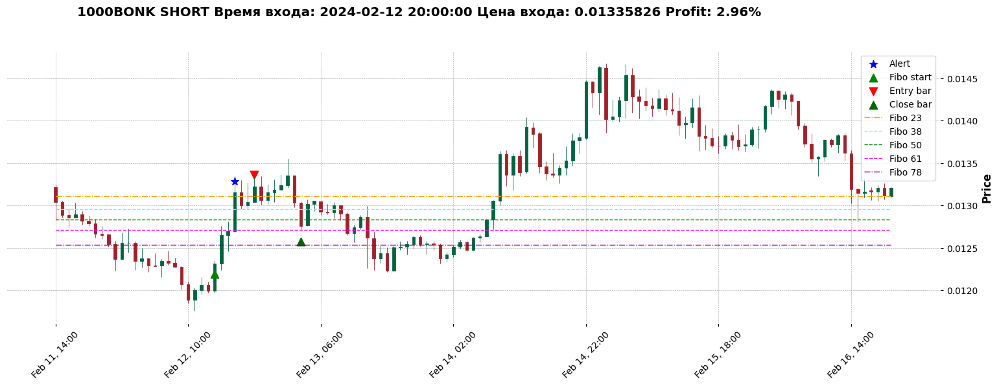

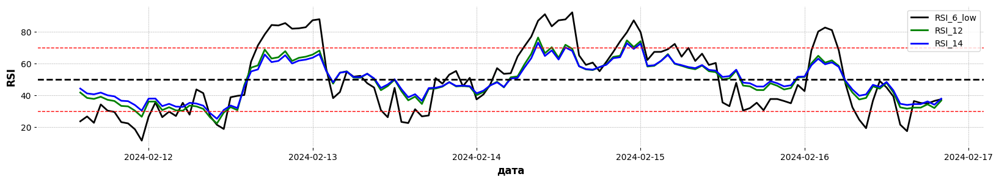

Алерт 2024-02-12 17:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 1424 в 2024-02-14 09:00:00 с ценой закр 0.013607 нет дивергенции и обновления максимумов



На баре 1428 в 2024-02-14 13:00:00 с ценой закр 0.013921 нет дивергенции и обновления максимумов








Время и цена алерта: 2024-02-14 08:00:00 0.013057
Пересечение RSI 12


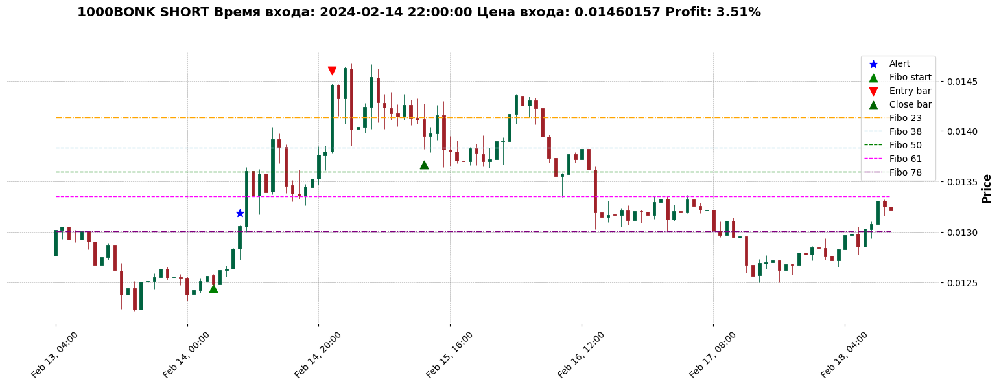

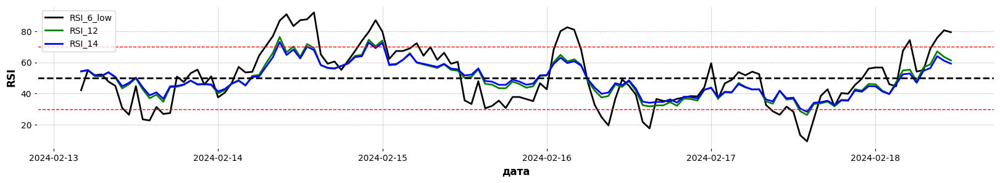

Алерт 2024-02-14 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!





















Недостаточный потенциал отката: 2.2%


























На баре 1616 в 2024-02-22 09:00:00 с ценой закр 0.012133 нет дивергенции и обновления максимумов







































































Недостаточный потенциал отката: 4.0%








Время и цена алерта: 2024-02-25 20:00:00 0.011921
Фибо достигнуто.


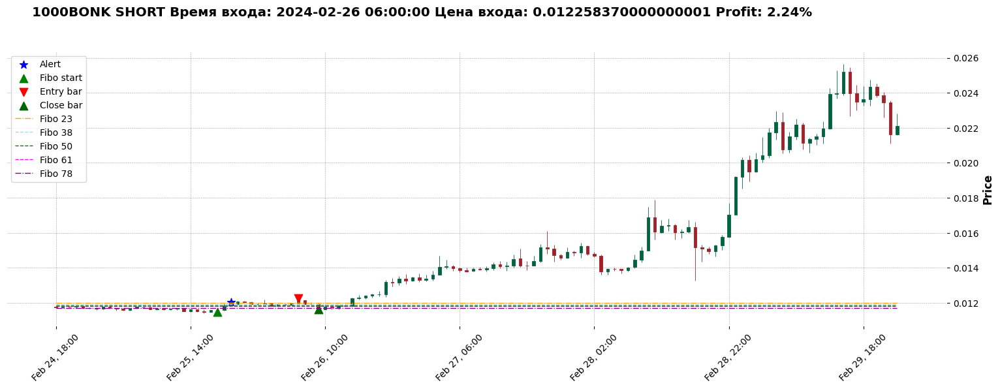

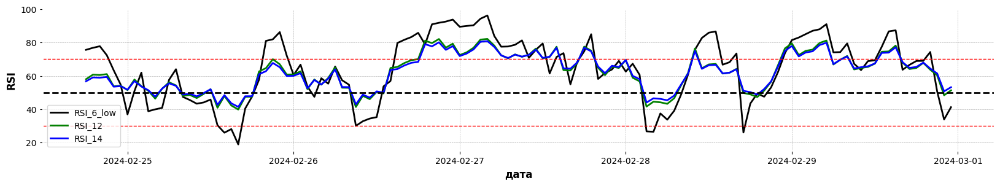

Алерт 2024-02-25 20:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 1719 в 2024-02-26 16:00:00 с ценой закр 0.012401 нет дивергенции и обновления максимумов
На баре 1720 в 2024-02-26 17:00:00 с ценой закр 0.012474 нет дивергенции и обновления максимумов
На баре 1721 в 2024-02-26 18:00:00 с ценой закр 0.0125 нет дивергенции и обновления максимумов
На баре 1722 в 2024-02-26 19:00:00 с ценой закр 0.013189 нет дивергенции и обновления максимумов

На баре 1724 в 2024-02-26 21:00:00 с ценой закр 0.013376 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-02-26 15:00:00 0.012306
Пересечение RSI 12


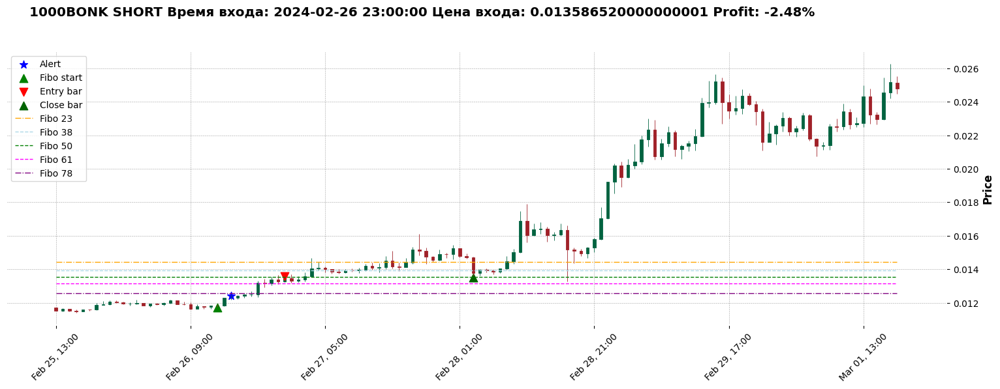

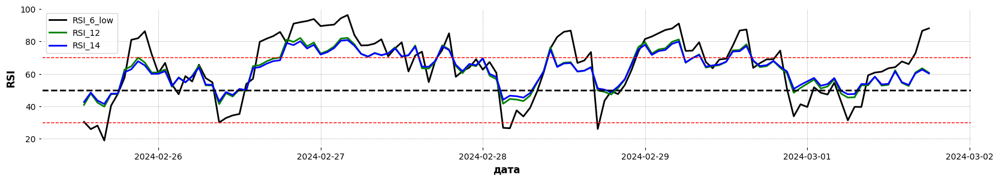

Алерт 2024-02-26 15:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!











Время и цена алерта: 2024-02-28 10:00:00 0.01687
Фибо достигнуто.


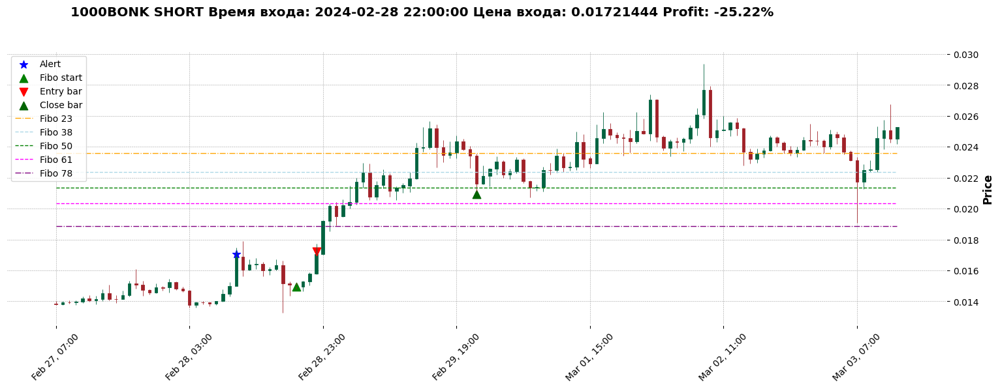

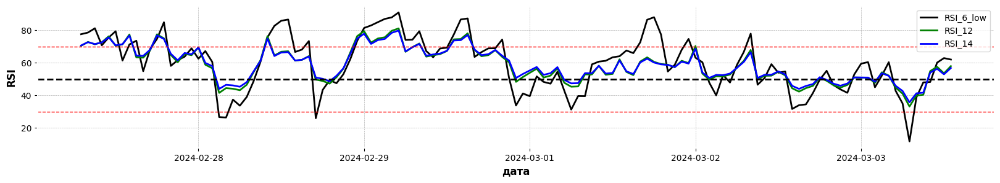

Алерт 2024-02-28 10:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!






Время и цена алерта: 2024-03-01 17:00:00 0.025159
Фибо достигнуто.


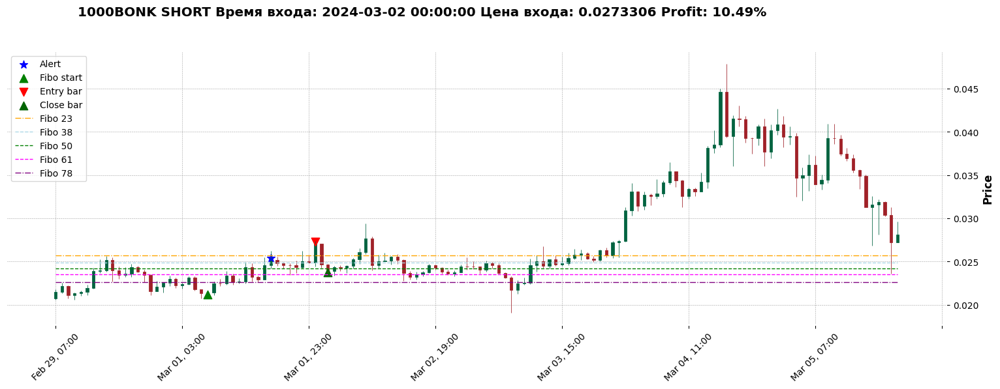

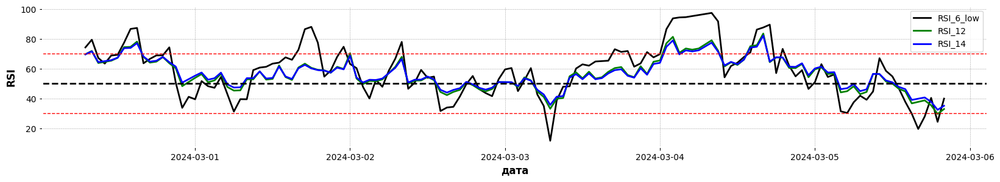

Алерт 2024-03-01 17:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























Время и цена алерта: 2024-03-03 17:00:00 0.025816
Фибо достигнуто.


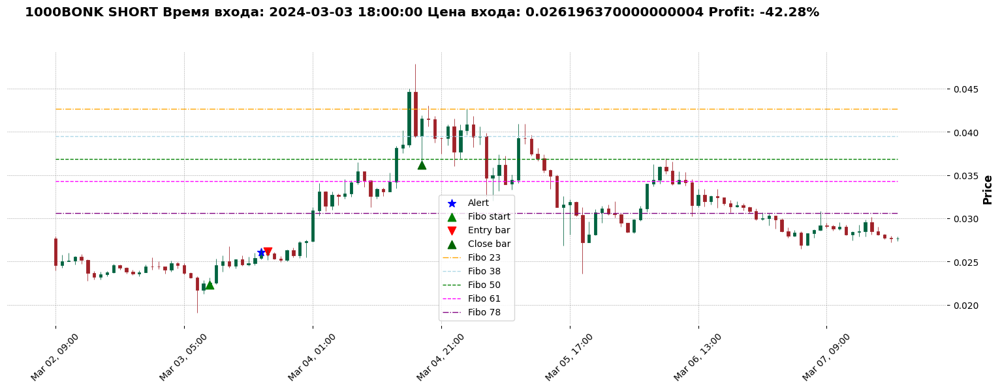

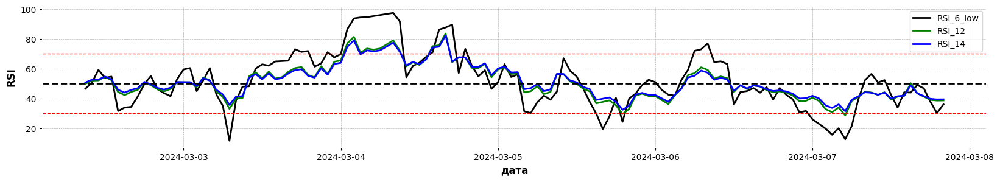

Алерт 2024-03-03 17:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!







Время и цена алерта: 2024-03-08 02:00:00 0.031936
Фибо достигнуто.


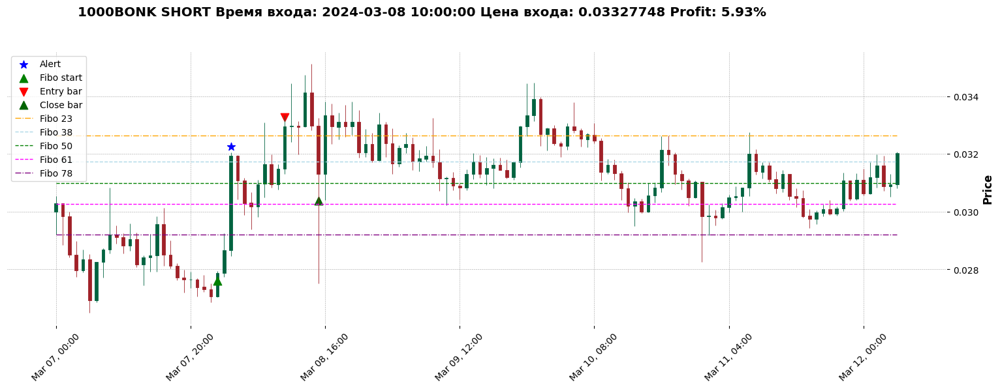

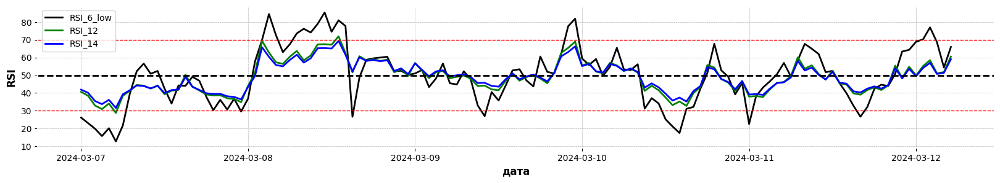

Алерт 2024-03-08 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 2014 в 2024-03-09 23:00:00 с ценой закр 0.033906 нет дивергенции и обновления максимумов


























































На баре 2106 в 2024-03-13 19:00:00 с ценой закр 0.032528 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-03-13 07:00:00 0.031229
Пересечение RSI 12


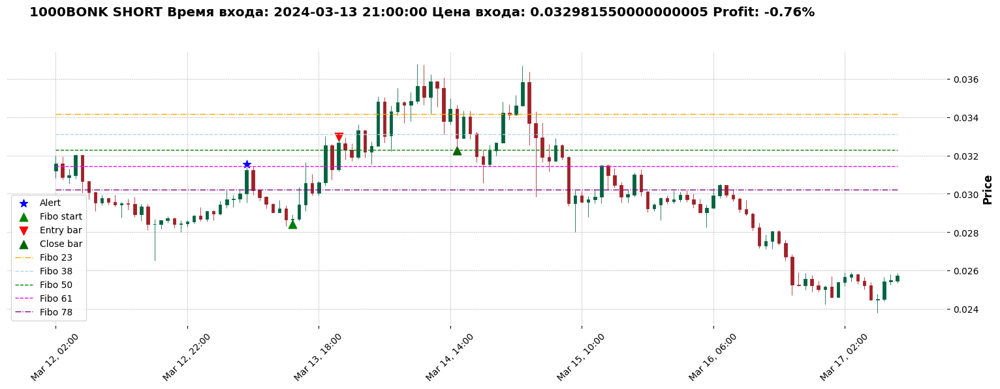

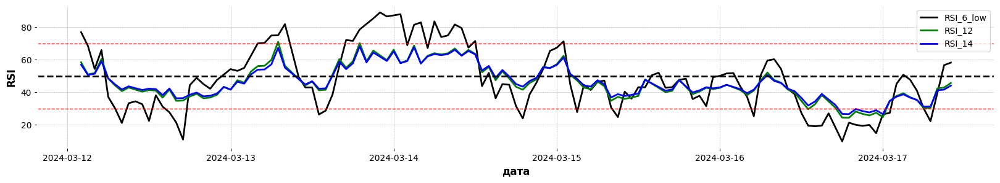

Алерт 2024-03-13 07:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!



Время и цена алерта: 2024-03-17 17:00:00 0.027439
Фибо достигнуто.


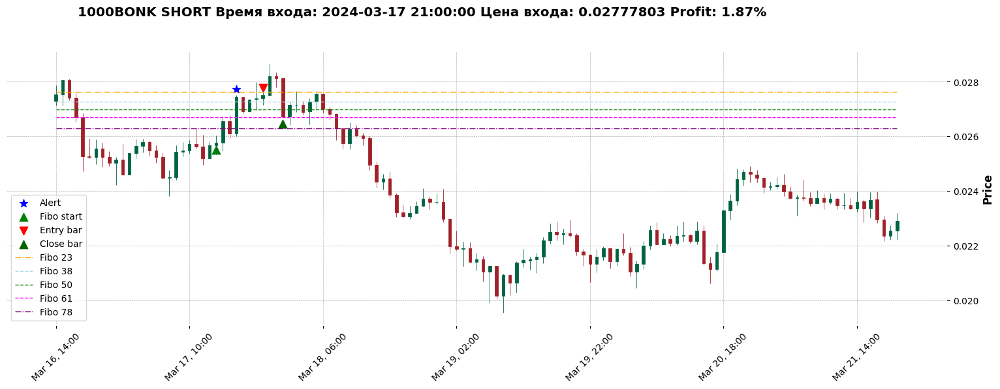

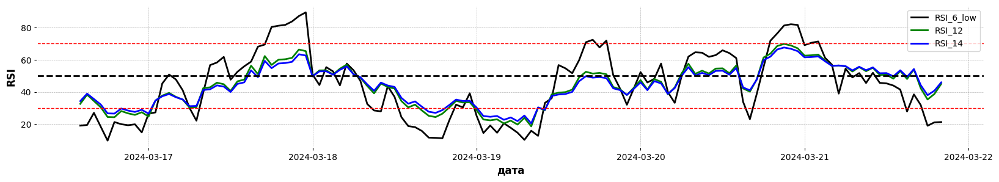

Алерт 2024-03-17 17:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 2275 в 2024-03-20 20:00:00 с ценой закр 0.024442 нет дивергенции и обновления максимумов
На баре 2276 в 2024-03-20 21:00:00 с ценой закр 0.024684 нет дивергенции и обновления максимумов






















Время и цена алерта: 2024-03-20 20:00:00 0.024442
Фибо достигнуто.


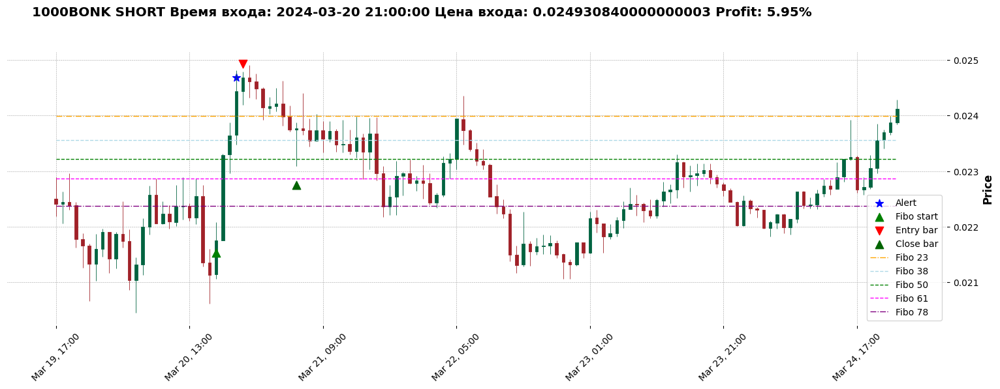

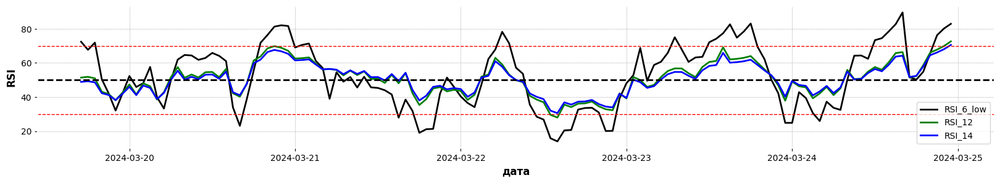

Алерт 2024-03-20 20:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!



























Время и цена алерта: 2024-03-24 16:00:00 0.02325
Фибо достигнуто.


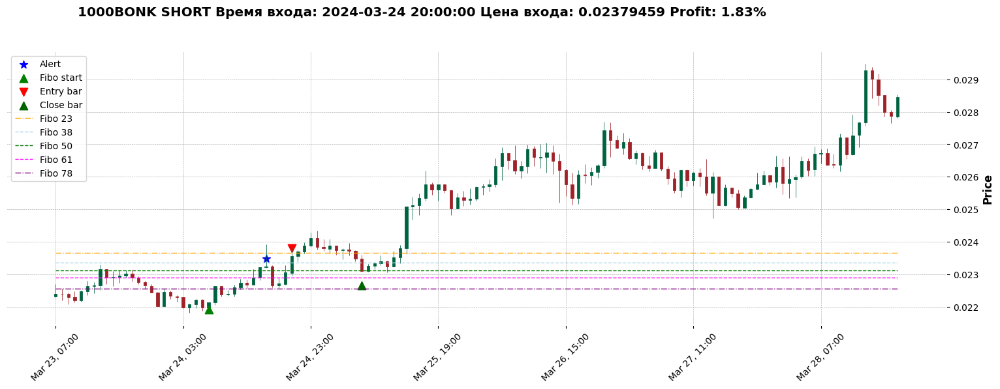

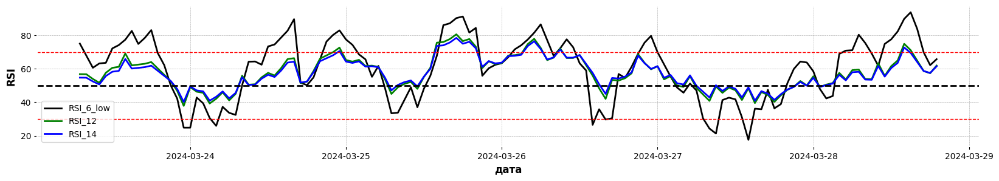

Алерт 2024-03-24 16:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 2390 в 2024-03-25 15:00:00 с ценой закр 0.025124 нет дивергенции и обновления максимумов
На баре 2391 в 2024-03-25 16:00:00 с ценой закр 0.025349 нет дивергенции и обновления максимумов
На баре 2392 в 2024-03-25 17:00:00 с ценой закр 0.025759 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-03-25 14:00:00 0.025078
Пересечение RSI 12


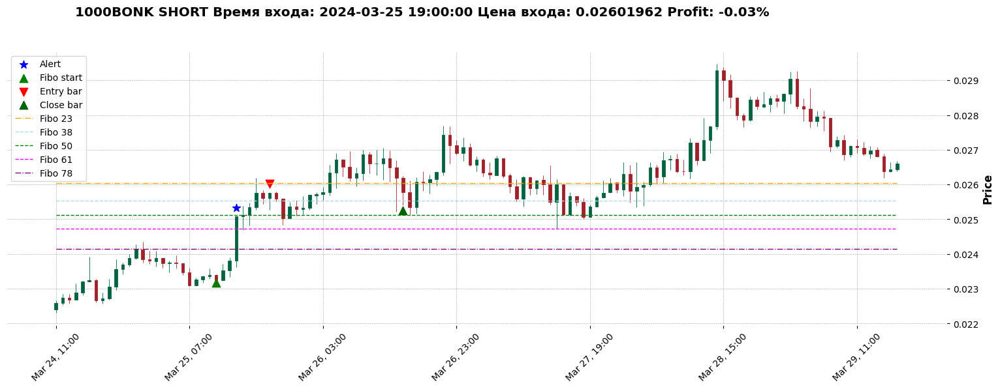

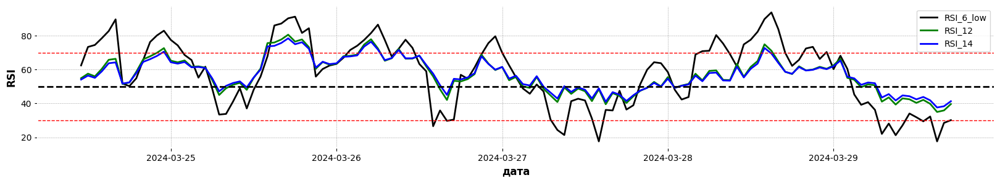

Алерт 2024-03-25 14:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























На баре 2454 в 2024-03-28 07:00:00 с ценой закр 0.026734 нет дивергенции и обновления максимумов


Недостаточный потенциал отката: 3.3%

Недостаточный потенциал отката: 3.6%
Время и цена алерта: 2024-03-28 06:00:00 0.026705
Фибо достигнуто.


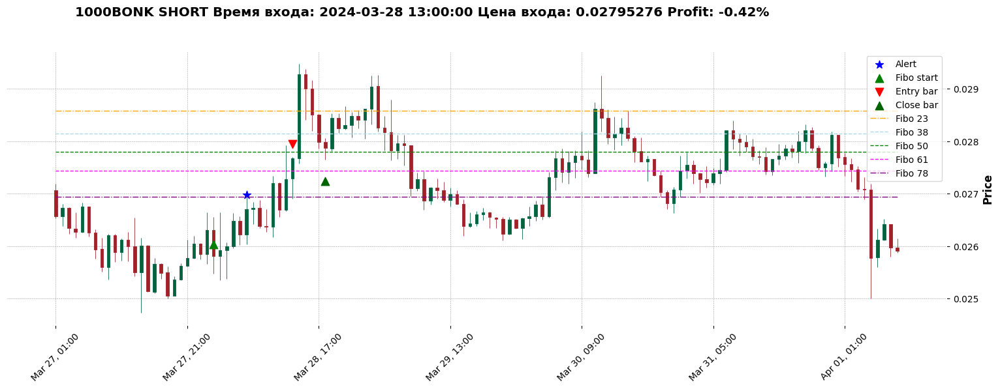

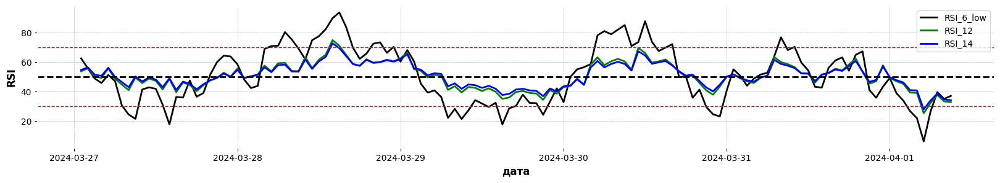

Алерт 2024-03-28 06:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


На баре 2506 в 2024-03-30 11:00:00 с ценой закр 0.028619 нет дивергенции и обновления максимумов





































































На баре 2627 в 2024-04-04 12:00:00 с ценой закр 0.023654 нет дивергенции и обновления максимумов
На баре 2628 в 2024-04-04 13:00:00 с ценой закр 0.024065 нет дивергенции и обновления максимумов






















На баре 2628 в 2024-04-04 13:00:00 с ценой закр 0.024065 нет дивергенции и обновления максимумов















































На баре 2669 в 2024-04-06 06:00:00 с ценой закр 0.022646 нет дивергенции и обновления максимумов

На баре 2671 в 2024-04-06 08:00:00 с ценой закр 0.022849 нет дивергенции и обновления максимумов















Недостаточный потенциал отката: 1.5%
На баре 2688 в 2024-04-07 01:00:00 с ценой закр 0.023373 нет дивергенции и обновления максимумов





На баре 2671 в 2024-04-06 08:00:00 с ценой закр 0.022849 нет ди

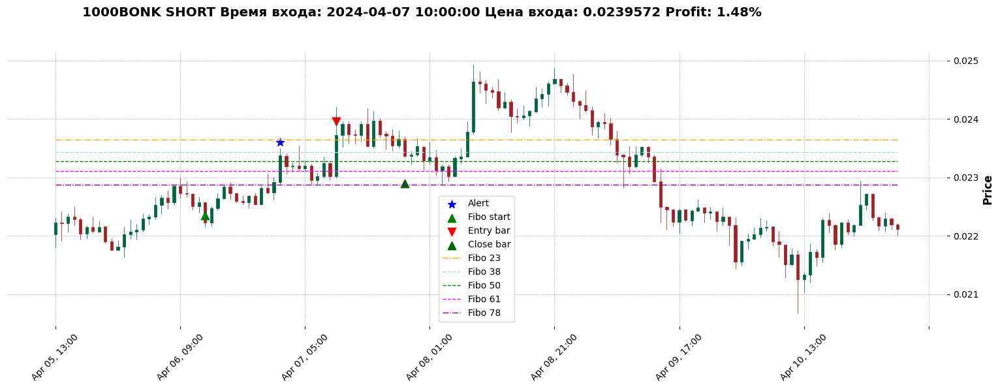

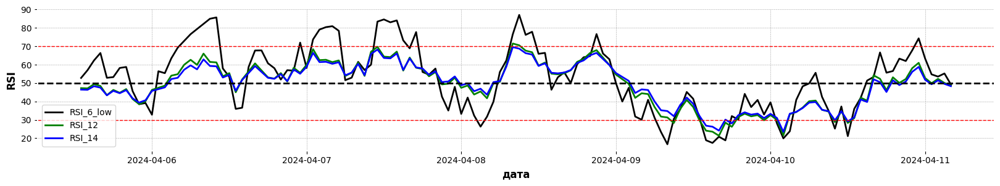

Алерт 2024-04-07 01:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!












Время и цена алерта: 2024-04-08 08:00:00 0.024644
Фибо достигнуто.


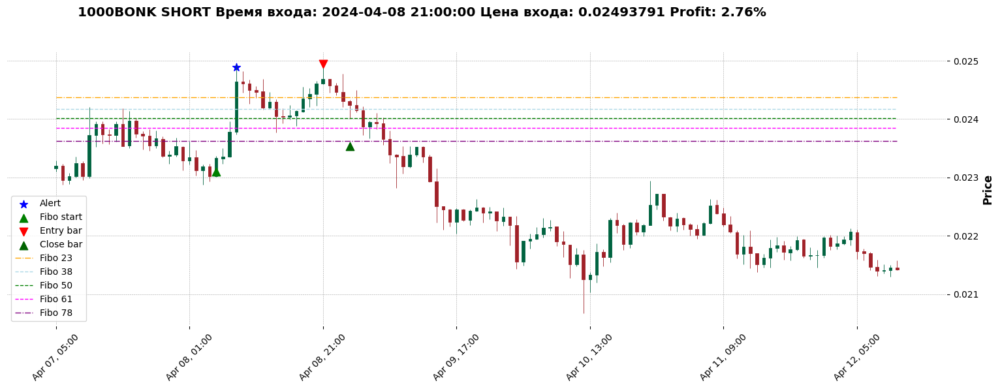

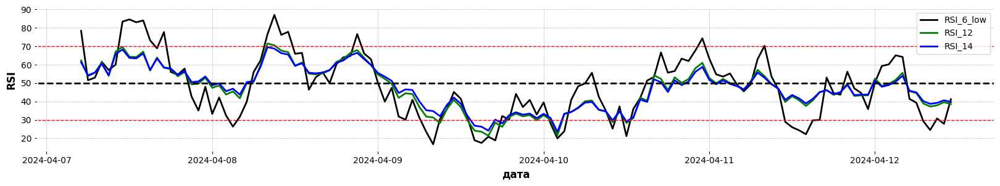

Алерт 2024-04-08 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 2782 в 2024-04-10 23:00:00 с ценой закр 0.022714 нет дивергенции и обновления максимумов











































































Время и цена алерта: 2024-04-18 14:00:00 0.01463
Фибо достигнуто.


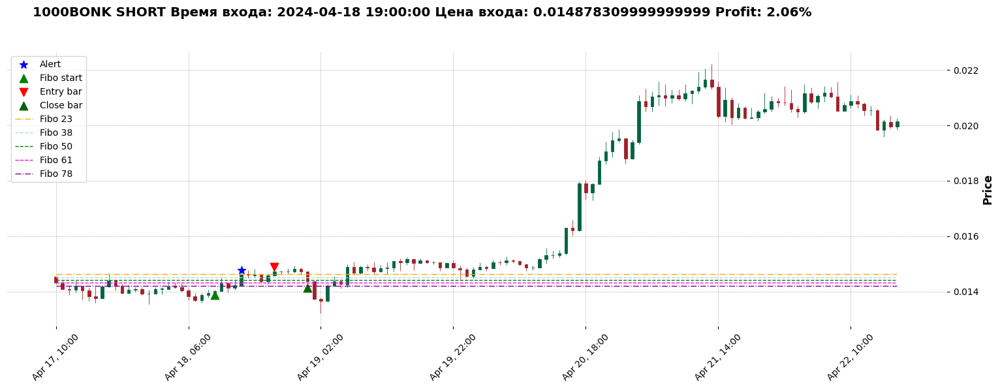

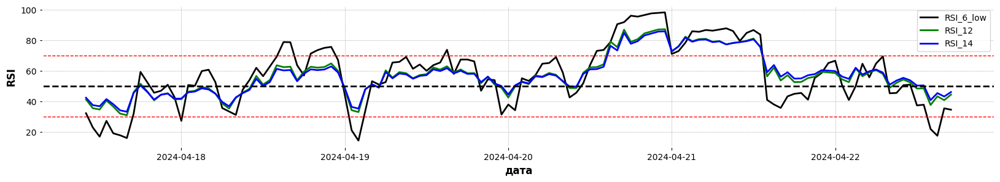

Алерт 2024-04-18 14:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
Недостаточный потенциал отката: 2.9%
Недостаточный потенциал отката: 3.4%
На баре 3014 в 2024-04-20 15:00:00 с ценой закр 0.016294 нет дивергенции и обновления максимумов

На баре 3016 в 2024-04-20 17:00:00 с ценой закр 0.017914 нет дивергенции и обновления максимумов


На баре 3019 в 2024-04-20 20:00:00 с ценой закр 0.018732 нет дивергенции и обновления максимумов
На баре 3020 в 2024-04-20 21:00:00 с ценой закр 0.01905 нет дивергенции и обновления максимумов
Время и цена алерта: 2024-04-20 12:00:00 0.015304
Пересечение RSI 12


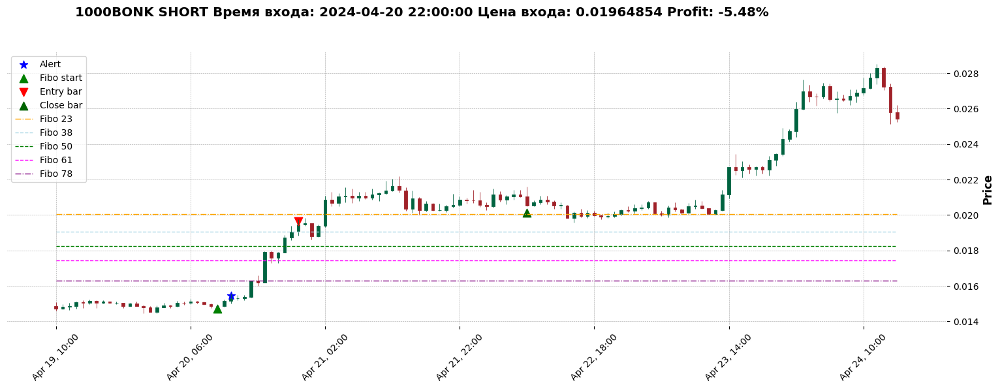

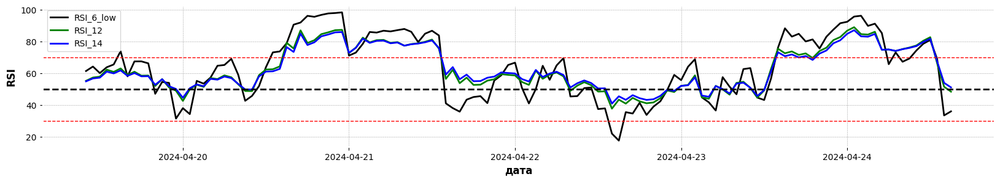

Алерт 2024-04-20 12:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3085 в 2024-04-23 14:00:00 с ценой закр 0.022688 нет дивергенции и обновления максимумов

На баре 3087 в 2024-04-23 16:00:00 с ценой закр 0.022701 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-04-23 13:00:00 0.021152
Пересечение RSI 12


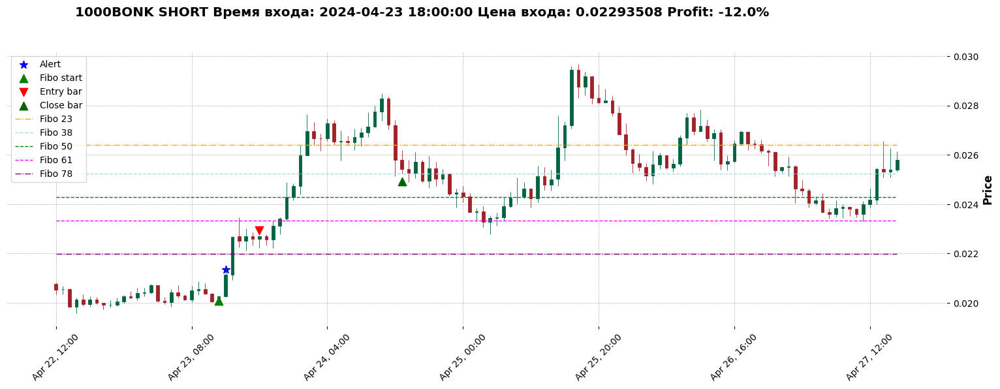

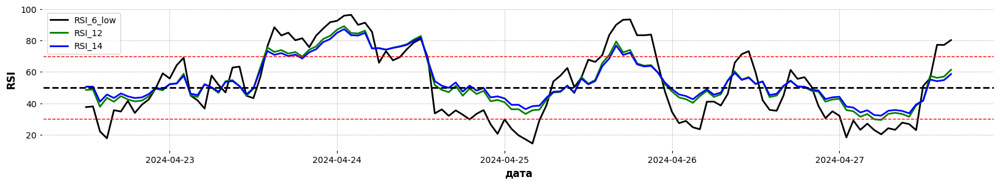

Алерт 2024-04-23 13:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3134 в 2024-04-25 15:00:00 с ценой закр 0.027204 нет дивергенции и обновления максимумов
На баре 3135 в 2024-04-25 16:00:00 с ценой закр 0.029441 нет дивергенции и обновления максимумов






















На баре 3135 в 2024-04-25 16:00:00 с ценой закр 0.029441 нет дивергенции и обновления максимумов







































































На баре 3238 в 2024-04-29 23:00:00 с ценой закр 0.025472 нет дивергенции и обновления максимумов
На баре 3239 в 2024-04-30 00:00:00 с ценой закр 0.025713 нет дивергенции и обновления максимумов






















Время и цена алерта: 2024-04-29 23:00:00 0.025472
Фибо достигнуто.


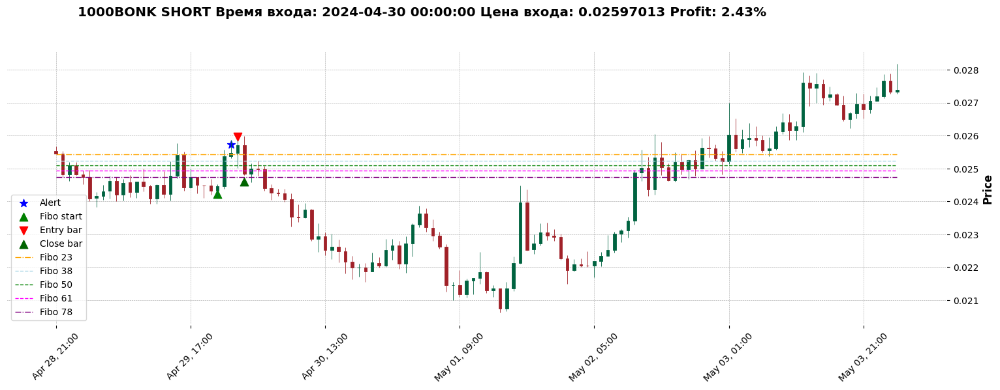

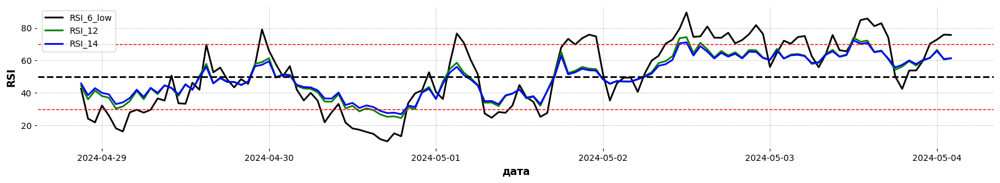

Алерт 2024-04-29 23:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3299 в 2024-05-02 12:00:00 с ценой закр 0.025008 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-05-02 11:00:00 0.024882
Пересечение RSI 12


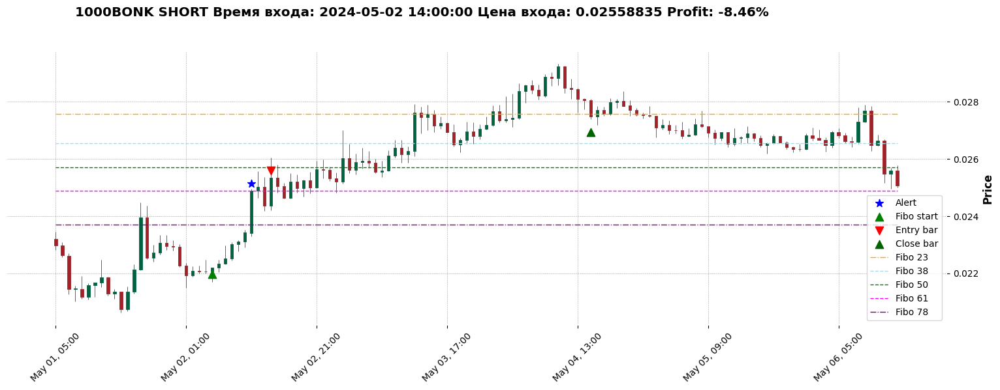

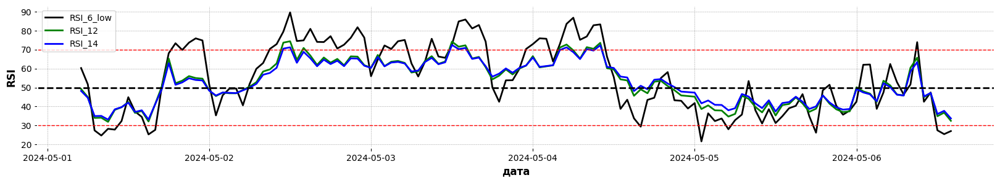

Алерт 2024-05-02 11:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3392 в 2024-05-06 09:00:00 с ценой закр 0.027687 нет дивергенции и обновления максимумов









































































На баре 3567 в 2024-05-13 16:00:00 с ценой закр 0.025036 нет дивергенции и обновления максимумов





















На баре 3567 в 2024-05-13 16:00:00 с ценой закр 0.025036 нет дивергенции и обновления максимумов




















































Время и цена алерта: 2024-05-15 07:00:00 0.024358
Фибо достигнуто.


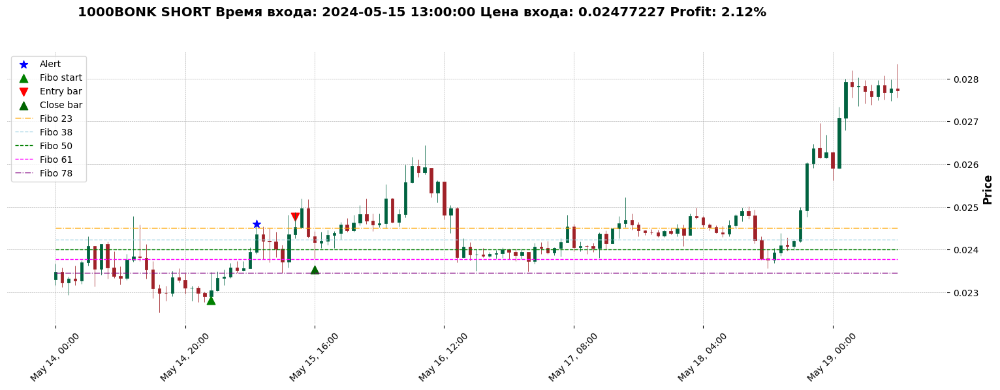

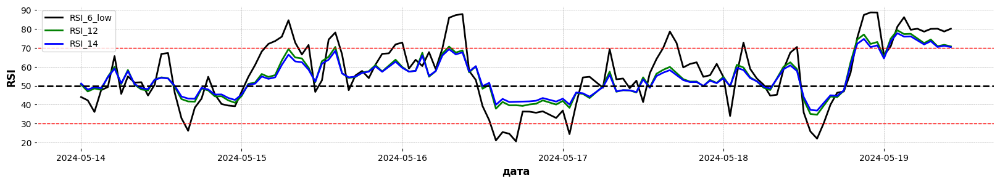

Алерт 2024-05-15 07:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


На баре 3629 в 2024-05-16 06:00:00 с ценой закр 0.025575 нет дивергенции и обновления максимумов
На баре 3630 в 2024-05-16 07:00:00 с ценой закр 0.025955 нет дивергенции и обновления максимумов




















На баре 3630 в 2024-05-16 07:00:00 с ценой закр 0.025955 нет дивергенции и обновления максимумов







































































На баре 3662 в 2024-05-17 15:00:00 с ценой закр 0.024614 нет дивергенции и обновления максимумов
На баре 3663 в 2024-05-17 16:00:00 с ценой закр 0.024698 нет дивергенции и обновления максимумов









Недостаточный потенциал отката: 1.2%






Недостаточный потенциал отката: 1.6%
Недостаточный потенциал отката: 2.0%




На баре 3663 в 2024-05-17 16:00:00 с ценой закр 0.024698 нет дивергенции и обновления максимумов









Недостаточный потенциал отката: 1.2%






Недостаточный потенциал отката: 1.6%
Недостаточный потенциал отката: 2.0%











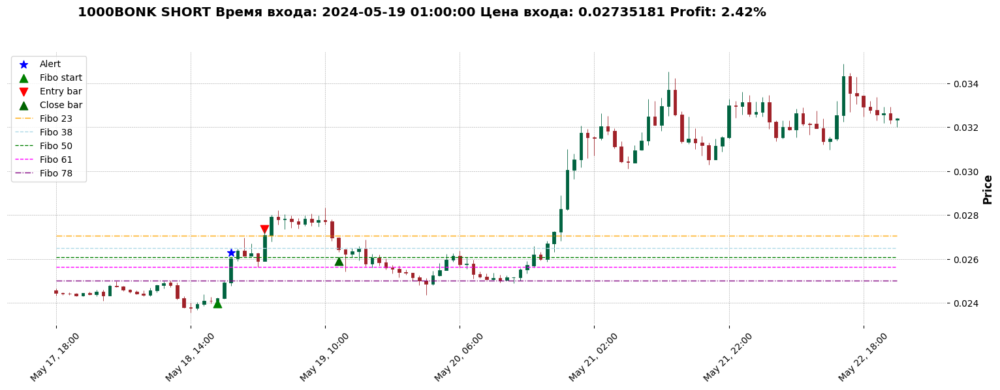

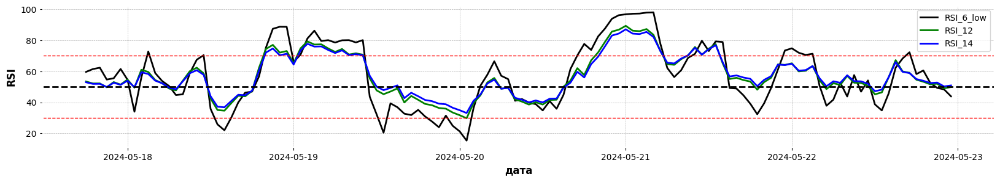

Алерт 2024-05-18 20:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3739 в 2024-05-20 20:00:00 с ценой закр 0.027241 нет дивергенции и обновления максимумов
На баре 3740 в 2024-05-20 21:00:00 с ценой закр 0.028271 нет дивергенции и обновления максимумов
На баре 3741 в 2024-05-20 22:00:00 с ценой закр 0.030048 нет дивергенции и обновления максимумов
На баре 3742 в 2024-05-20 23:00:00 с ценой закр 0.030524 нет дивергенции и обновления максимумов
На баре 3743 в 2024-05-21 00:00:00 с ценой закр 0.031734 нет дивергенции и обновления максимумов


Время и цена алерта: 2024-05-20 19:00:00 0.026708
Пересечение RSI 12


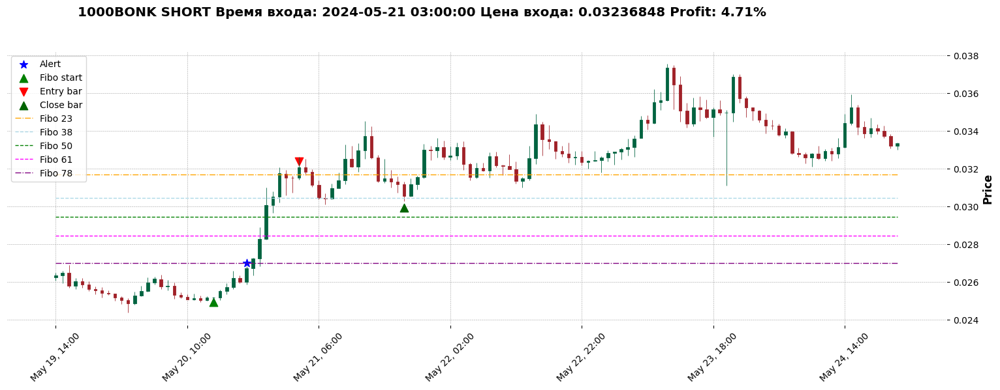

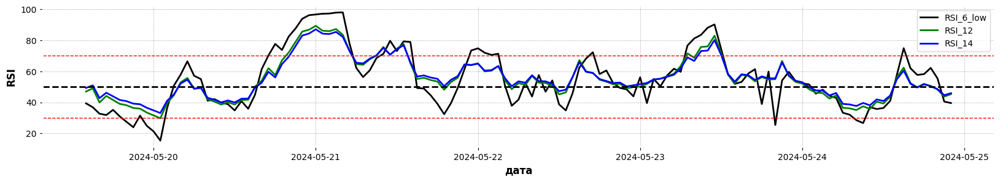

Алерт 2024-05-20 19:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!















На баре 3798 в 2024-05-23 07:00:00 с ценой закр 0.034578 нет дивергенции и обновления максимумов

На баре 3800 в 2024-05-23 09:00:00 с ценой закр 0.035522 нет дивергенции и обновления максимумов
На баре 3801 в 2024-05-23 10:00:00 с ценой закр 0.035596 нет дивергенции и обновления максимумов
На баре 3802 в 2024-05-23 11:00:00 с ценой закр 0.037329 нет дивергенции и обновления максимумов





На баре 3800 в 2024-05-23 09:00:00 с ценой закр 0.035522 нет дивергенции и обновления максимумов
На баре 3801 в 2024-05-23 10:00:00 с ценой закр 0.035596 нет дивергенции и обновления максимумов
На баре 3802 в 2024-05-23 11:00:00 с ценой закр 0.037329 нет дивергенции и обновления максимумов




















Время и цена алерта: 2024-05-23 09:00:00 0.035522
Фибо достигнуто.


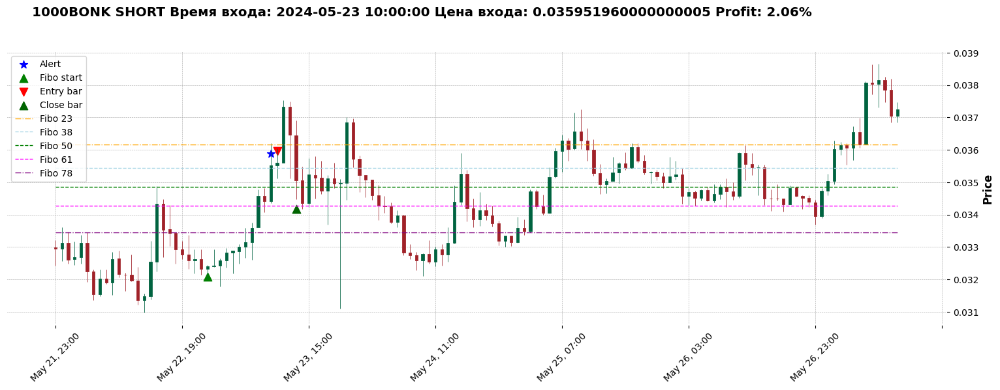

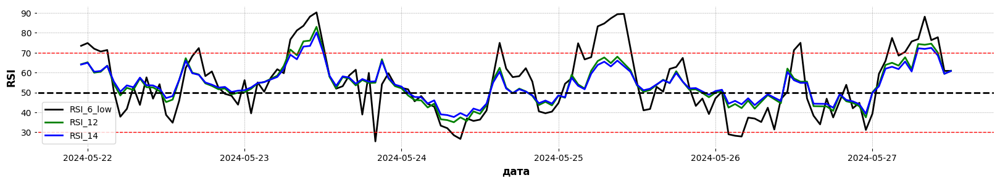

Алерт 2024-05-23 09:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3846 в 2024-05-25 07:00:00 с ценой закр 0.036274 нет дивергенции и обновления максимумов

На баре 3848 в 2024-05-25 09:00:00 с ценой закр 0.036571 нет дивергенции и обновления максимумов






















На баре 3848 в 2024-05-25 09:00:00 с ценой закр 0.036571 нет дивергенции и обновления максимумов














































На баре 3890 в 2024-05-27 03:00:00 с ценой закр 0.036146 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-05-27 02:00:00 0.036019
Пересечение RSI 12


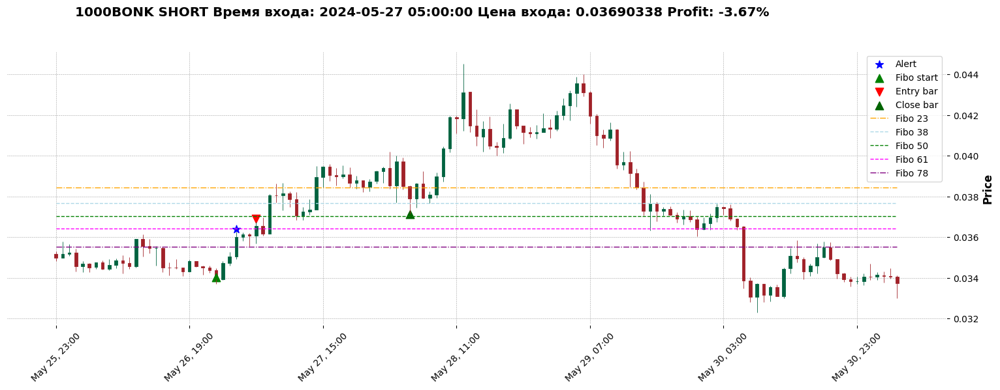

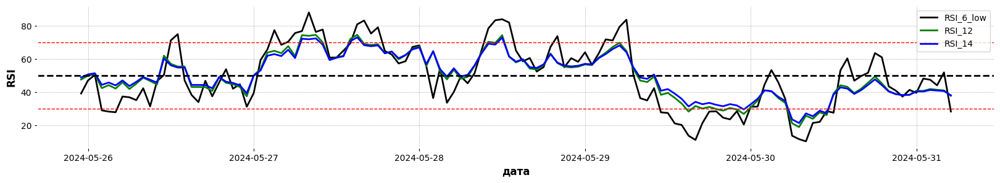

Алерт 2024-05-27 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 3921 в 2024-05-28 10:00:00 с ценой закр 0.041897 нет дивергенции и обновления максимумов

На баре 3923 в 2024-05-28 12:00:00 с ценой закр 0.043121 нет дивергенции и обновления максимумов
















Время и цена алерта: 2024-05-28 09:00:00 0.040351
Фибо достигнуто.


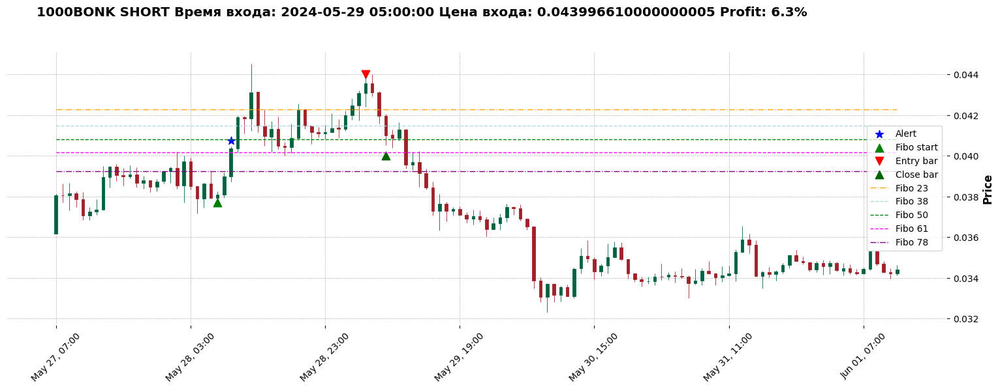

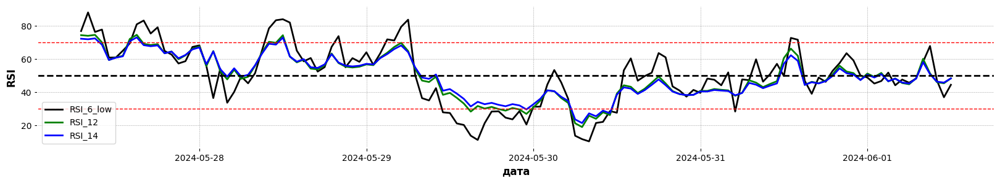

Алерт 2024-05-28 09:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























Время и цена алерта: 2024-06-03 08:00:00 0.034423
Фибо достигнуто.


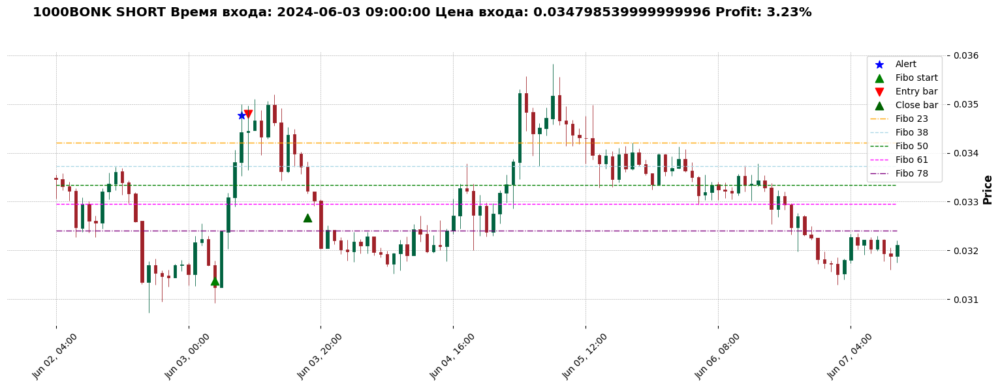

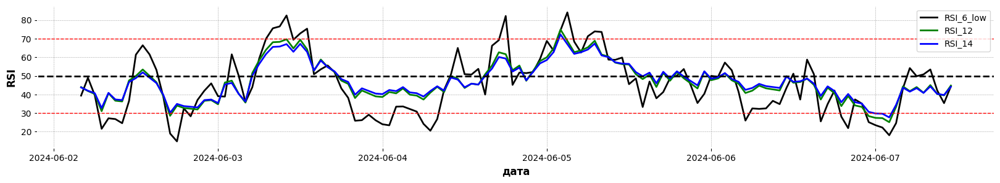

Алерт 2024-06-03 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!






Недостаточный потенциал отката: 1.3%
Недостаточный потенциал отката: 2.7%
На баре 4105 в 2024-06-05 02:00:00 с ценой закр 0.035224 нет дивергенции и обновления максимумов















На баре 4104 в 2024-06-05 01:00:00 с ценой закр 0.033816 нет дивергенции и обновления максимумов
На баре 4105 в 2024-06-05 02:00:00 с ценой закр 0.035224 нет дивергенции и обновления максимумов






















На баре 4105 в 2024-06-05 02:00:00 с ценой закр 0.035224 нет дивергенции и обновления максимумов








































































На баре 4213 в 2024-06-09 14:00:00 с ценой закр 0.028895 нет дивергенции и обновления максимумов

Недостаточный потенциал отката: 3.8%





















Недостаточный потенциал отката: 3.8%














































На баре 4278 в 2024-06-12 07:00:00 с ценой закр 0.02884 нет дивергенции и обновления максимумов

На баре 4280 в 2024-06-12 0

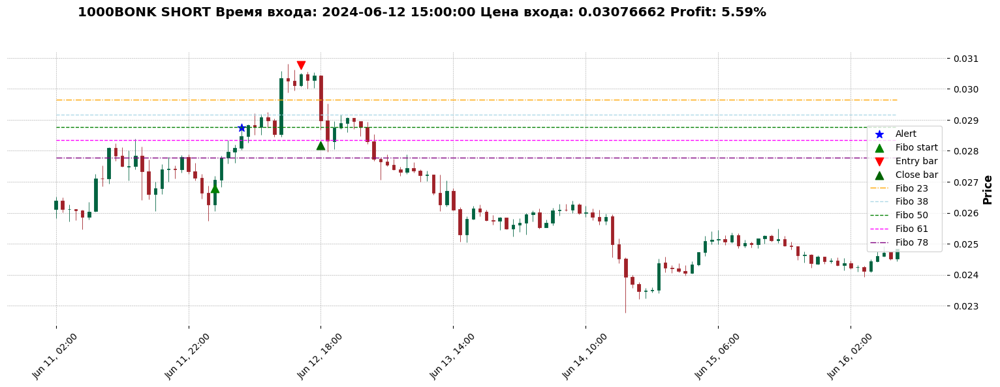

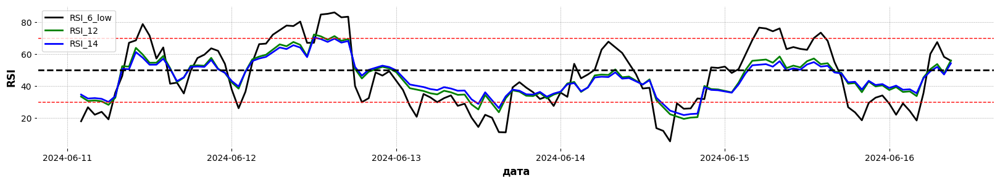

Алерт 2024-06-12 06:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 4441 в 2024-06-19 02:00:00 с ценой закр 0.02178 нет дивергенции и обновления максимумов
На баре 4442 в 2024-06-19 03:00:00 с ценой закр 0.021953 нет дивергенции и обновления максимумов
На баре 4443 в 2024-06-19 04:00:00 с ценой закр 0.022232 нет дивергенции и обновления максимумов

На баре 4445 в 2024-06-19 06:00:00 с ценой закр 0.022473 нет дивергенции и обновления максимумов



















На баре 4442 в 2024-06-19 03:00:00 с ценой закр 0.021953 нет дивергенции и обновления максимумов
На баре 4443 в 2024-06-19 04:00:00 с ценой закр 0.022232 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-06-19 02:00:00 0.02178
Фибо достигнуто.


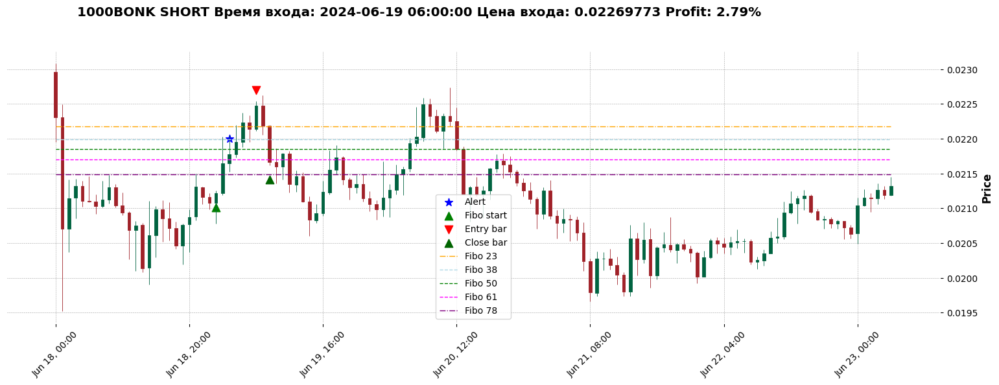

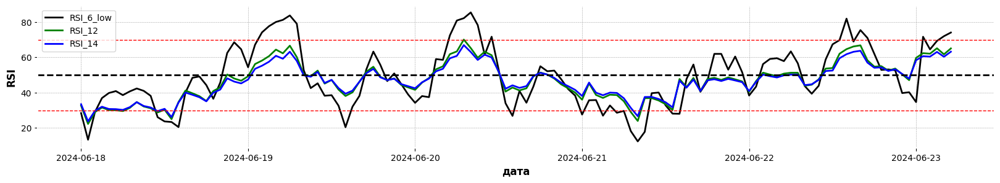

Алерт 2024-06-19 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 4470 в 2024-06-20 07:00:00 с ценой закр 0.022498 нет дивергенции и обновления максимумов















































На баре 4525 в 2024-06-22 14:00:00 с ценой закр 0.021067 нет дивергенции и обновления максимумов
Недостаточный потенциал отката: 3.7%
Недостаточный потенциал отката: 3.9%










Недостаточный потенциал отката: 2.5%

Недостаточный потенциал отката: 2.8%








Недостаточный потенциал отката: 3.7%
Недостаточный потенциал отката: 3.9%










Недостаточный потенциал отката: 2.5%

Недостаточный потенциал отката: 2.8%









Недостаточный потенциал отката: 3.9%










Недостаточный потенциал отката: 2.5%

Недостаточный потенциал отката: 2.8%




















Недостаточный потенциал отката: 2.5%

Недостаточный потенциал отката: 2.8%











На баре 4582 в 2024-06-24 23:00:00 с ценой закр 0.02175 нет дивергенции и обновления максимумов
На баре 4583 в 2024-06-25 00:00:00 с цен

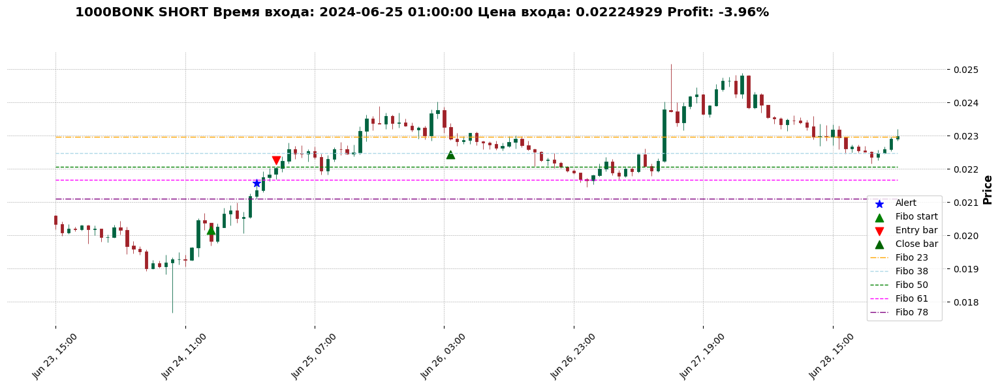

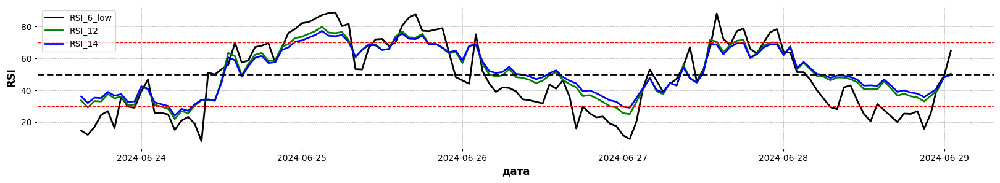

Алерт 2024-06-24 22:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


Время и цена алерта: 2024-06-27 13:00:00 0.02378
Пересечение RSI 12


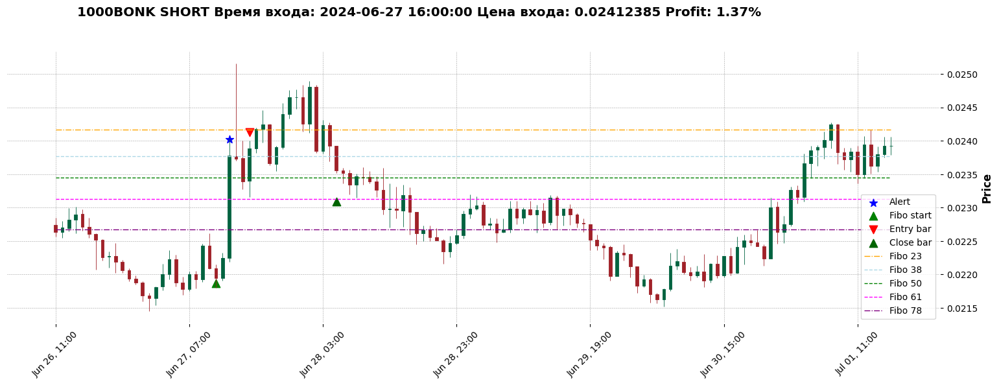

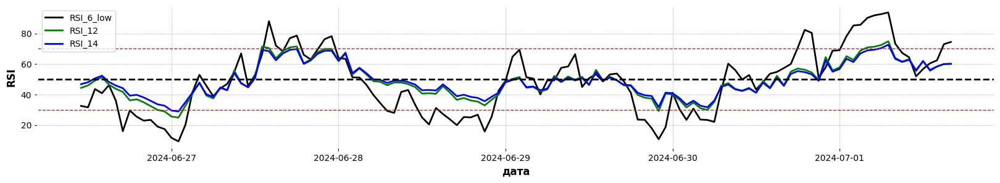

Алерт 2024-06-27 13:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


Недостаточный потенциал отката: 3.6%

Время и цена алерта: 2024-06-30 22:00:00 0.023007
Пересечение RSI 12


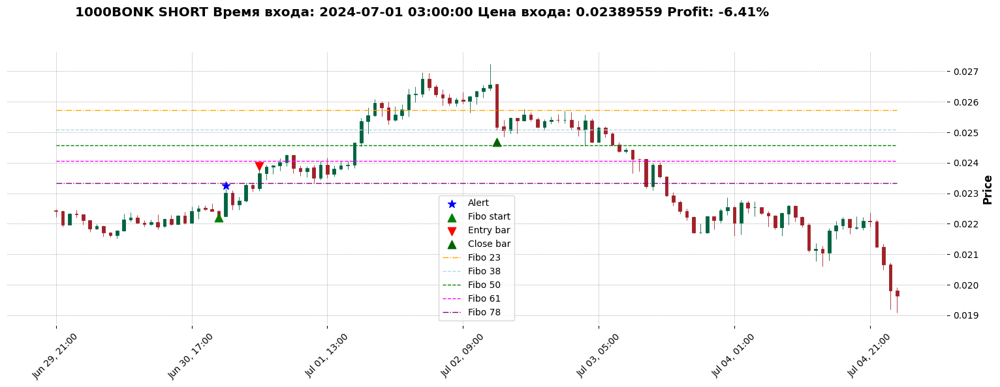

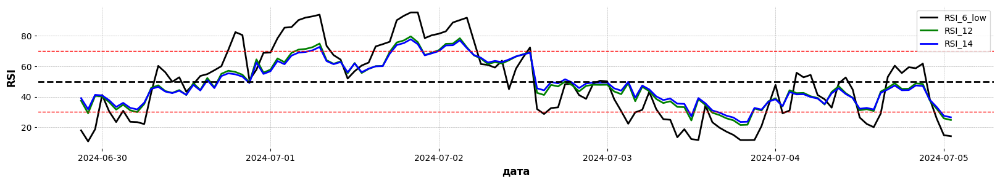

Алерт 2024-06-30 22:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 4863 в 2024-07-06 16:00:00 с ценой закр 0.02361 нет дивергенции и обновления максимумов


















































Время и цена алерта: 2024-07-08 08:00:00 0.023767
Пересечение RSI 12


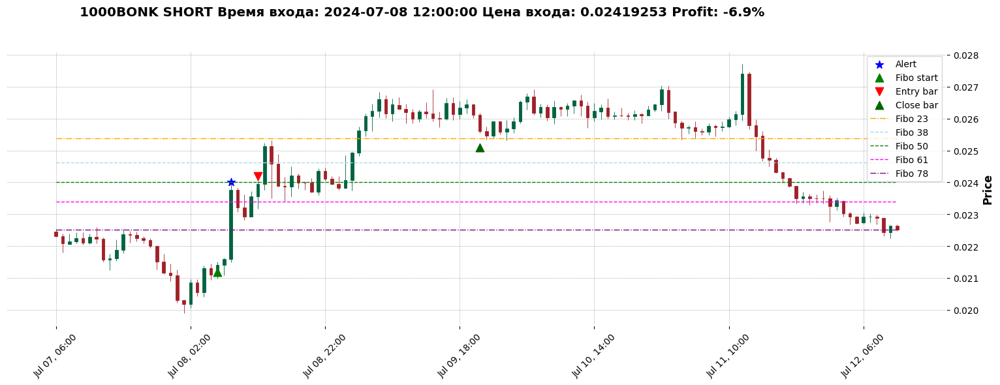

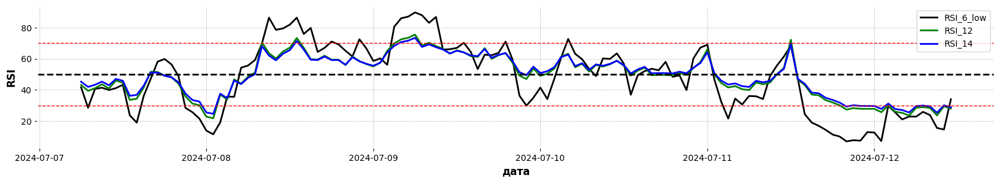

Алерт 2024-07-08 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!











На баре 4979 в 2024-07-11 12:00:00 с ценой закр 0.027403 нет дивергенции и обновления максимумов




































На баре 5040 в 2024-07-14 01:00:00 с ценой закр 0.023884 нет дивергенции и обновления максимумов






Время и цена алерта: 2024-07-14 00:00:00 0.023485
Фибо достигнуто.


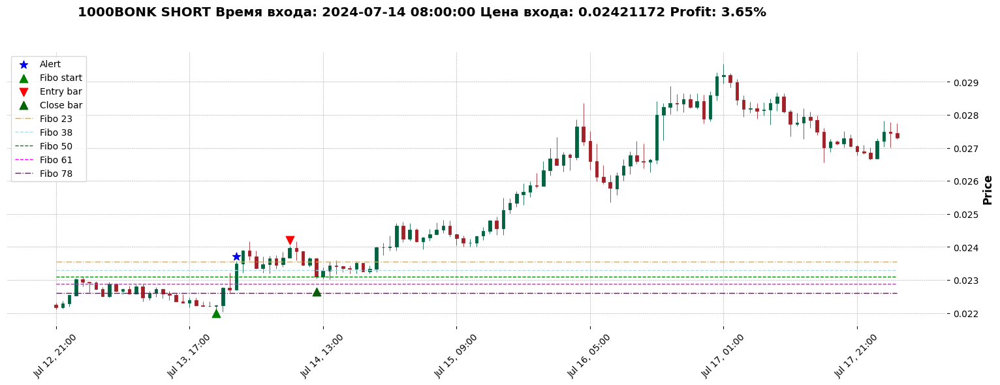

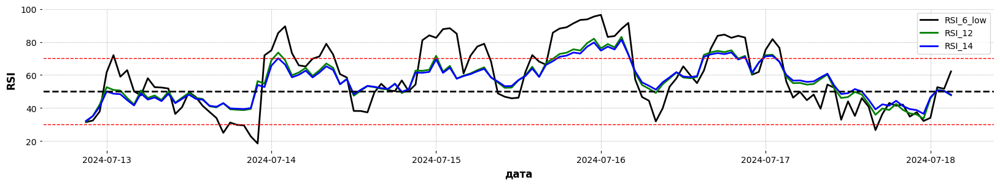

Алерт 2024-07-14 00:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5063 в 2024-07-15 00:00:00 с ценой закр 0.024637 нет дивергенции и обновления максимумов













Время и цена алерта: 2024-07-14 23:00:00 0.024015
Фибо достигнуто.


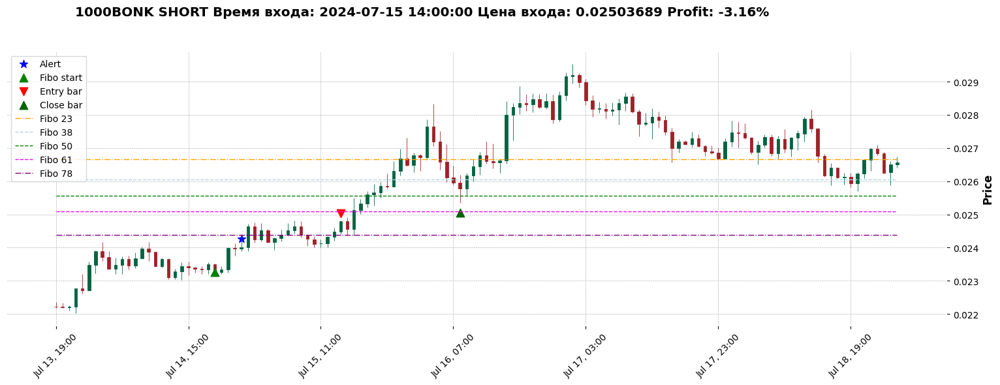

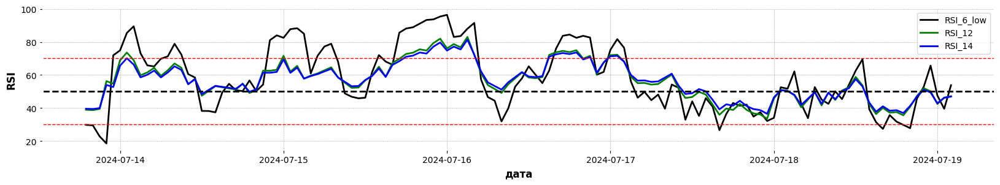

Алерт 2024-07-14 23:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5103 в 2024-07-16 16:00:00 с ценой закр 0.028231 нет дивергенции и обновления максимумов
На баре 5104 в 2024-07-16 17:00:00 с ценой закр 0.02836 нет дивергенции и обновления максимумов

Время и цена алерта: 2024-07-16 15:00:00 0.027999
Фибо достигнуто.


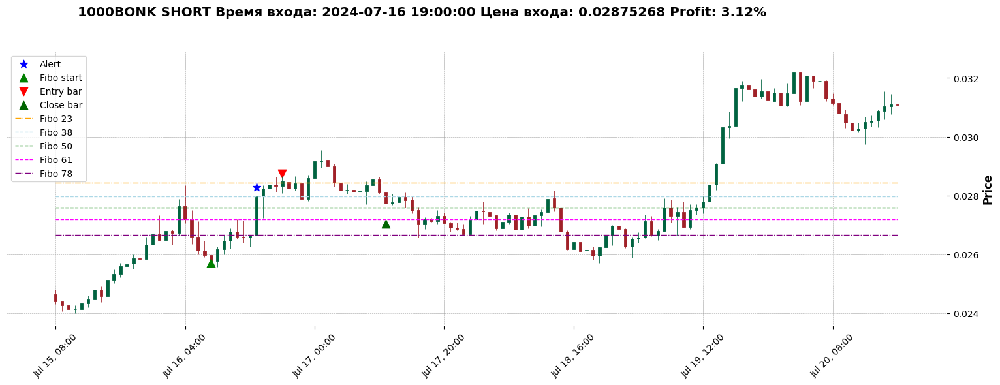

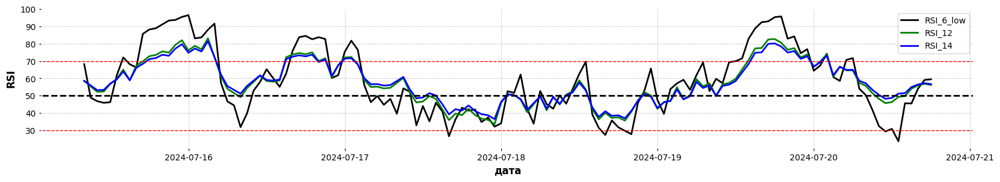

Алерт 2024-07-16 15:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5173 в 2024-07-19 14:00:00 с ценой закр 0.029081 нет дивергенции и обновления максимумов
На баре 5174 в 2024-07-19 15:00:00 с ценой закр 0.030317 нет дивергенции и обновления максимумов
На баре 5175 в 2024-07-19 16:00:00 с ценой закр 0.030376 нет дивергенции и обновления максимумов
На баре 5176 в 2024-07-19 17:00:00 с ценой закр 0.031661 нет дивергенции и обновления максимумов
На баре 5177 в 2024-07-19 18:00:00 с ценой закр 0.031747 нет дивергенции и обновления максимумов







Время и цена алерта: 2024-07-19 13:00:00 0.028365
Пересечение RSI 12


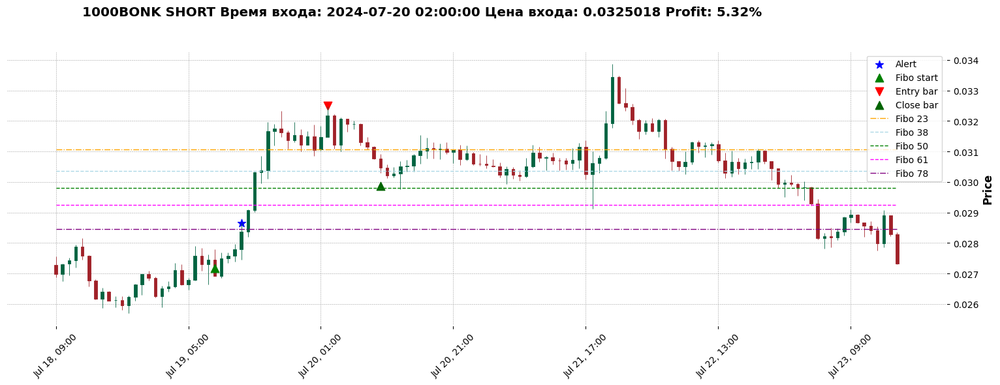

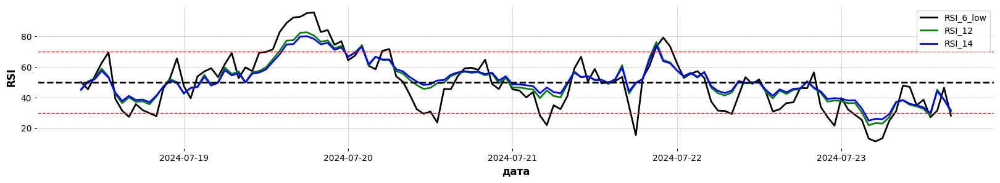

Алерт 2024-07-19 13:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5228 в 2024-07-21 21:00:00 с ценой закр 0.033434 нет дивергенции и обновления максимумов































































































На баре 5329 в 2024-07-26 02:00:00 с ценой закр 0.028437 нет дивергенции и обновления максимумов
















Время и цена алерта: 2024-07-26 01:00:00 0.027854
Пересечение RSI 12


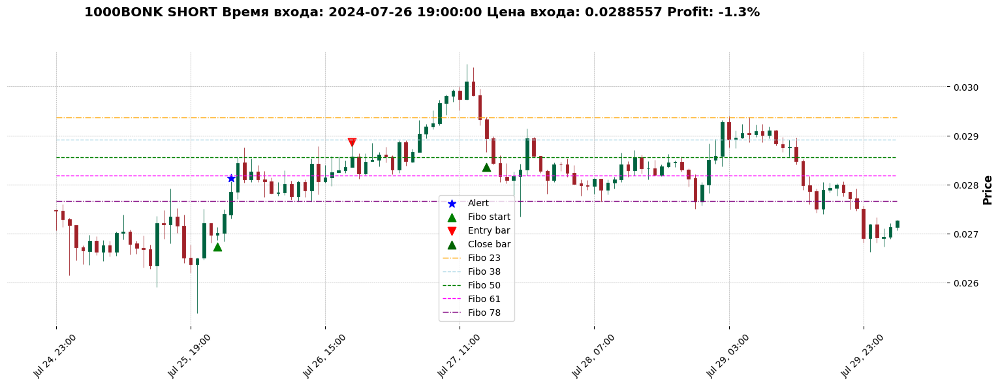

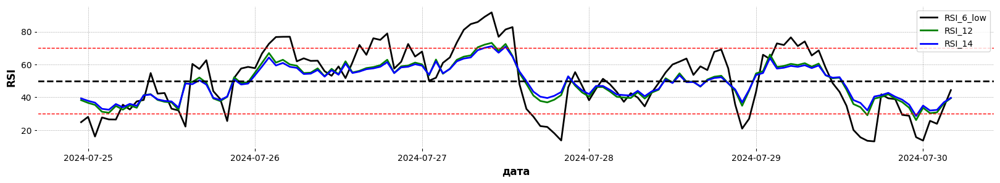

Алерт 2024-07-26 01:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
































































































На баре 5596 в 2024-08-06 05:00:00 с ценой закр 0.020378 нет дивергенции и обновления максимумов









Время и цена алерта: 2024-08-06 04:00:00 0.019894
Пересечение RSI 12


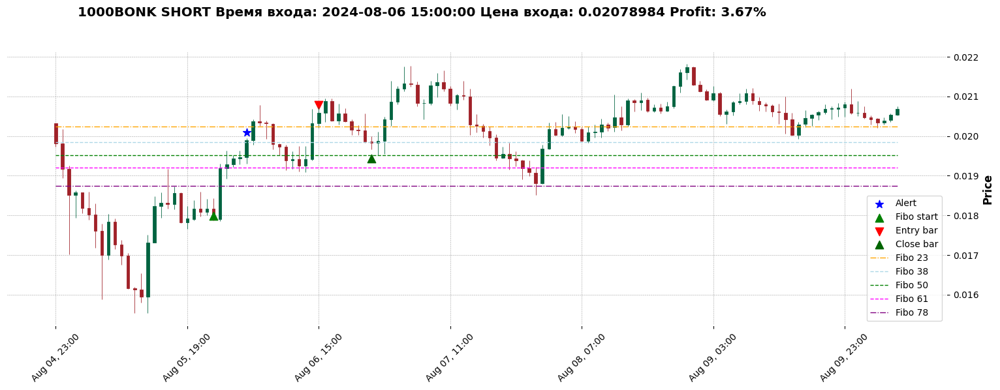

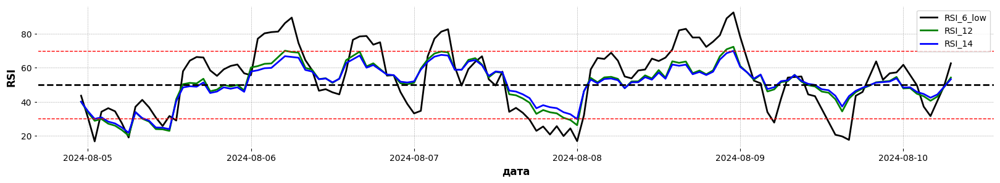

Алерт 2024-08-06 04:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5619 в 2024-08-07 04:00:00 с ценой закр 0.021323 нет дивергенции и обновления максимумов




Время и цена алерта: 2024-08-07 03:00:00 0.021201
Пересечение RSI 12


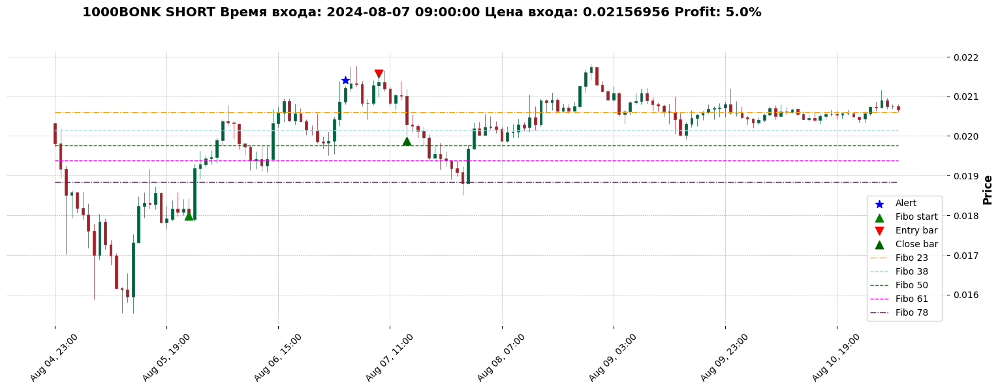

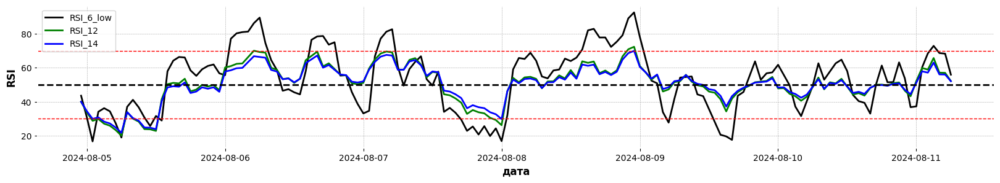

Алерт 2024-08-07 03:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5662 в 2024-08-08 23:00:00 с ценой закр 0.021732 нет дивергенции и обновления максимумов








































































На баре 5881 в 2024-08-18 02:00:00 с ценой закр 0.018197 нет дивергенции и обновления максимумов















































Недостаточный потенциал отката: 1.1%


Недостаточный потенциал отката: 1.5%
Недостаточный потенциал отката: 1.6%










































На баре 5928 в 2024-08-20 01:00:00 с ценой закр 0.018229 нет дивергенции и обновления максимумов


Время и цена алерта: 2024-08-20 00:00:00 0.018151
Фибо достигнуто.


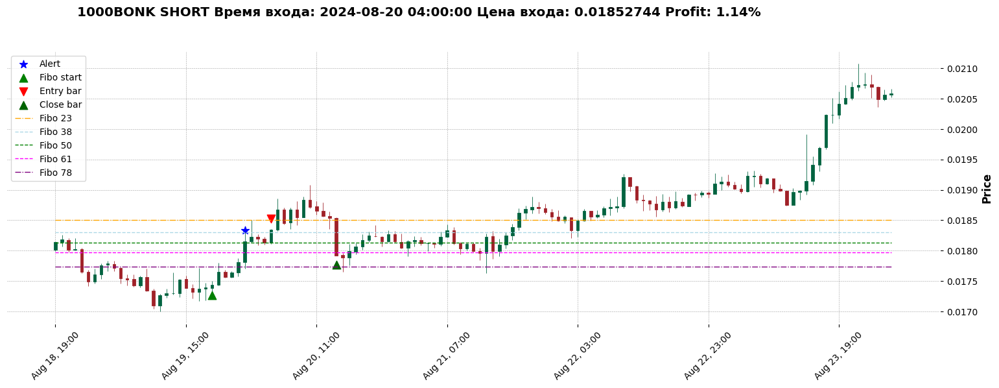

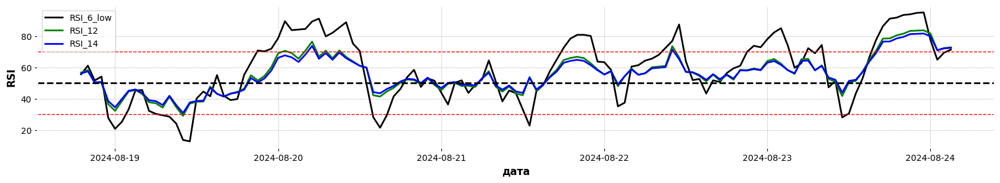

Алерт 2024-08-20 00:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 5969 в 2024-08-21 18:00:00 с ценой закр 0.018626 нет дивергенции и обновления максимумов
На баре 5970 в 2024-08-21 19:00:00 с ценой закр 0.018684 нет дивергенции и обновления максимумов
На баре 5971 в 2024-08-21 20:00:00 с ценой закр 0.018717 нет дивергенции и обновления максимумов












Недостаточный потенциал отката: 0.9%
На баре 5985 в 2024-08-22 10:00:00 с ценой закр 0.01921 нет дивергенции и обновления максимумов







Недостаточный потенциал отката: 3.1%
Недостаточный потенциал отката: 3.3%












Недостаточный потенциал отката: 0.9%
Недостаточный потенциал отката: 3.4%








Недостаточный потенциал отката: 3.3%












Недостаточный потенциал отката: 0.9%
Недостаточный потенциал отката: 3.4%





















Недостаточный потенциал отката: 0.9%
Недостаточный потенциал отката: 3.4%




























Недостаточный потенциал отката: 3.5%
Недостаточный потенциал отката: 3.5%








Н

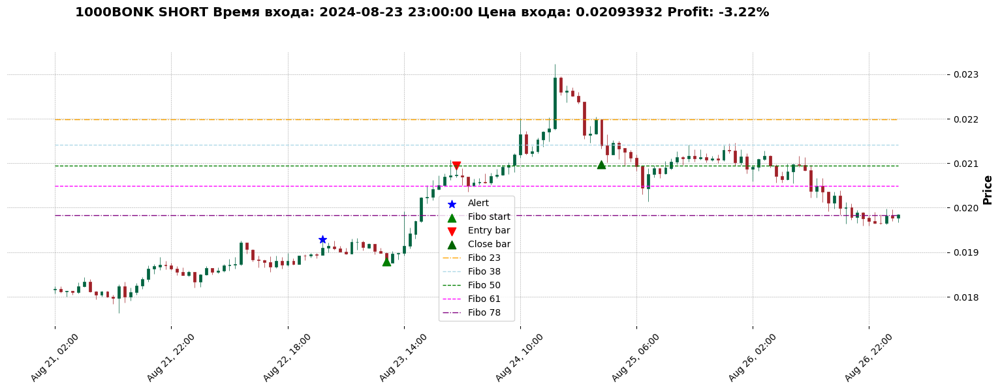

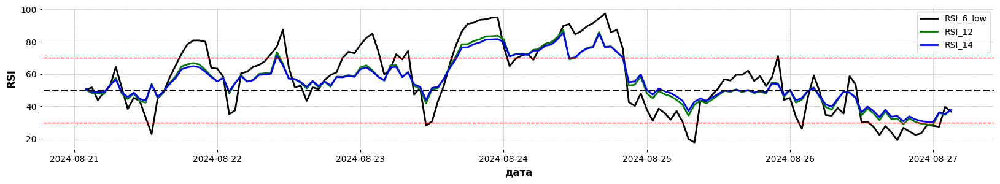

Алерт 2024-08-23 00:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
Недостаточный потенциал отката: 2.7%

Недостаточный потенциал отката: 2.8%






















Недостаточный потенциал отката: 2.8%






















Время и цена алерта: 2024-09-03 02:00:00 0.017797
Пересечение RSI 12


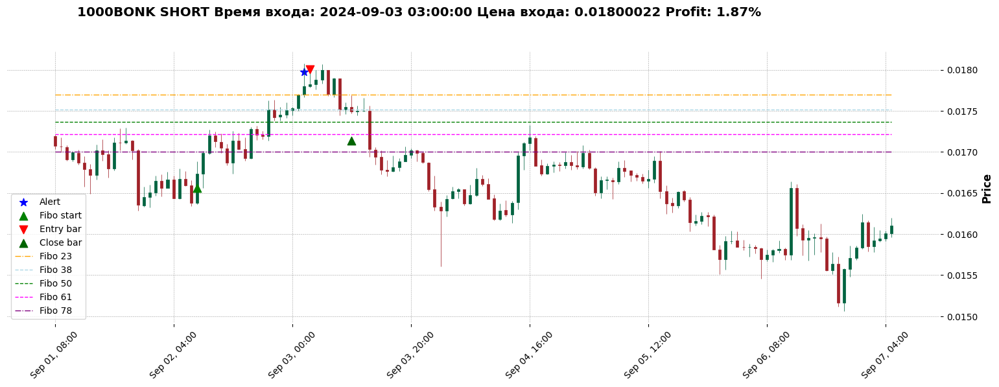

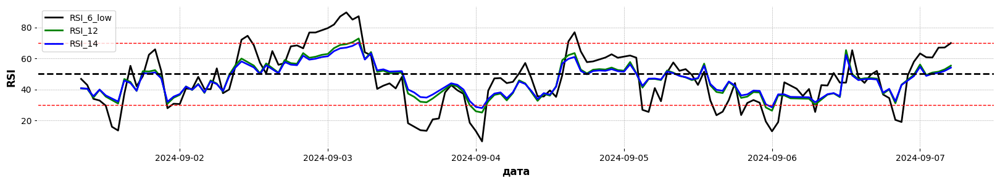

Алерт 2024-09-03 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


Недостаточный потенциал отката: 3.2%













Недостаточный потенциал отката: 2.4%







Недостаточный потенциал отката: 3.2%













Недостаточный потенциал отката: 2.4%







Недостаточный потенциал отката: 1.6%














Недостаточный потенциал отката: 2.4%







Недостаточный потенциал отката: 1.6%



На баре 6425 в 2024-09-09 18:00:00 с ценой закр 0.016884 нет дивергенции и обновления максимумов
На баре 6426 в 2024-09-09 19:00:00 с ценой закр 0.017122 нет дивергенции и обновления максимумов
На баре 6427 в 2024-09-09 20:00:00 с ценой закр 0.017179 нет дивергенции и обновления максимумов
На баре 6428 в 2024-09-09 21:00:00 с ценой закр 0.017493 нет дивергенции и обновления максимумов













Время и цена алерта: 2024-09-09 16:00:00 0.016837
Пересечение RSI 12


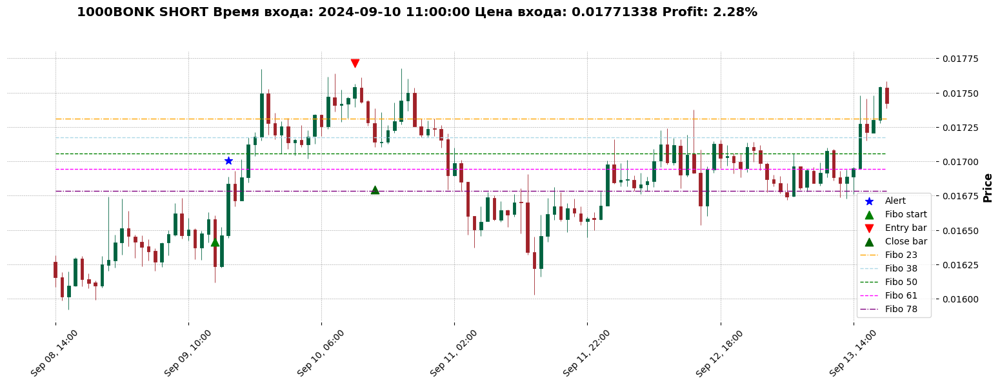

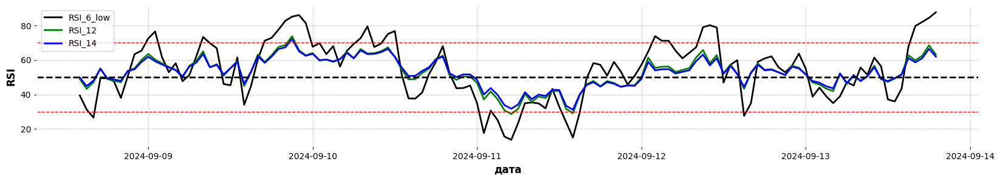

Алерт 2024-09-09 16:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!






Недостаточный потенциал отката: 1.9%
Недостаточный потенциал отката: 2.6%







Недостаточный потенциал отката: 1.2%












Недостаточный потенциал отката: 1.9%
Недостаточный потенциал отката: 2.6%







Недостаточный потенциал отката: 1.2%













Недостаточный потенциал отката: 1.9%
На баре 6488 в 2024-09-12 09:00:00 с ценой закр 0.017122 нет дивергенции и обновления максимумов







Недостаточный потенциал отката: 1.2%


















Недостаточный потенциал отката: 1.2%

















Недостаточный потенциал отката: 2.4%
На баре 6521 в 2024-09-13 18:00:00 с ценой закр 0.017538 нет дивергенции и обновления максимумов


Время и цена алерта: 2024-09-13 15:00:00 0.017274
Фибо достигнуто.


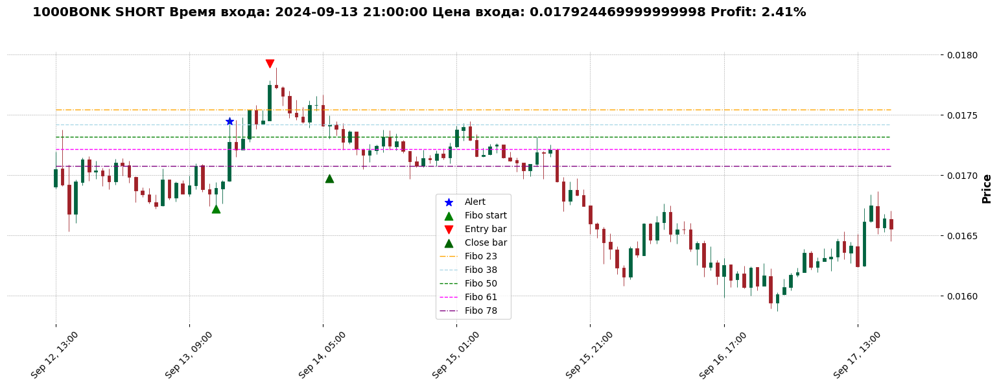

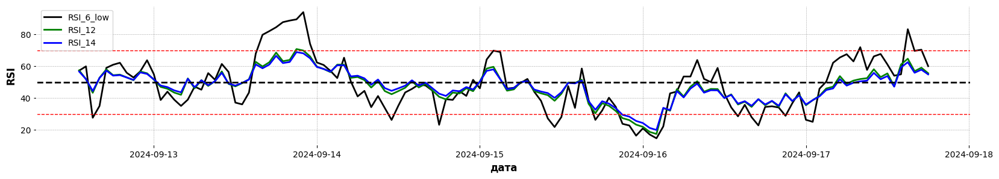

Алерт 2024-09-13 15:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 6614 в 2024-09-17 15:00:00 с ценой закр 0.016746 нет дивергенции и обновления максимумов


















































Время и цена алерта: 2024-09-19 00:00:00 0.017167
Фибо достигнуто.


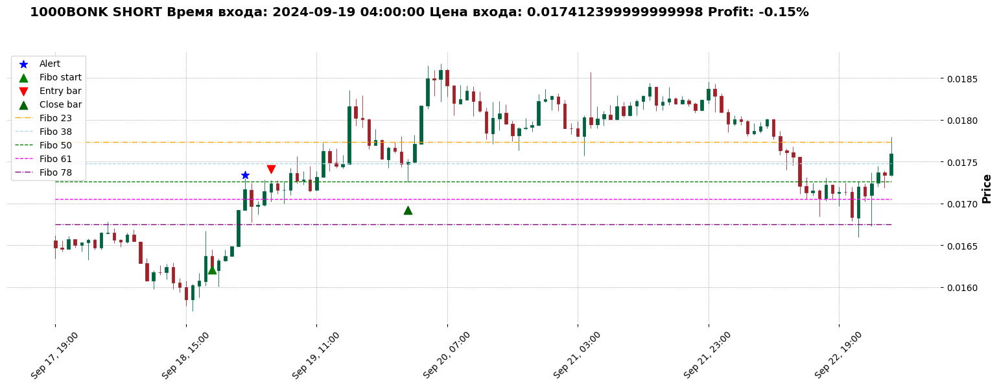

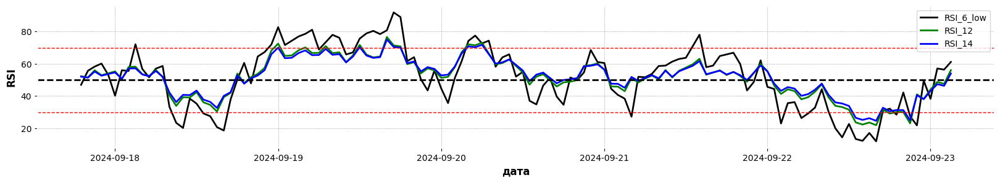

Алерт 2024-09-19 00:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!

Время и цена алерта: 2024-09-20 04:00:00 0.018499
Пересечение RSI 12


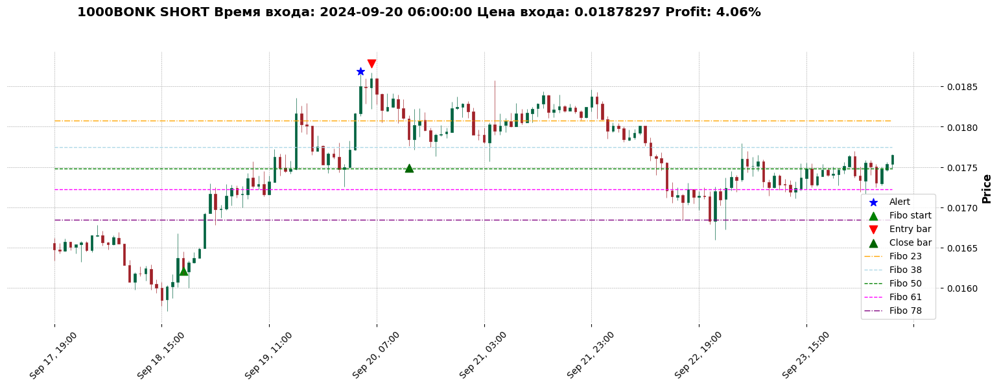

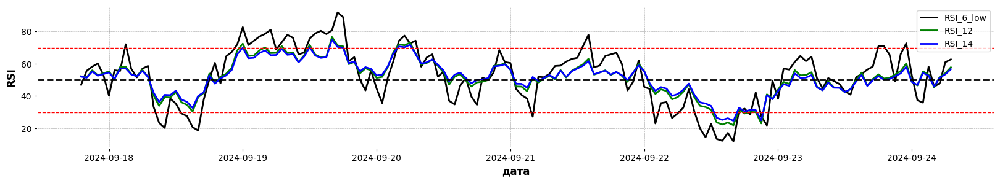

Алерт 2024-09-20 04:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























На баре 6775 в 2024-09-24 08:00:00 с ценой закр 0.01797 нет дивергенции и обновления максимумов



На баре 6779 в 2024-09-24 12:00:00 с ценой закр 0.018102 нет дивергенции и обновления максимумов
На баре 6780 в 2024-09-24 13:00:00 с ценой закр 0.018241 нет дивергенции и обновления максимумов




Время и цена алерта: 2024-09-24 07:00:00 0.017646
Фибо достигнуто.


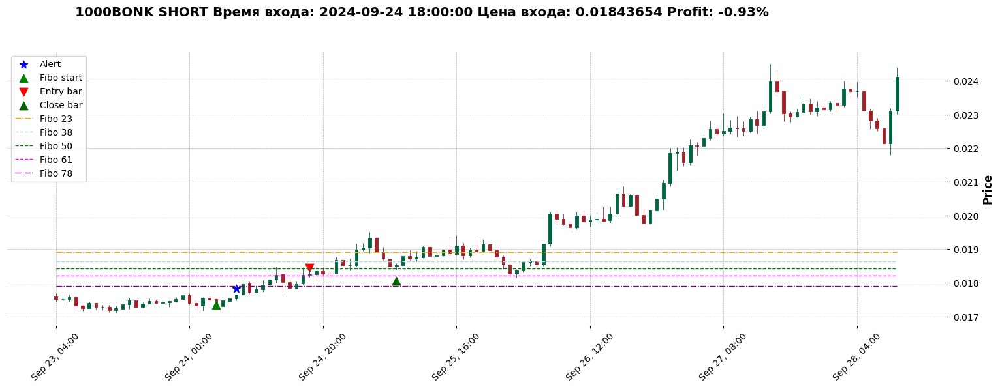

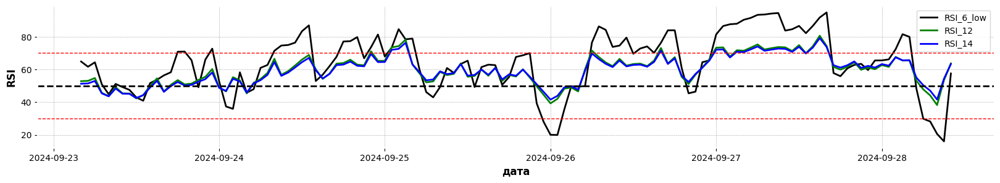

Алерт 2024-09-24 07:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!









Время и цена алерта: 2024-09-26 06:00:00 0.020058
Пересечение RSI 12


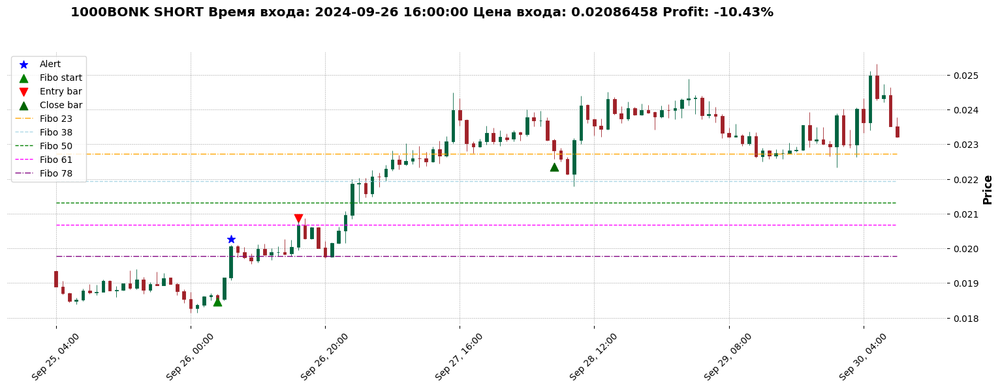

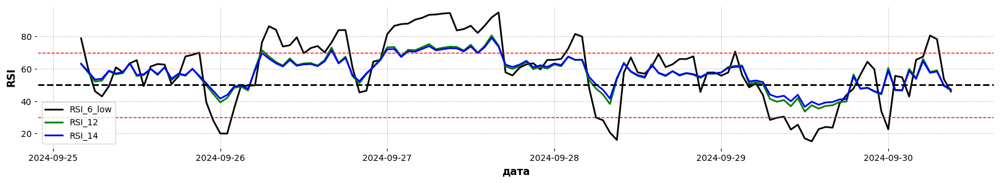

Алерт 2024-09-26 06:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!














Время и цена алерта: 2024-09-30 05:00:00 0.024981
Фибо достигнуто.


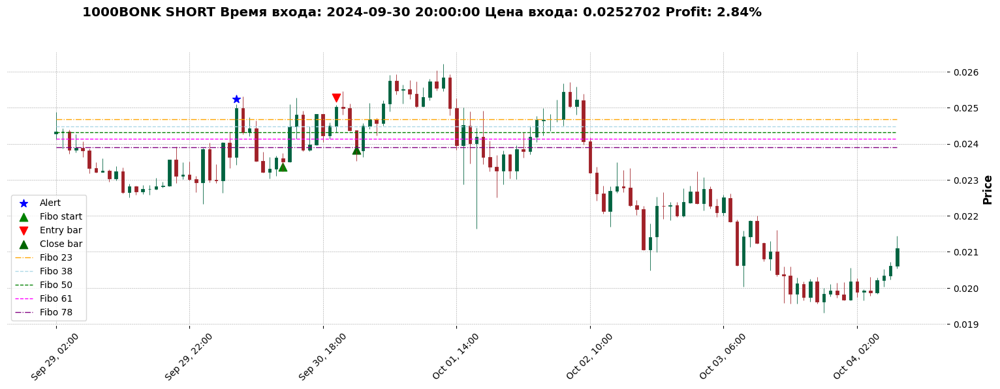

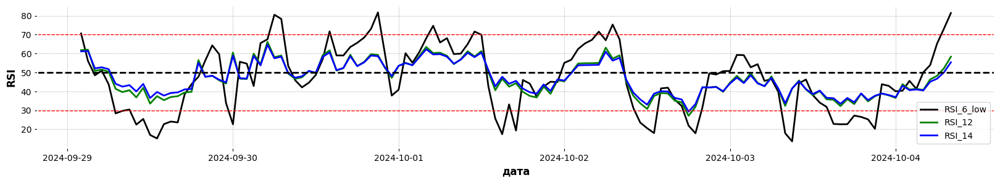

Алерт 2024-09-30 05:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!







Время и цена алерта: 2024-10-01 04:00:00 0.02575
Фибо достигнуто.


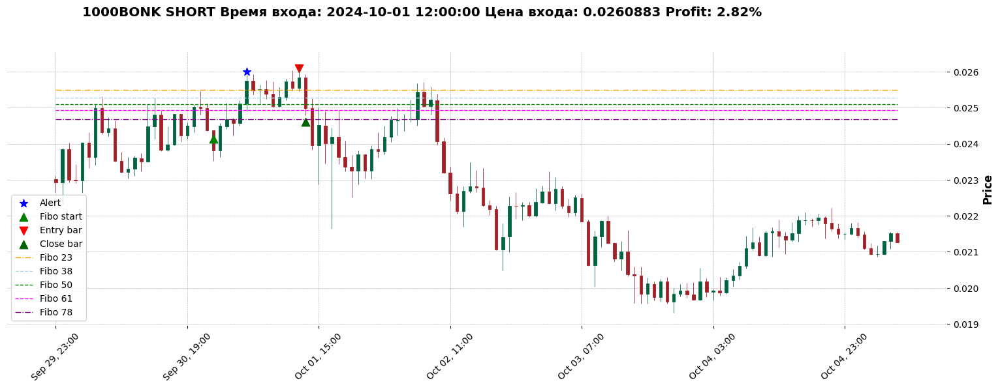

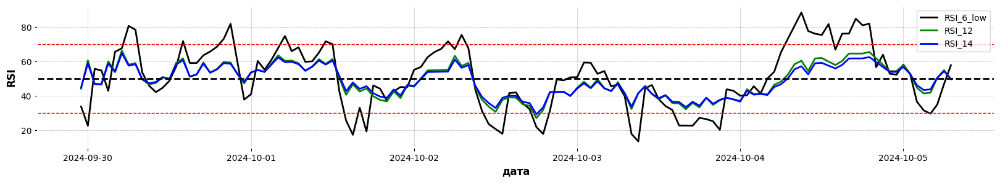

Алерт 2024-10-01 04:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 7070 в 2024-10-06 15:00:00 с ценой закр 0.021763 нет дивергенции и обновления максимумов






Время и цена алерта: 2024-10-06 14:00:00 0.021728
Фибо достигнуто.


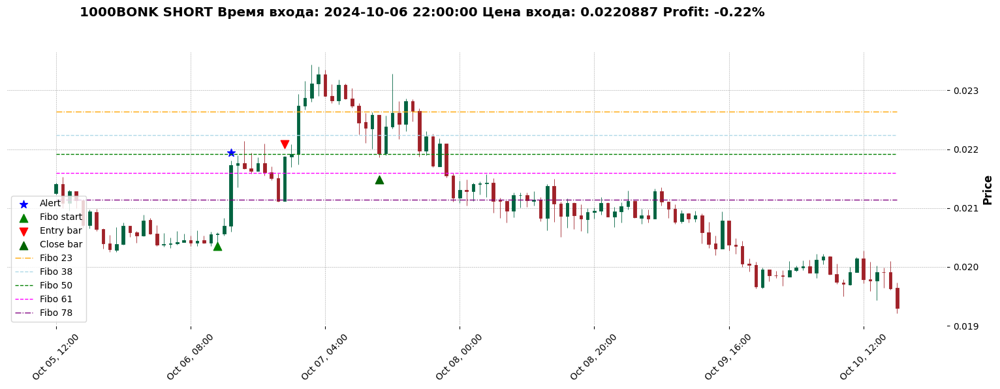

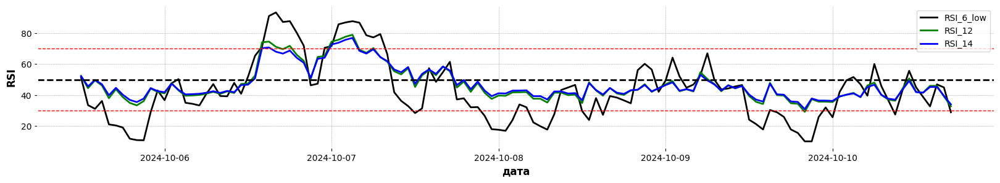

Алерт 2024-10-06 14:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 7175 в 2024-10-11 00:00:00 с ценой закр 0.020303 нет дивергенции и обновления максимумов
На баре 7176 в 2024-10-11 01:00:00 с ценой закр 0.020505 нет дивергенции и обновления максимумов
На баре 7177 в 2024-10-11 02:00:00 с ценой закр 0.020539 нет дивергенции и обновления максимумов
На баре 7178 в 2024-10-11 03:00:00 с ценой закр 0.020867 нет дивергенции и обновления максимумов








Время и цена алерта: 2024-10-10 23:00:00 0.02027
Пересечение RSI 12


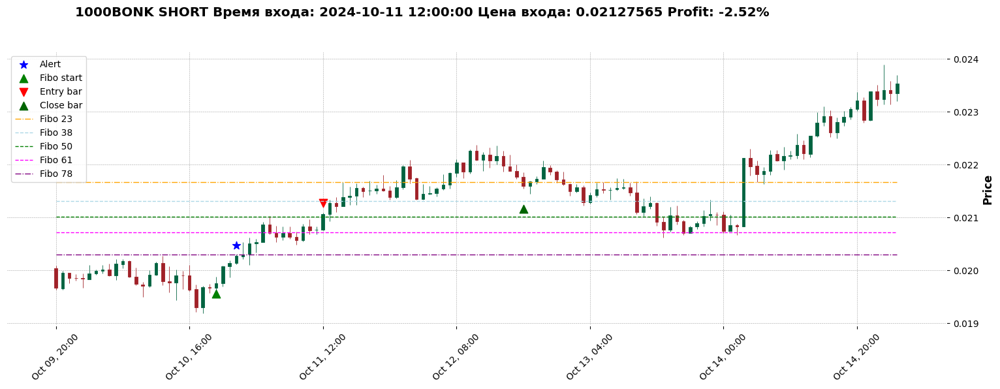

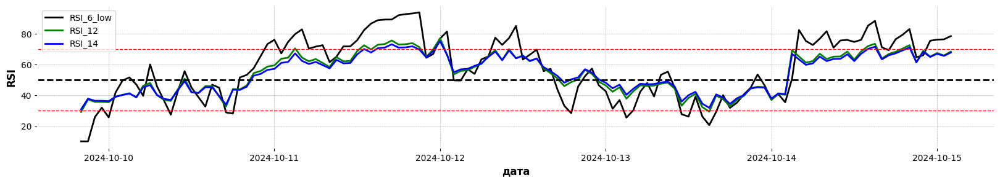

Алерт 2024-10-10 23:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!



Время и цена алерта: 2024-10-14 07:00:00 0.022195
Пересечение RSI 12


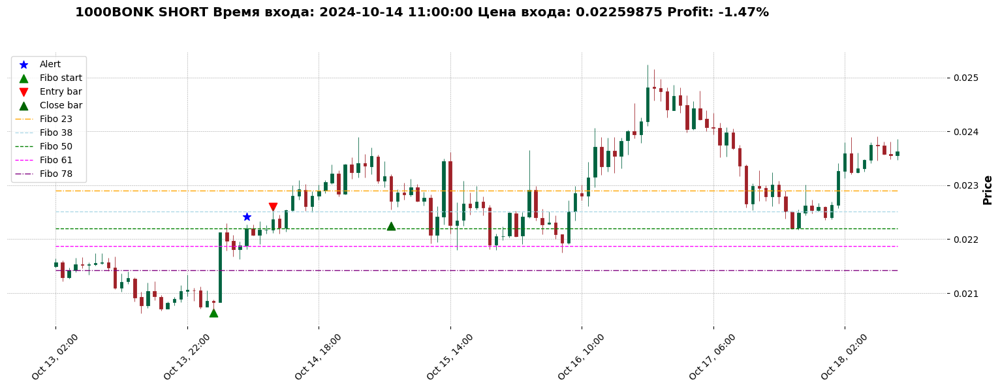

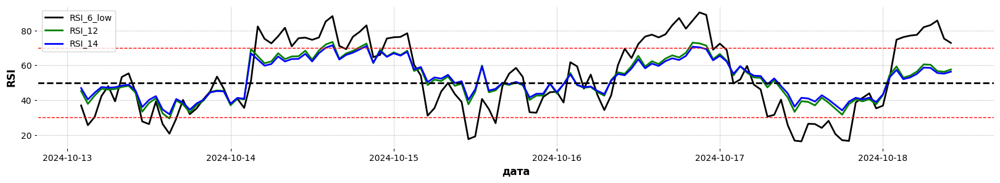

Алерт 2024-10-14 07:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!



Время и цена алерта: 2024-10-16 12:00:00 0.023709
Пересечение RSI 12


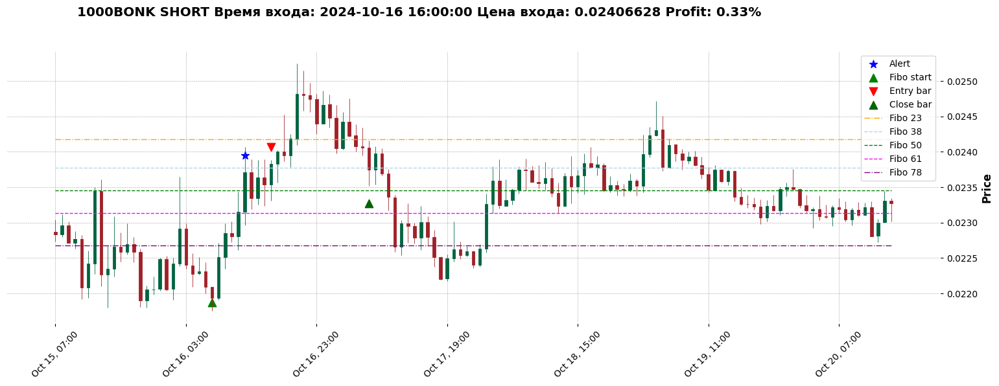

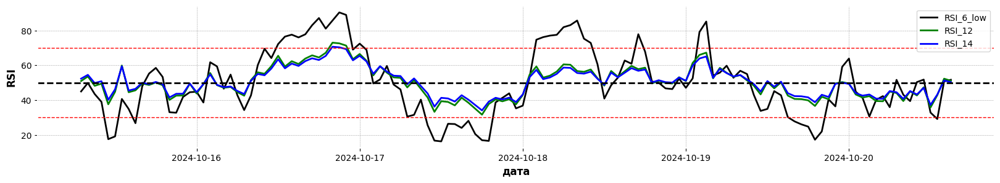

Алерт 2024-10-16 12:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 7369 в 2024-10-19 02:00:00 с ценой закр 0.024229 нет дивергенции и обновления максимумов
На баре 7370 в 2024-10-19 03:00:00 с ценой закр 0.024309 нет дивергенции и обновления максимумов






















На баре 7370 в 2024-10-19 03:00:00 с ценой закр 0.024309 нет дивергенции и обновления максимумов















































На баре 7412 в 2024-10-20 21:00:00 с ценой закр 0.023754 нет дивергенции и обновления максимумов
На баре 7413 в 2024-10-20 22:00:00 с ценой закр 0.024149 нет дивергенции и обновления максимумов
На баре 7414 в 2024-10-20 23:00:00 с ценой закр 0.024222 нет дивергенции и обновления максимумов
На баре 7415 в 2024-10-21 00:00:00 с ценой закр 0.024691 нет дивергенции и обновления максимумов
На баре 7416 в 2024-10-21 01:00:00 с ценой закр 0.024801 нет дивергенции и обновления максимумов



















На баре 7413 в 2024-10-20 22:00:00 с ценой закр 0.024149 нет дивергенции и о

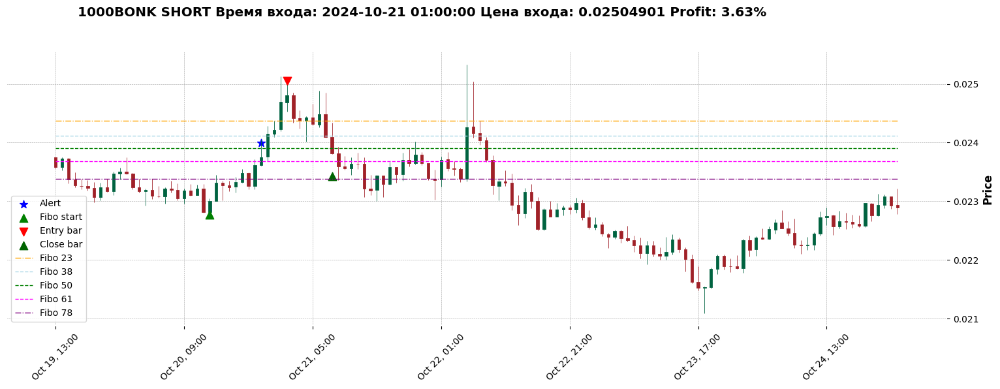

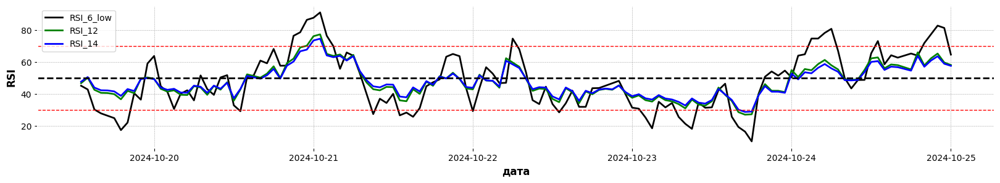

Алерт 2024-10-20 21:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!






























Недостаточный потенциал отката: 2.1%
Недостаточный потенциал отката: 2.2%





Недостаточный потенциал отката: 3.1%


На баре 7509 в 2024-10-24 22:00:00 с ценой закр 0.023078 нет дивергенции и обновления максимумов
































Недостаточный потенциал отката: 1.2%
На баре 7575 в 2024-10-27 16:00:00 с ценой закр 0.021415 нет дивергенции и обновления максимумов





















На баре 7575 в 2024-10-27 16:00:00 с ценой закр 0.021415 нет дивергенции и обновления максимумов








































































На баре 7609 в 2024-10-29 02:00:00 с ценой закр 0.021884 нет дивергенции и обновления максимумов






Время и цена алерта: 2024-10-29 00:00:00 0.021712
Фибо достигнуто.


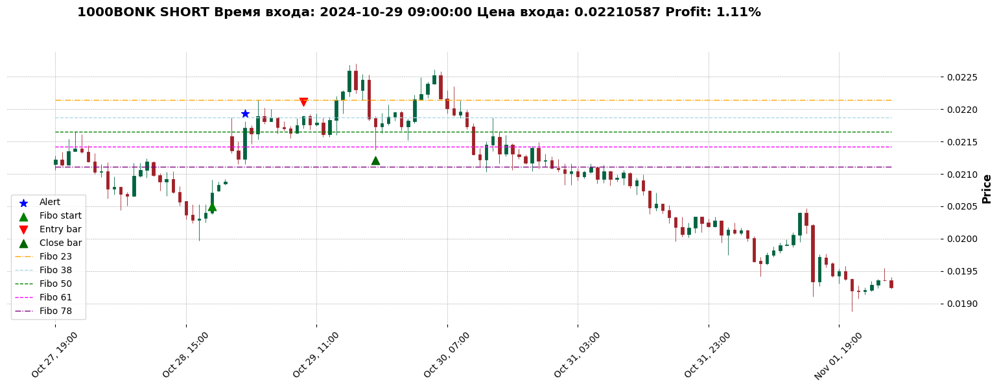

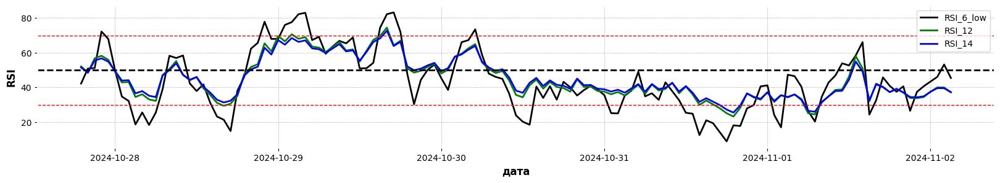

Алерт 2024-10-29 00:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 7780 в 2024-11-05 05:00:00 с ценой закр 0.018621 нет дивергенции и обновления максимумов

На баре 7782 в 2024-11-05 07:00:00 с ценой закр 0.018655 нет дивергенции и обновления максимумов
На баре 7783 в 2024-11-05 08:00:00 с ценой закр 0.019201 нет дивергенции и обновления максимумов





Время и цена алерта: 2024-11-05 04:00:00 0.018316
Пересечение RSI 12


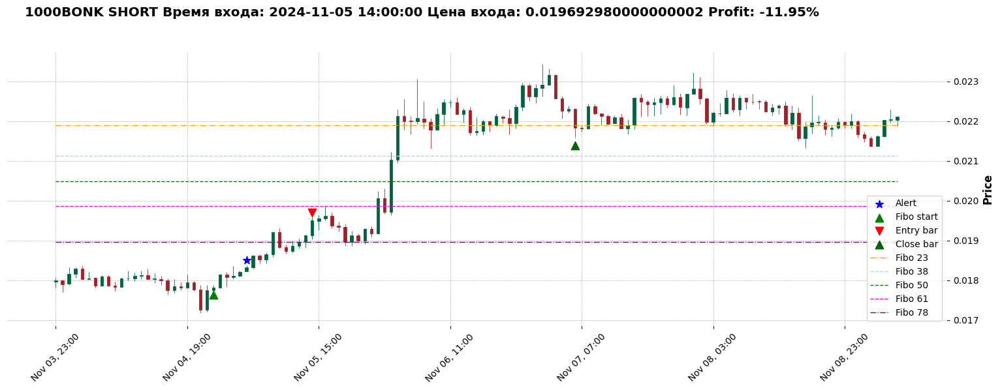

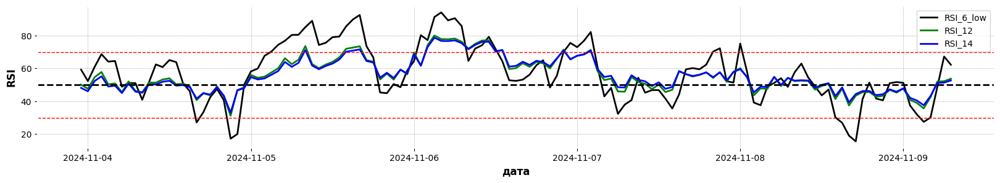

Алерт 2024-11-05 04:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


Недостаточный потенциал отката: 3.0%
На баре 7897 в 2024-11-10 02:00:00 с ценой закр 0.022925 нет дивергенции и обновления максимумов

На баре 7899 в 2024-11-10 04:00:00 с ценой закр 0.023296 нет дивергенции и обновления максимумов



На баре 7903 в 2024-11-10 08:00:00 с ценой закр 0.023937 нет дивергенции и обновления максимумов
На баре 7904 в 2024-11-10 09:00:00 с ценой закр 0.02443 нет дивергенции и обновления максимумов
На баре 7905 в 2024-11-10 10:00:00 с ценой закр 0.024713 нет дивергенции и обновления максимумов

На баре 7907 в 2024-11-10 12:00:00 с ценой закр 0.025104 нет дивергенции и обновления максимумов
На баре 7908 в 2024-11-10 13:00:00 с ценой закр 0.025828 нет дивергенции и обновления максимумов

На баре 7910 в 2024-11-10 15:00:00 с ценой закр 0.026043 нет дивергенции и обновления максимумов
Время и цена алерта: 2024-11-09 22:00:00 0.022469
Фибо достигнуто.


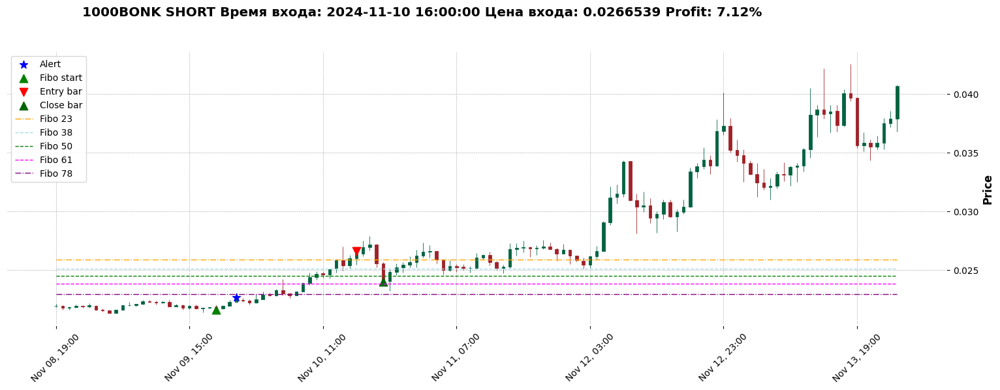

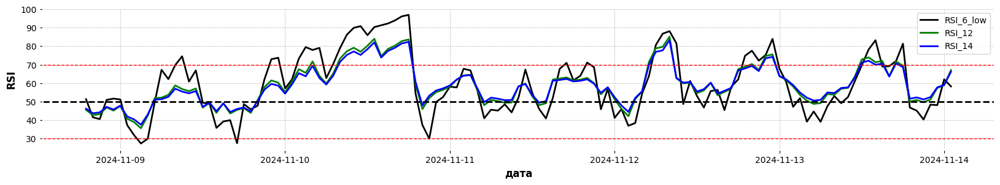

Алерт 2024-11-09 22:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 7949 в 2024-11-12 06:00:00 с ценой закр 0.031204 нет дивергенции и обновления максимумов
На баре 7950 в 2024-11-12 07:00:00 с ценой закр 0.03151 нет дивергенции и обновления максимумов
На баре 7951 в 2024-11-12 08:00:00 с ценой закр 0.03424 нет дивергенции и обновления максимумов











Время и цена алерта: 2024-11-12 05:00:00 0.029045
Фибо достигнуто.


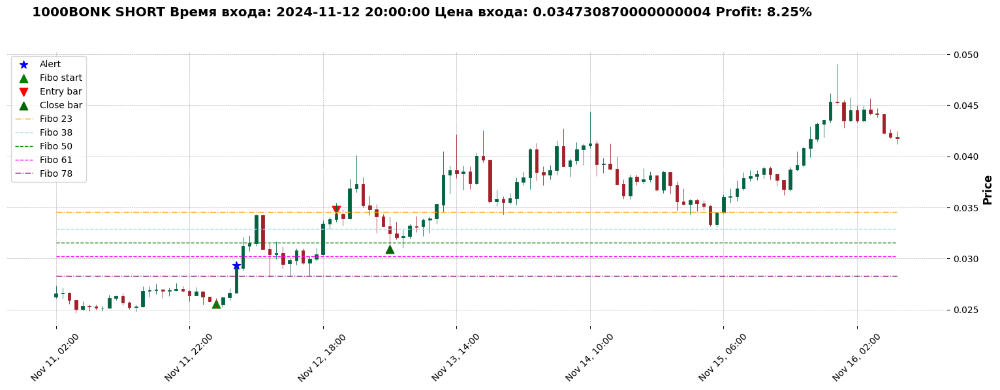

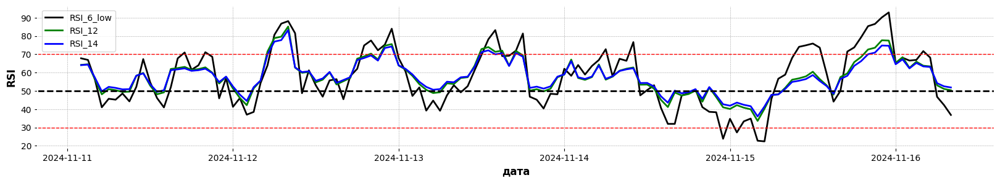

Алерт 2024-11-12 05:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
Время и цена алерта: 2024-11-13 12:00:00 0.038222
Фибо достигнуто.


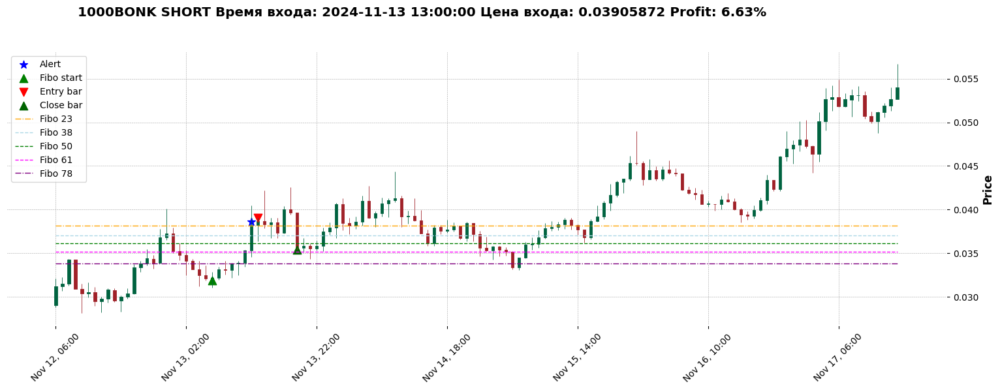

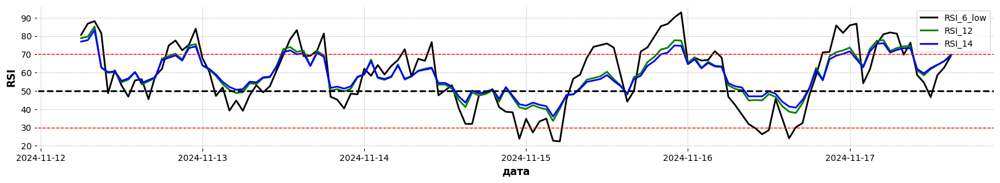

Алерт 2024-11-13 12:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
























На баре 8034 в 2024-11-15 19:00:00 с ценой закр 0.041702 нет дивергенции и обновления максимумов
На баре 8035 в 2024-11-15 20:00:00 с ценой закр 0.043161 нет дивергенции и обновления максимумов
На баре 8036 в 2024-11-15 21:00:00 с ценой закр 0.043535 нет дивергенции и обновления максимумов
На баре 8037 в 2024-11-15 22:00:00 с ценой закр 0.045327 нет дивергенции и обновления максимумов




















На баре 8035 в 2024-11-15 20:00:00 с ценой закр 0.043161 нет дивергенции и обновления максимумов
Время и цена алерта: 2024-11-15 19:00:00 0.041702
Фибо достигнуто.


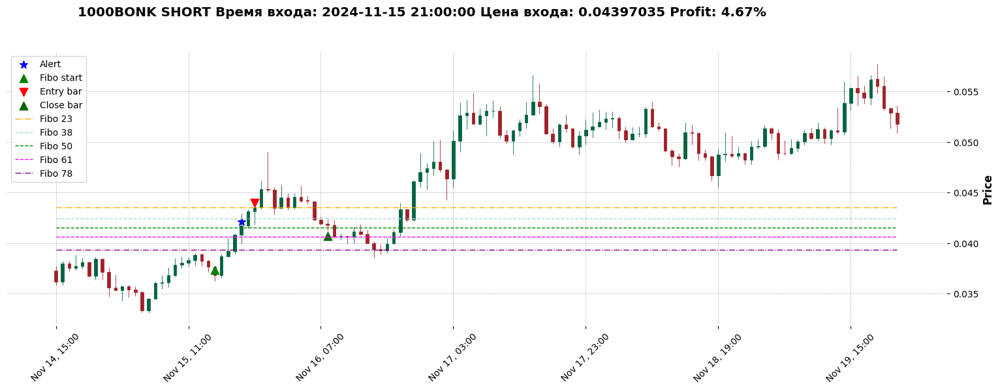

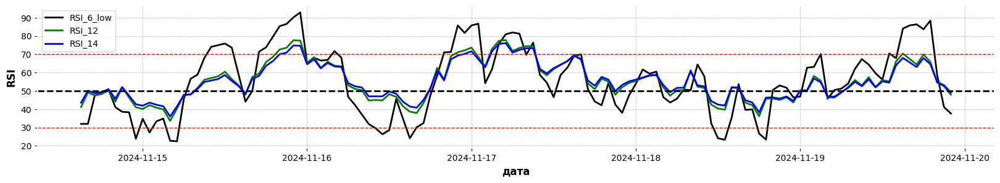

Алерт 2024-11-15 19:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
Время и цена алерта: 2024-11-16 22:00:00 0.046999
Пересечение RSI 12


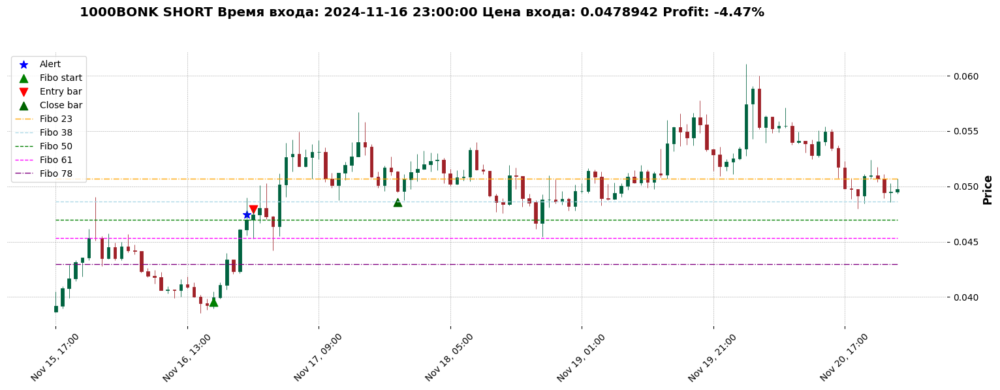

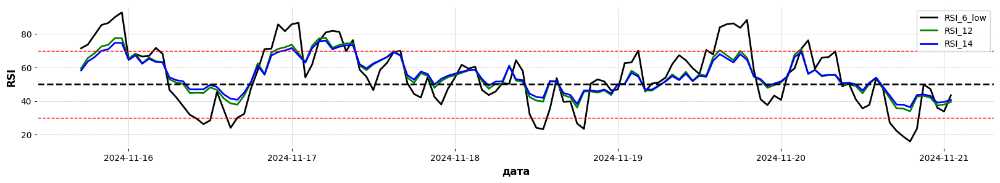

Алерт 2024-11-16 22:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 8126 в 2024-11-19 15:00:00 с ценой закр 0.055359 нет дивергенции и обновления максимумов


Время и цена алерта: 2024-11-19 14:00:00 0.053852
Фибо достигнуто.


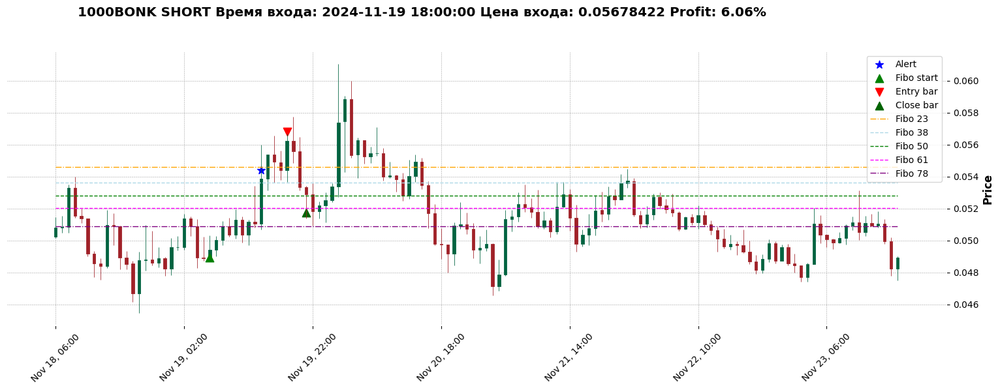

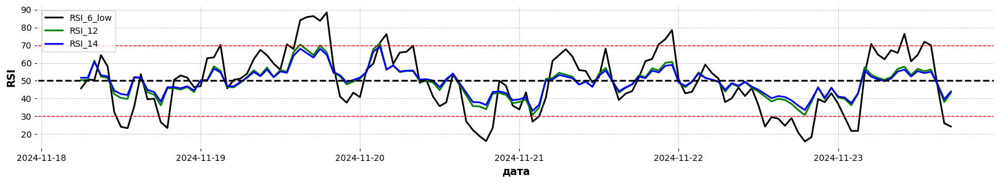

Алерт 2024-11-19 14:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
Время и цена алерта: 2024-11-20 02:00:00 0.057383
Фибо достигнуто.


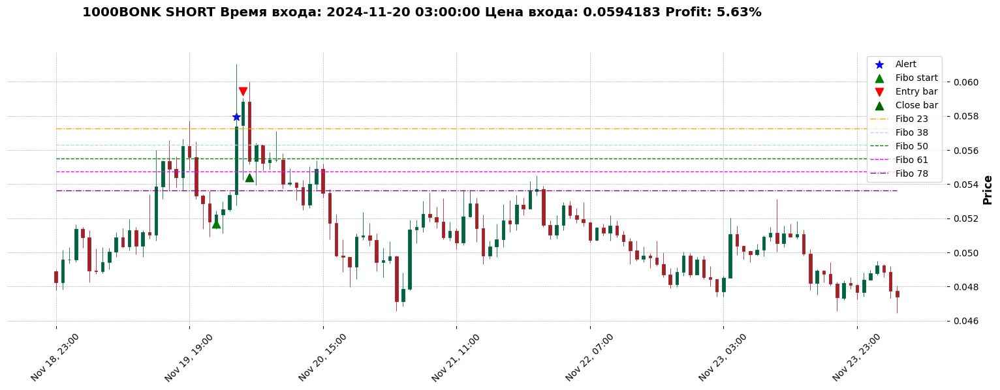

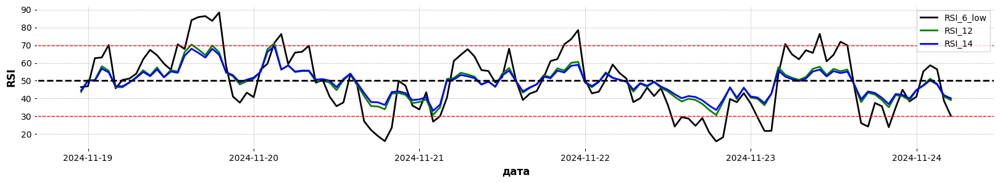

Алерт 2024-11-20 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!








Время и цена алерта: 2024-11-27 15:00:00 0.044625
Фибо достигнуто.


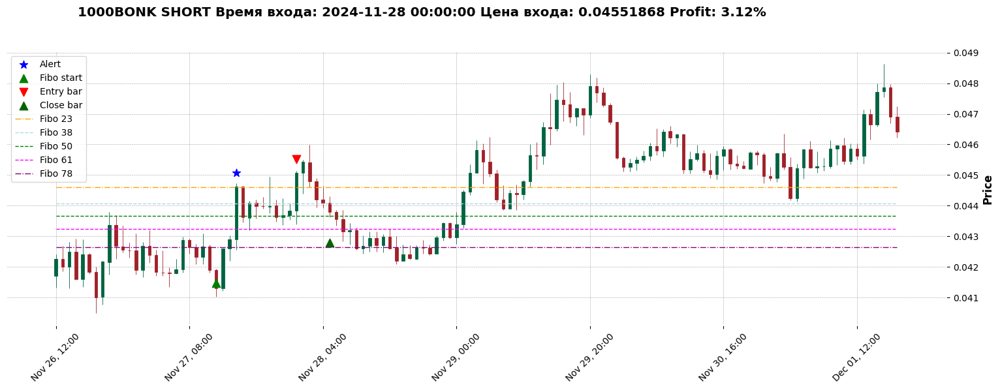

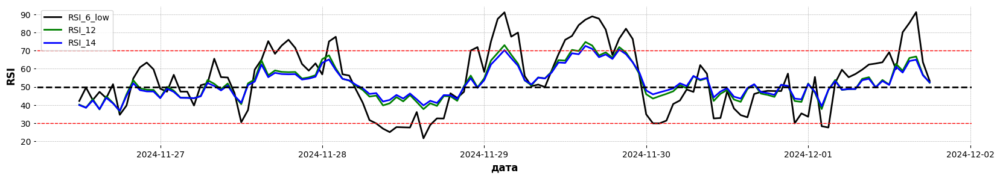

Алерт 2024-11-27 15:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 8354 в 2024-11-29 03:00:00 с ценой закр 0.045825 нет дивергенции и обновления максимумов









Время и цена алерта: 2024-11-29 02:00:00 0.045076
Фибо достигнуто.


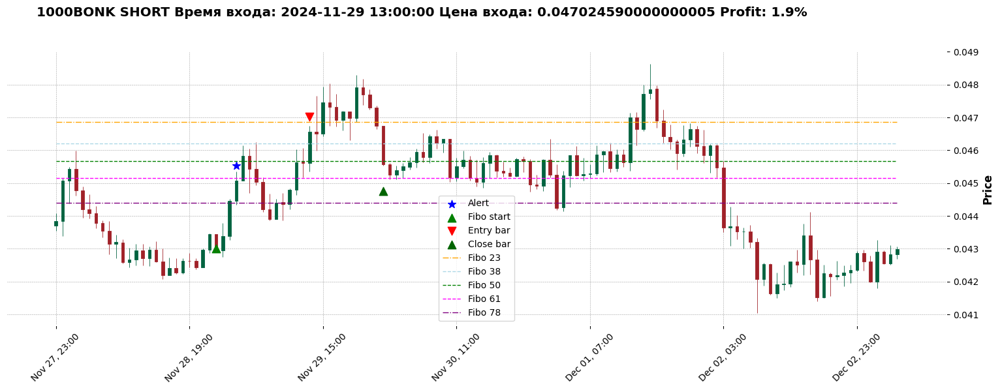

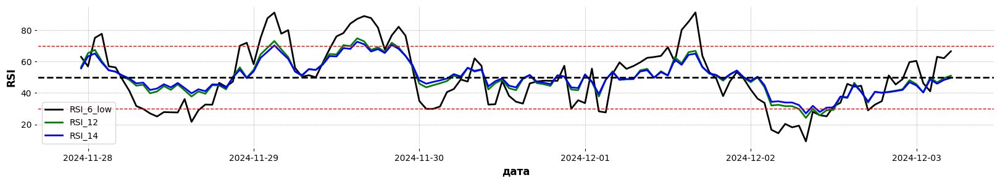

Алерт 2024-11-29 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!

На баре 8414 в 2024-12-01 15:00:00 с ценой закр 0.047722 нет дивергенции и обновления максимумов
На баре 8415 в 2024-12-01 16:00:00 с ценой закр 0.047863 нет дивергенции и обновления максимумов





















Недостаточный потенциал отката: 4.0%















































На баре 8509 в 2024-12-05 14:00:00 с ценой закр 0.043678 нет дивергенции и обновления максимумов









Время и цена алерта: 2024-12-05 13:00:00 0.043288
Фибо достигнуто.


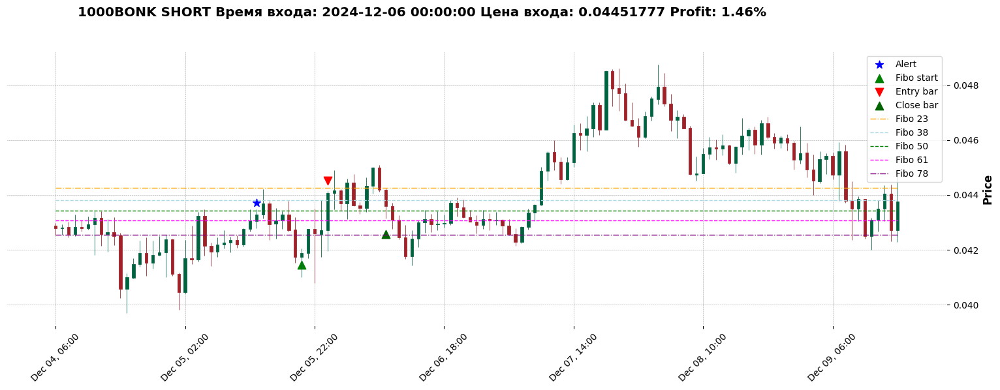

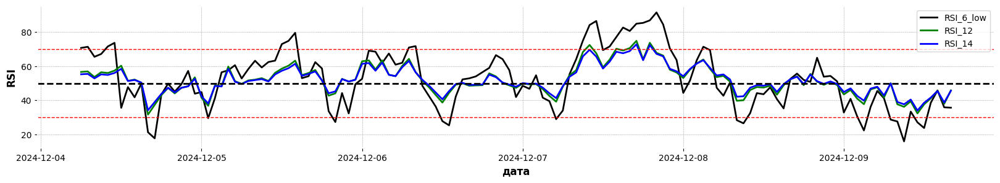

Алерт 2024-12-05 13:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 8553 в 2024-12-07 10:00:00 с ценой закр 0.045552 нет дивергенции и обновления максимумов



Время и цена алерта: 2024-12-07 09:00:00 0.044874
Фибо достигнуто.


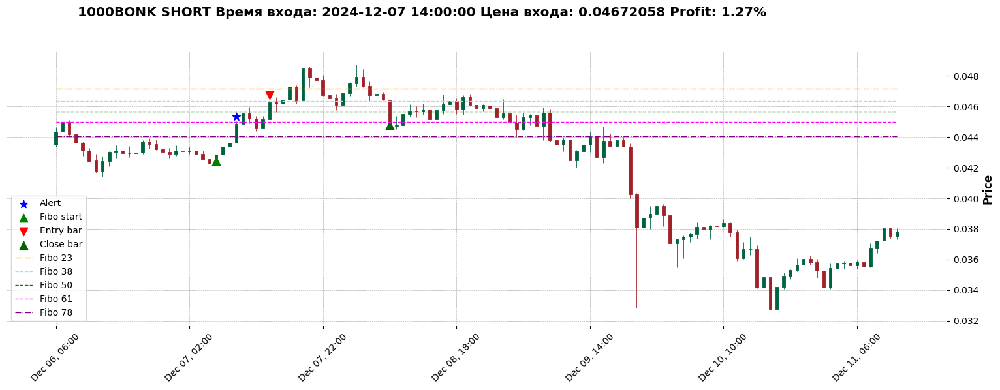

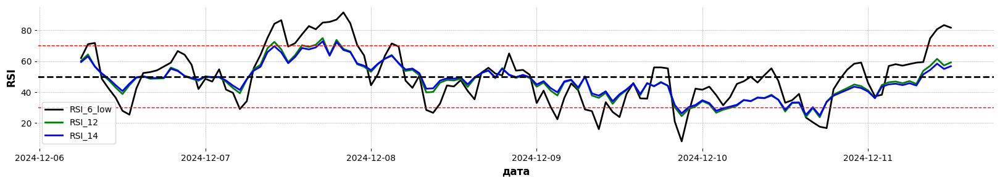

Алерт 2024-12-07 09:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!


На баре 8652 в 2024-12-11 13:00:00 с ценой закр 0.038167 нет дивергенции и обновления максимумов
Время и цена алерта: 2024-12-11 10:00:00 0.03803
Пересечение RSI 12


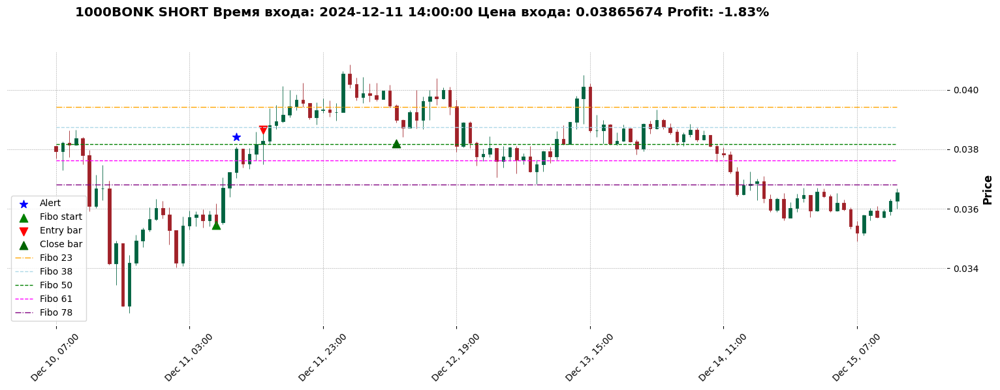

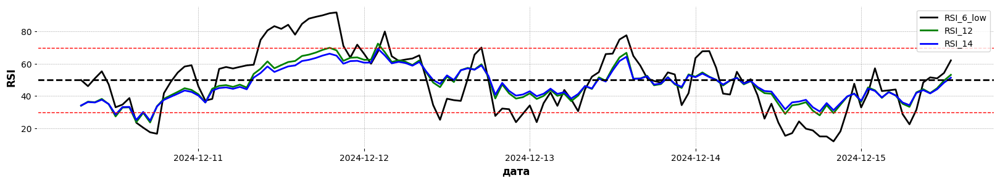

Алерт 2024-12-11 10:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!







На баре 8759 в 2024-12-16 00:00:00 с ценой закр 0.037478 нет дивергенции и обновления максимумов
На баре 8760 в 2024-12-16 01:00:00 с ценой закр 0.037653 нет дивергенции и обновления максимумов















На баре 8760 в 2024-12-16 01:00:00 с ценой закр 0.037653 нет дивергенции и обновления максимумов




















Время и цена алерта: 2024-12-16 00:00:00 0.037478
Фибо достигнуто.


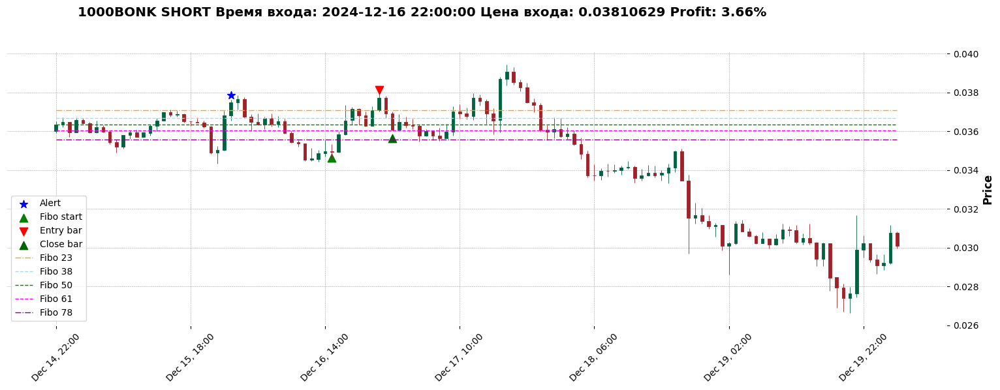

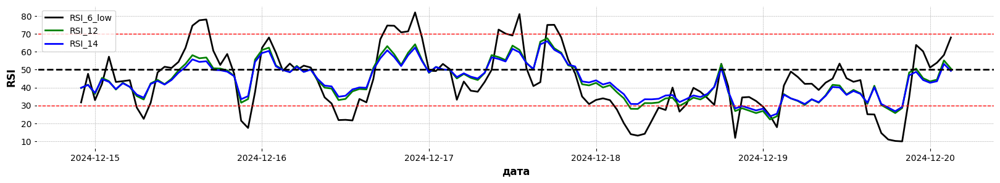

Алерт 2024-12-16 00:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 8800 в 2024-12-17 17:00:00 с ценой закр 0.039066 нет дивергенции и обновления максимумов























































Время и цена алерта: 2024-12-20 21:00:00 0.034462
Пересечение RSI 12


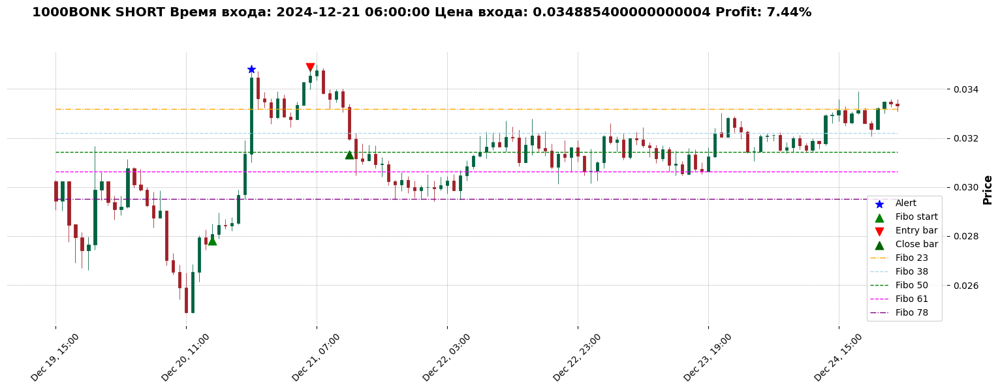

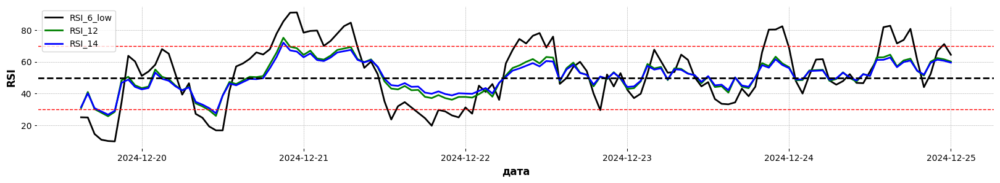

Алерт 2024-12-20 21:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!














Недостаточный потенциал отката: 3.8%
Недостаточный потенциал отката: 3.8%
На баре 8966 в 2024-12-24 15:00:00 с ценой закр 0.033128 нет дивергенции и обновления максимумов


Время и цена алерта: 2024-12-23 22:00:00 0.032813
Фибо достигнуто.


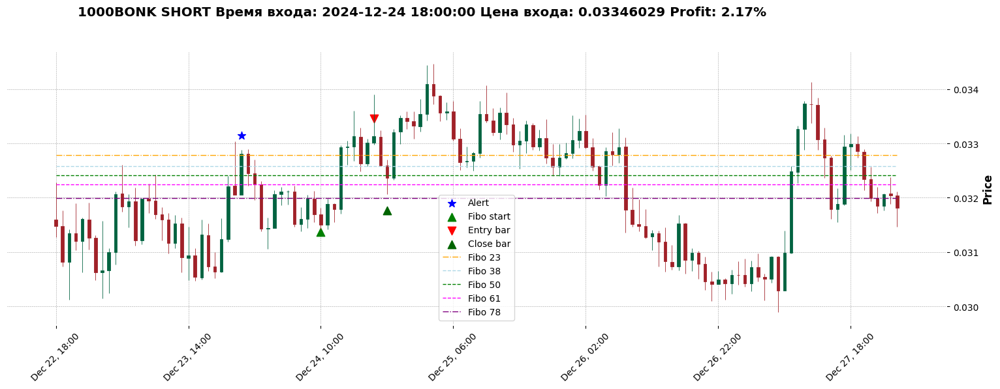

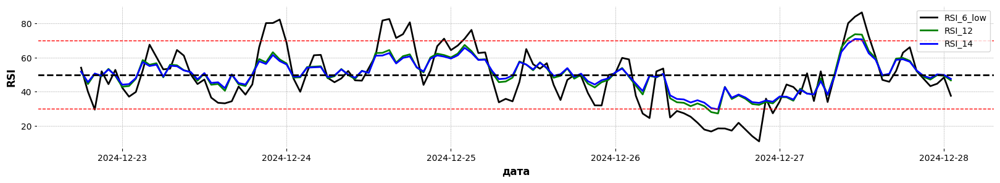

Алерт 2024-12-23 22:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 9033 в 2024-12-27 10:00:00 с ценой закр 0.033264 нет дивергенции и обновления максимумов
На баре 9034 в 2024-12-27 11:00:00 с ценой закр 0.03373 нет дивергенции и обновления максимумов






















Время и цена алерта: 2024-12-27 10:00:00 0.033264
Фибо достигнуто.


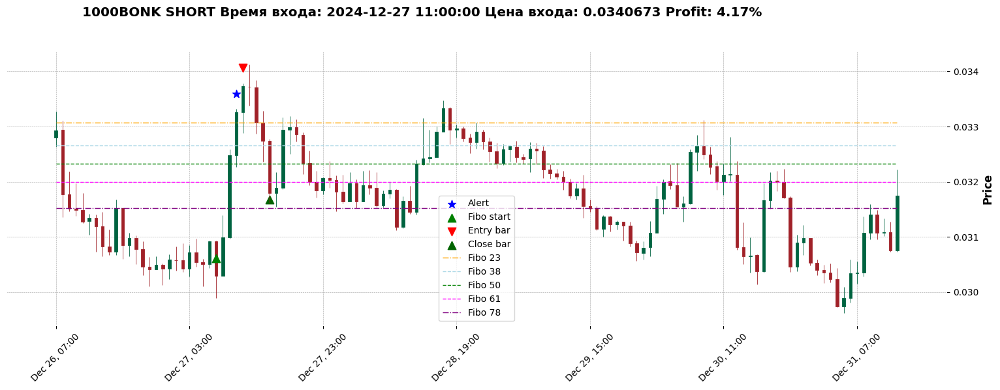

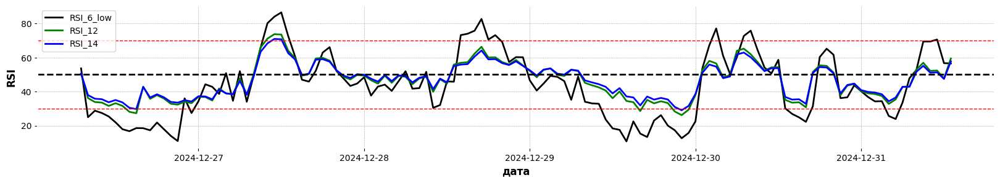

Алерт 2024-12-27 10:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!

















































На баре 9171 в 2025-01-02 04:00:00 с ценой закр 0.030932 нет дивергенции и обновления максимумов

На баре 9173 в 2025-01-02 06:00:00 с ценой закр 0.031261 нет дивергенции и обновления максимумов
На баре 9174 в 2025-01-02 07:00:00 с ценой закр 0.031568 нет дивергенции и обновления максимумов
На баре 9175 в 2025-01-02 08:00:00 с ценой закр 0.032281 нет дивергенции и обновления максимумов



Время и цена алерта: 2025-01-02 02:00:00 0.030646
Фибо достигнуто.


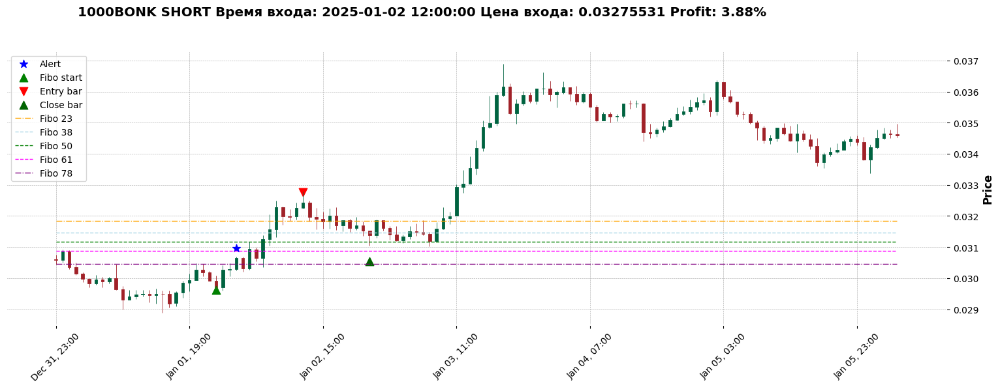

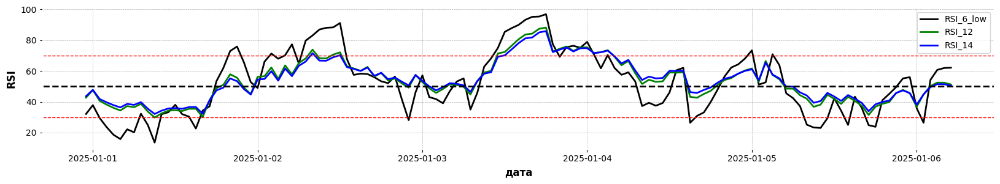

Алерт 2025-01-02 02:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 9203 в 2025-01-03 12:00:00 с ценой закр 0.033036 нет дивергенции и обновления максимумов
На баре 9204 в 2025-01-03 13:00:00 с ценой закр 0.033536 нет дивергенции и обновления максимумов
На баре 9205 в 2025-01-03 14:00:00 с ценой закр 0.034189 нет дивергенции и обновления максимумов
На баре 9206 в 2025-01-03 15:00:00 с ценой закр 0.034852 нет дивергенции и обновления максимумов
На баре 9207 в 2025-01-03 16:00:00 с ценой закр 0.034989 нет дивергенции и обновления максимумов
Время и цена алерта: 2025-01-03 11:00:00 0.032933
Пересечение RSI 12


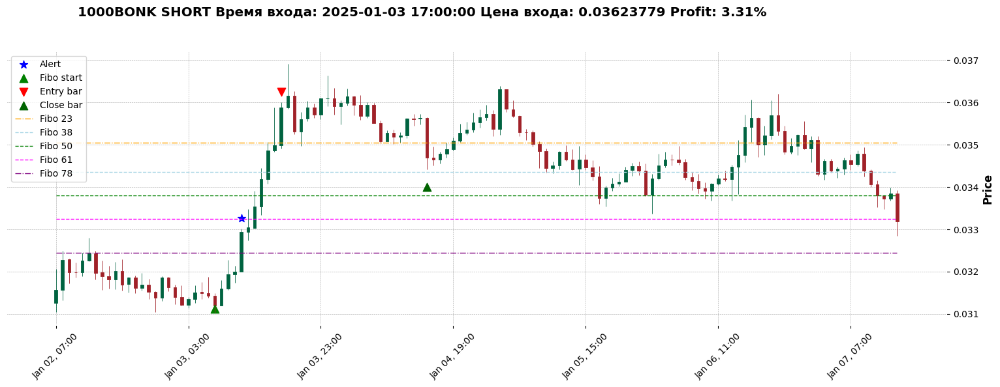

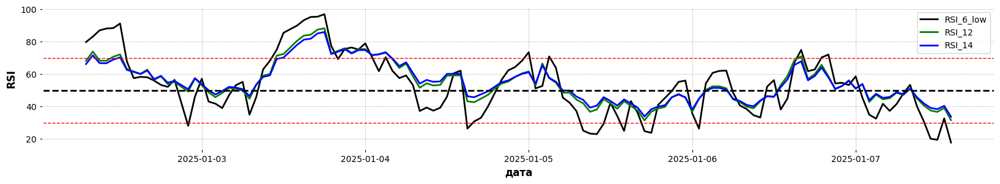

Алерт 2025-01-03 11:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 9279 в 2025-01-06 16:00:00 с ценой закр 0.035624 нет дивергенции и обновления максимумов


Время и цена алерта: 2025-01-06 15:00:00 0.035411
Фибо достигнуто.


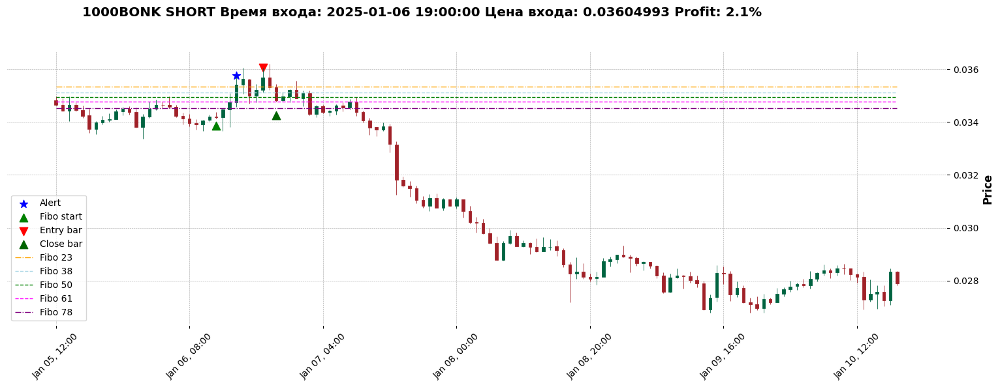

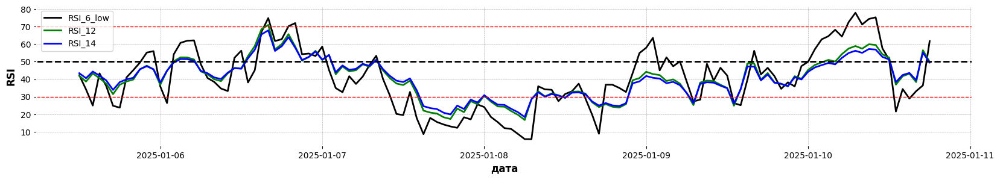

Алерт 2025-01-06 15:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 9404 в 2025-01-11 21:00:00 с ценой закр 0.028859 нет дивергенции и обновления максимумов







































































На баре 9493 в 2025-01-15 14:00:00 с ценой закр 0.028254 нет дивергенции и обновления максимумов
На баре 9494 в 2025-01-15 15:00:00 с ценой закр 0.028304 нет дивергенции и обновления максимумов
На баре 9495 в 2025-01-15 16:00:00 с ценой закр 0.028439 нет дивергенции и обновления максимумов

На баре 9497 в 2025-01-15 18:00:00 с ценой закр 0.028863 нет дивергенции и обновления максимумов
На баре 9498 в 2025-01-15 19:00:00 с ценой закр 0.029017 нет дивергенции и обновления максимумов


Время и цена алерта: 2025-01-15 13:00:00 0.028117
Фибо достигнуто.


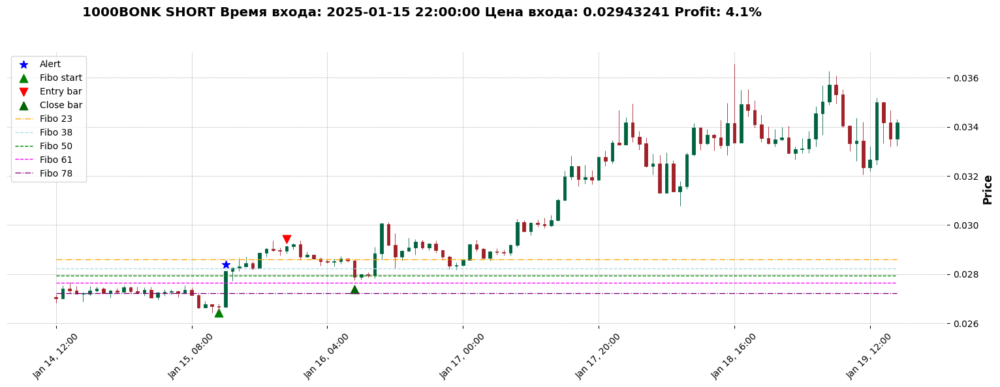

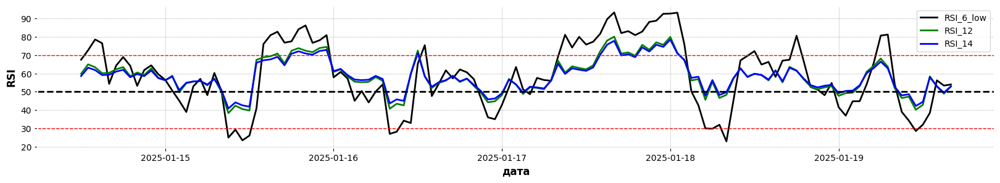

Алерт 2025-01-15 13:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!



















Недостаточный потенциал отката: 3.7%








Недостаточный потенциал отката: 3.9%
На баре 9541 в 2025-01-17 14:00:00 с ценой закр 0.031016 нет дивергенции и обновления максимумов
На баре 9542 в 2025-01-17 15:00:00 с ценой закр 0.031963 нет дивергенции и обновления максимумов
На баре 9543 в 2025-01-17 16:00:00 с ценой закр 0.032404 нет дивергенции и обновления максимумов



Время и цена алерта: 2025-01-17 08:00:00 0.030121
Фибо достигнуто.


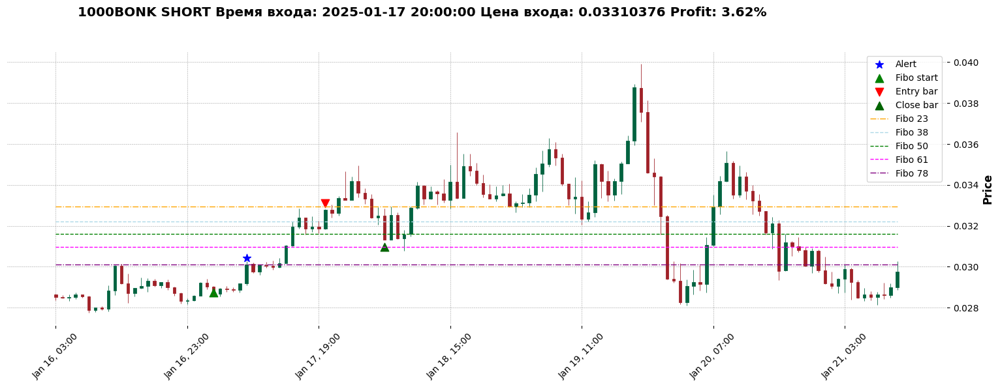

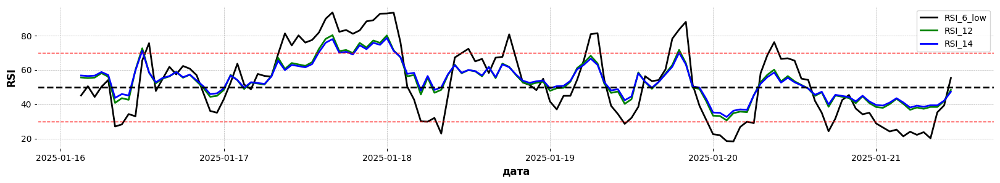

Алерт 2025-01-17 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!











Время и цена алерта: 2025-01-19 06:00:00 0.035726
Фибо достигнуто.


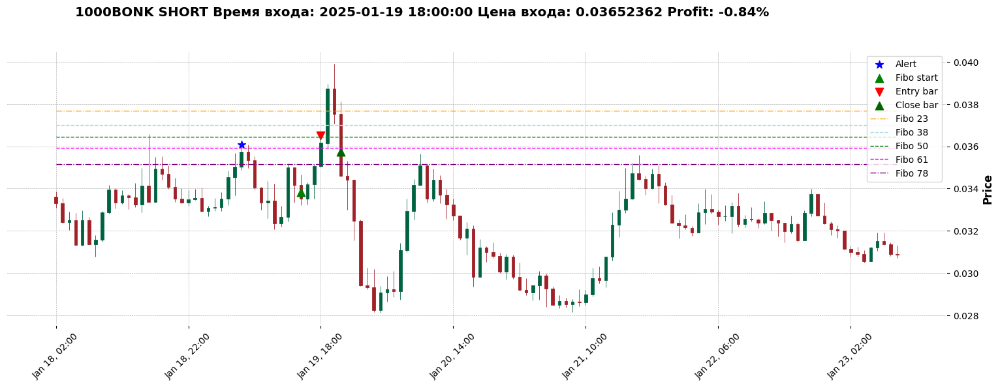

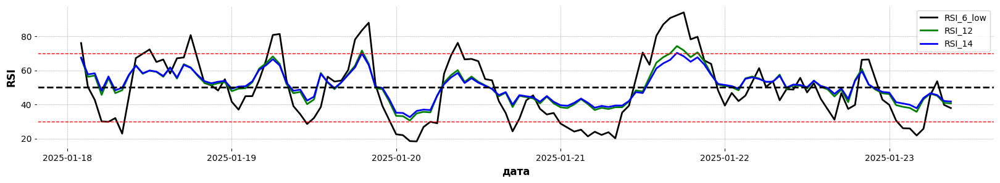

Алерт 2025-01-19 06:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 9639 в 2025-01-21 16:00:00 с ценой закр 0.033522 нет дивергенции и обновления максимумов
На баре 9640 в 2025-01-21 17:00:00 с ценой закр 0.034719 нет дивергенции и обновления максимумов






















Время и цена алерта: 2025-01-21 16:00:00 0.033522
Фибо достигнуто.


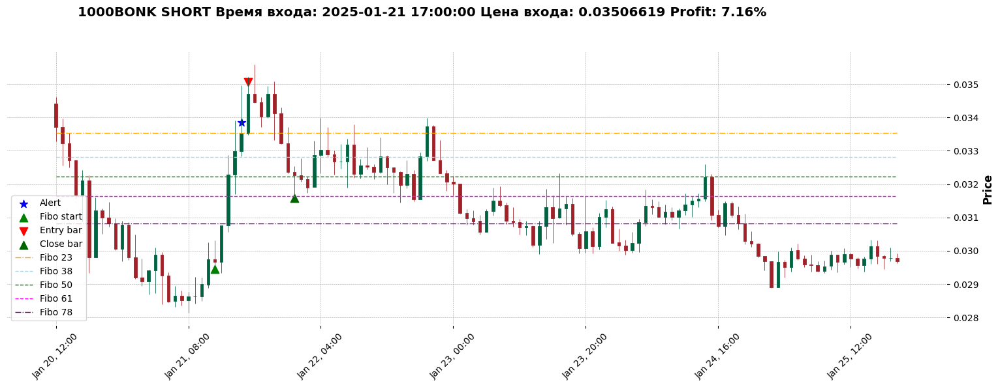

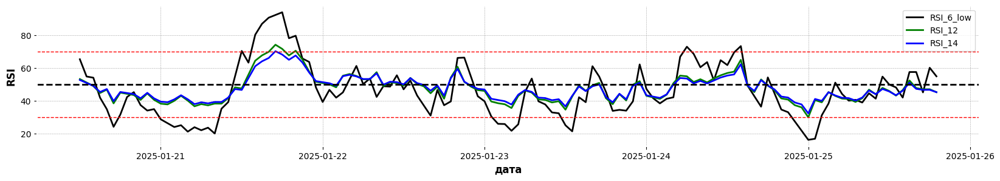

Алерт 2025-01-21 16:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!








































































На баре 10045 в 2025-02-07 14:00:00 с ценой закр 0.018018 нет дивергенции и обновления максимумов
















































На баре 10074 в 2025-02-08 19:00:00 с ценой закр 0.017571 нет дивергенции и обновления максимумов
Недостаточный потенциал отката: 3.4%
Недостаточный потенциал отката: 3.8%

Недостаточный потенциал отката: 4.0%
Время и цена алерта: 2025-02-08 17:00:00 0.017543
Фибо достигнуто.


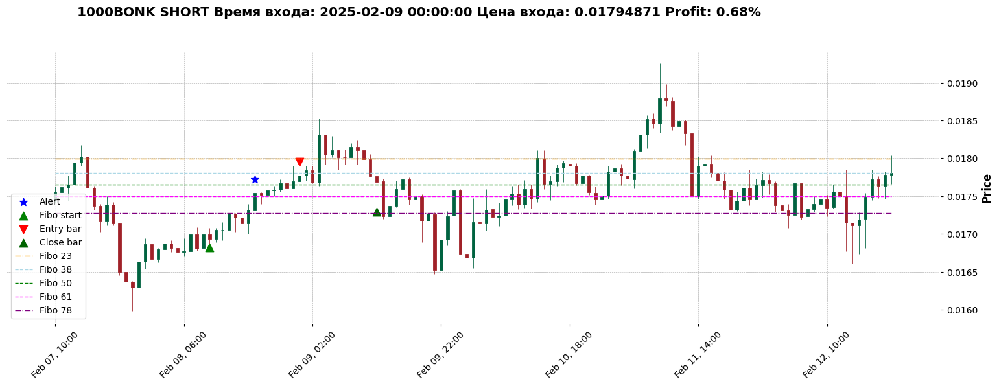

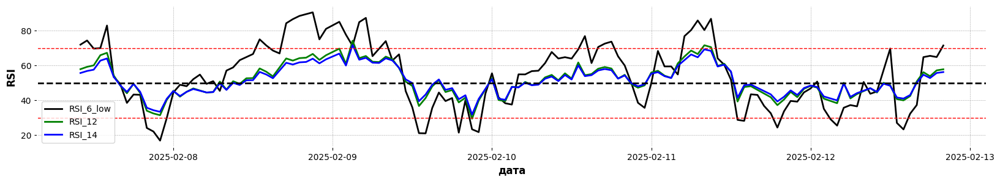

Алерт 2025-02-08 17:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!














Недостаточный потенциал отката: 3.2%
На баре 10132 в 2025-02-11 05:00:00 с ценой закр 0.01831 нет дивергенции и обновления максимумов
На баре 10133 в 2025-02-11 06:00:00 с ценой закр 0.01852 нет дивергенции и обновления максимумов

На баре 10135 в 2025-02-11 08:00:00 с ценой закр 0.018792 нет дивергенции и обновления максимумов





На баре 10133 в 2025-02-11 06:00:00 с ценой закр 0.01852 нет дивергенции и обновления максимумов

На баре 10135 в 2025-02-11 08:00:00 с ценой закр 0.018792 нет дивергенции и обновления максимумов






















На баре 10135 в 2025-02-11 08:00:00 с ценой закр 0.018792 нет дивергенции и обновления максимумов














































На баре 10172 в 2025-02-12 21:00:00 с ценой закр 0.017943 нет дивергенции и обновления максимумов
На баре 10173 в 2025-02-12 22:00:00 с ценой закр 0.01822 нет дивергенции и обновления максимумов


На баре 10176 в 2025-02-13 01:00

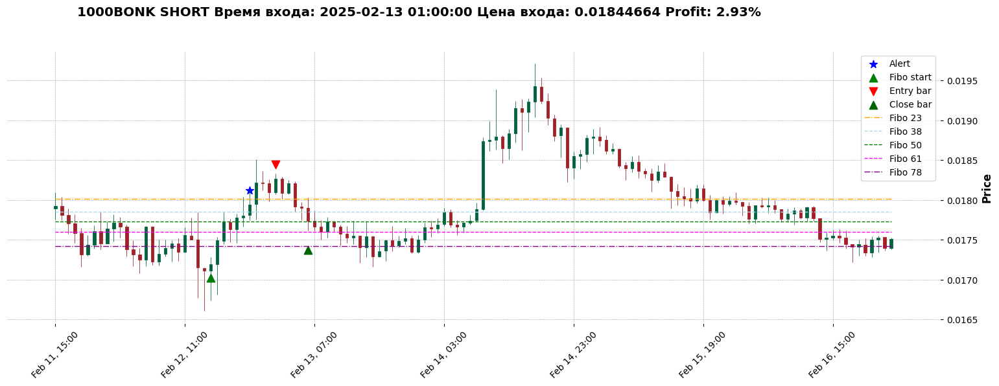

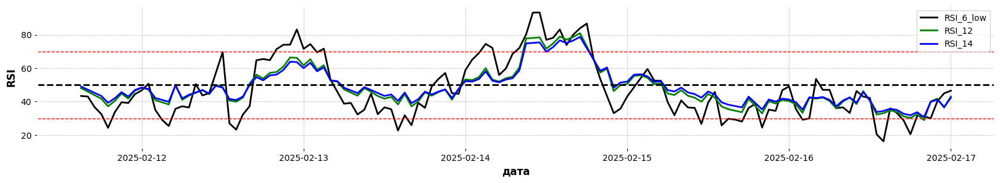

Алерт 2025-02-12 21:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 10208 в 2025-02-14 09:00:00 с ценой закр 0.018741 нет дивергенции и обновления максимумов
На баре 10209 в 2025-02-14 10:00:00 с ценой закр 0.018757 нет дивергенции и обновления максимумов
На баре 10210 в 2025-02-14 11:00:00 с ценой закр 0.018793 нет дивергенции и обновления максимумов

На баре 10212 в 2025-02-14 13:00:00 с ценой закр 0.018834 нет дивергенции и обновления максимумов
На баре 10213 в 2025-02-14 14:00:00 с ценой закр 0.01915 нет дивергенции и обновления максимумов

Время и цена алерта: 2025-02-14 08:00:00 0.017886
Фибо достигнуто.


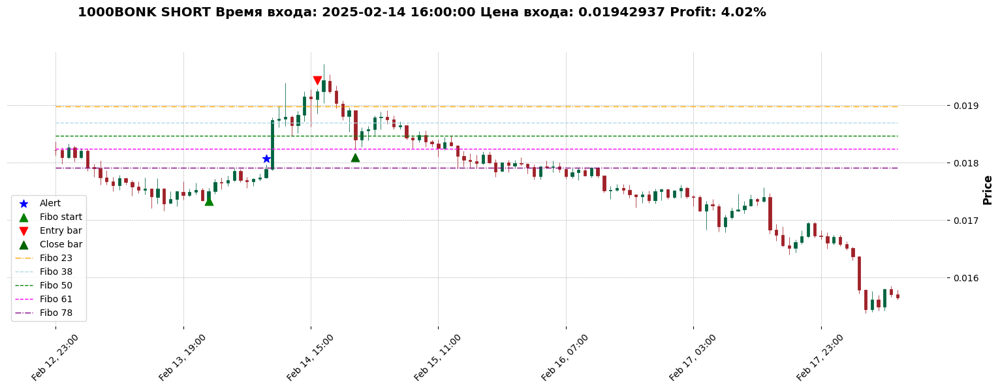

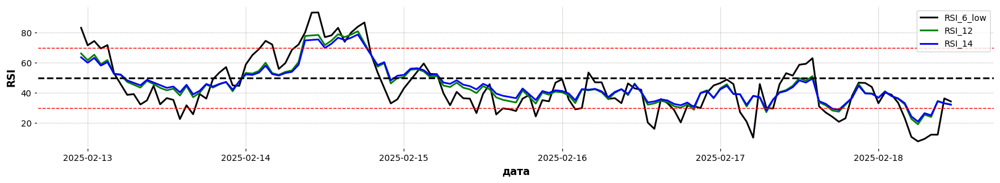

Алерт 2025-02-14 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!





























Недостаточный потенциал отката: 0.6%
Недостаточный потенциал отката: 1.2%

На баре 10375 в 2025-02-21 08:00:00 с ценой закр 0.016318 нет дивергенции и обновления максимумов
На баре 10376 в 2025-02-21 09:00:00 с ценой закр 0.016525 нет дивергенции и обновления максимумов
На баре 10377 в 2025-02-21 10:00:00 с ценой закр 0.016585 нет дивергенции и обновления максимумов

Время и цена алерта: 2025-02-20 23:00:00 0.016038
Фибо достигнуто.


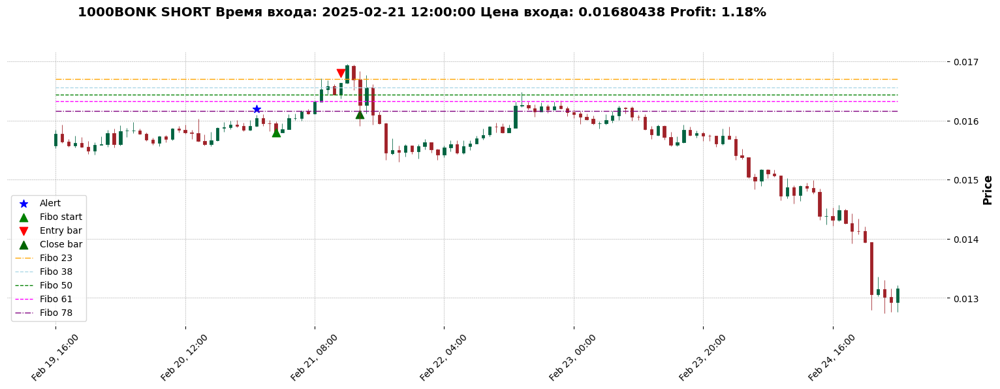

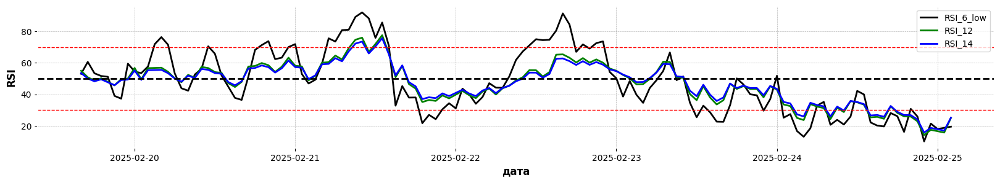

Алерт 2025-02-20 23:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!




























Недостаточный потенциал отката: 3.9%
Время и цена алерта: 2025-02-25 21:00:00 0.013514
Фибо достигнуто.


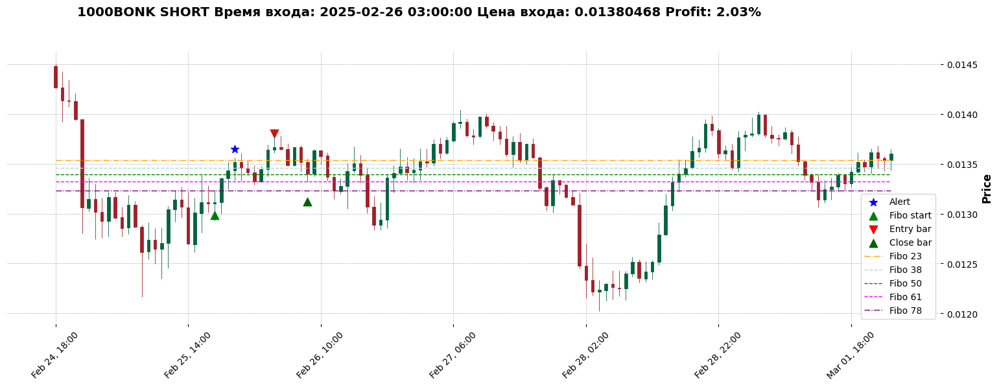

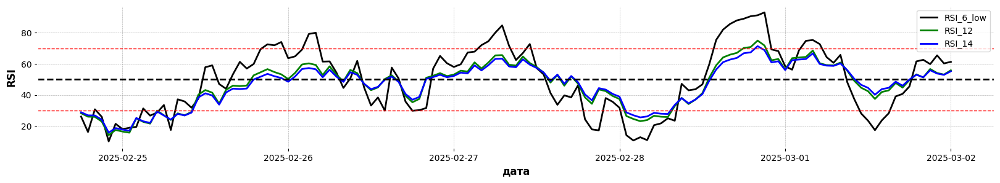

Алерт 2025-02-25 21:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 10518 в 2025-02-27 07:00:00 с ценой закр 0.013917 нет дивергенции и обновления максимумов


Время и цена алерта: 2025-02-27 06:00:00 0.01391
Пересечение RSI 12


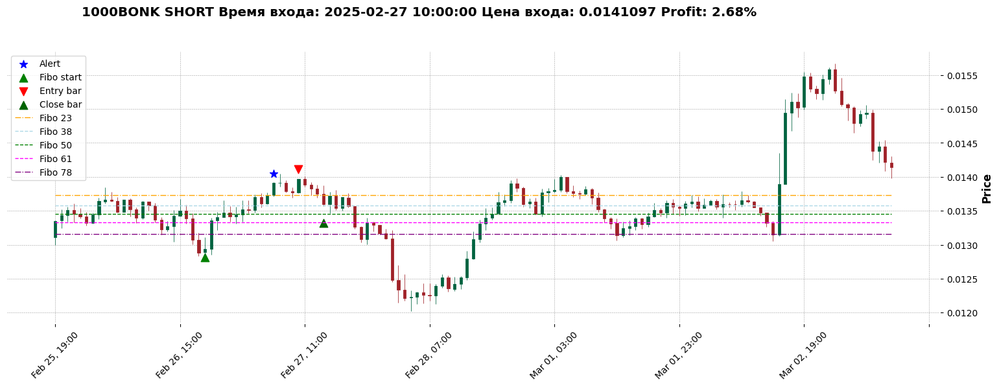

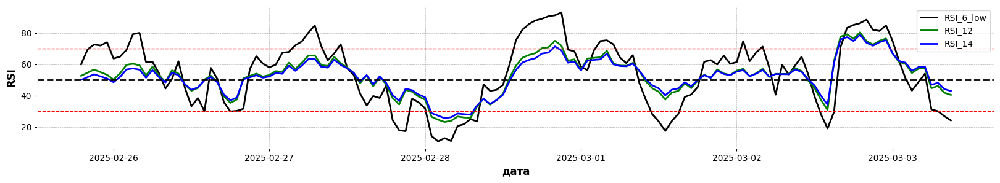

Алерт 2025-02-27 06:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 10599 в 2025-03-02 16:00:00 с ценой закр 0.014947 нет дивергенции и обновления максимумов
На баре 10600 в 2025-03-02 17:00:00 с ценой закр 0.015108 нет дивергенции и обновления максимумов

На баре 10602 в 2025-03-02 19:00:00 с ценой закр 0.015482 нет дивергенции и обновления максимумов



Время и цена алерта: 2025-03-02 15:00:00 0.013897
Фибо достигнуто.


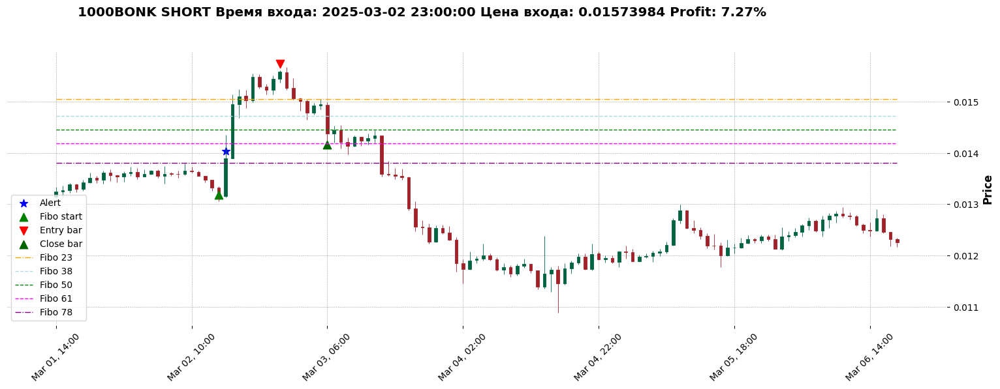

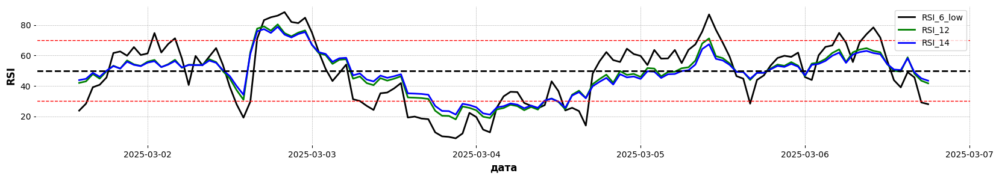

Алерт 2025-03-02 15:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!
На баре 10665 в 2025-03-05 10:00:00 с ценой закр 0.012873 нет дивергенции и обновления максимумов


















































Время и цена алерта: 2025-03-07 14:00:00 0.012748
Фибо достигнуто.


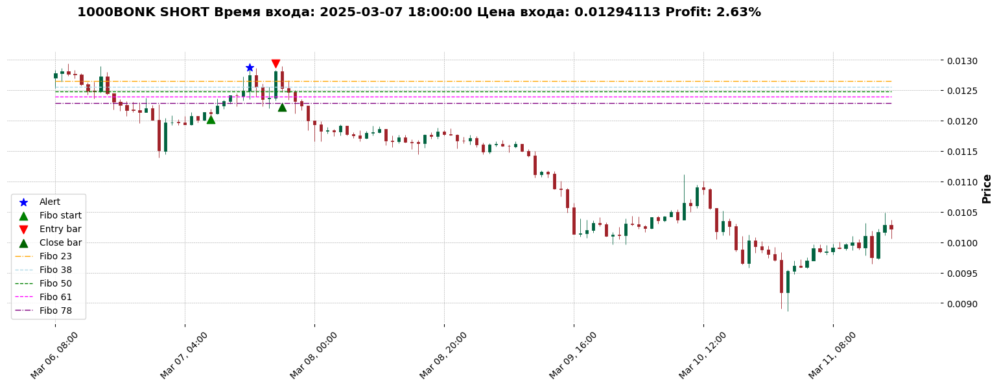

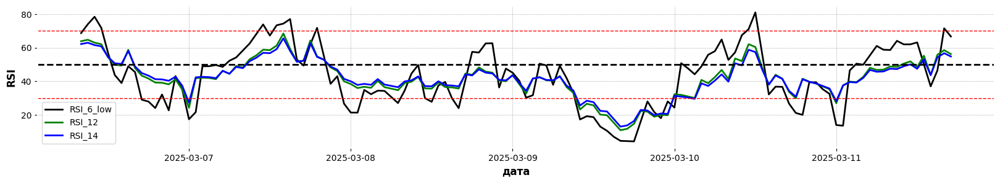

Алерт 2025-03-07 14:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!

На баре 10817 в 2025-03-11 18:00:00 с ценой закр 0.010648 нет дивергенции и обновления максимумов
На баре 10818 в 2025-03-11 19:00:00 с ценой закр 0.010782 нет дивергенции и обновления максимумов





















На баре 10818 в 2025-03-11 19:00:00 с ценой закр 0.010782 нет дивергенции и обновления максимумов








































































На баре 10953 в 2025-03-17 10:00:00 с ценой закр 0.011071 нет дивергенции и обновления максимумов






Время и цена алерта: 2025-03-17 08:00:00 0.011058
Фибо достигнуто.


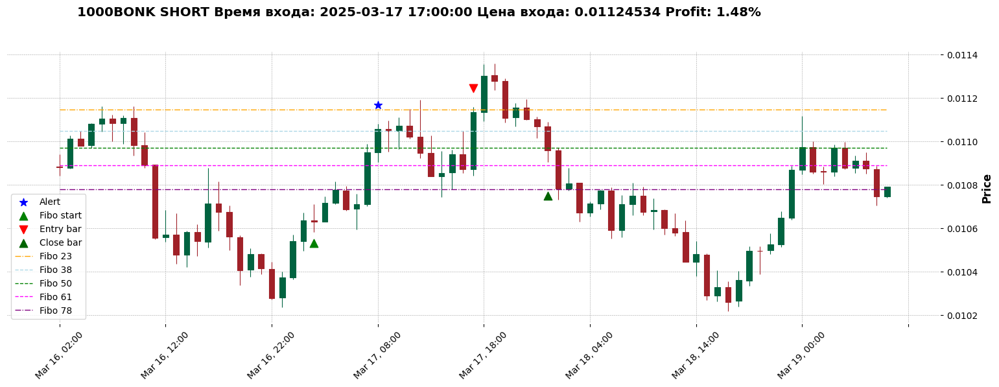

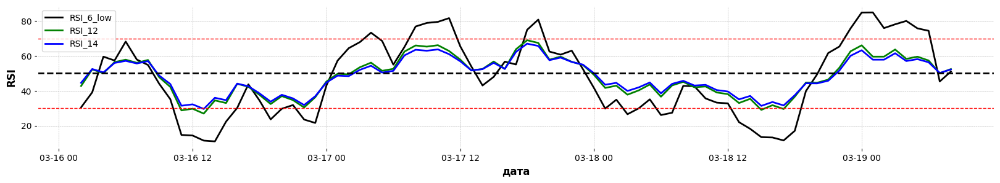

Алерт 2025-03-17 08:00:00 ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!










KeyError: 11000

In [17]:
# торгуемая монета
coin_name = '1000BONK'

# индексы баров, где CCI_24
# и свеча бычья (чтобы не входить на медвежьих барах с выслким индикатором)
alert_idx = bonk.index[(bonk['CCI_24']>=150) & (bonk['body_len_percent']>0)].tolist()

# минимально необходимый потенциал отката в % - фильтр боковиков
min_potencial = 4

# сколько отслеживаем сигнал в часах (барах) до появления дивергенции
divergence_detection_time = 24

# сколько часов дается сделке на закрытие после входа (за сколько цена должна достичь фибо)
fibo_search_time = 96

# МПУ при котором перестраиваем фибо от цены первого входа и выходим при 50% (безубыток)
mpu_change_fibo = 30

# коэфф МПУ к потенц фибо от 1го входа при котором перестраиваем фибо от цены первого входа и выходим при 50% (безубыток)
coef_change_fibo = 2

# потенциал фибо от 1го входа при котором начинаем применять coef_change_fibo (%)
fibo_potencial_change_fibo = 20 # было 8

# период RSI для определения выхода (большой МПУ - БОЛЬШОЙ RSI)
rsi_period_close = 12

# текущий индекс алерта
idx_in_deal = 0
ind_close = 0

# уровень фильтра на вход по хаям в долях (%)
entry_filter_high_level = 0.2

for idx in alert_idx[:]: # индексы алертов
  # если существует fibo_start_price для дааного бара (индекса), т е не равно нулю, т к заменяем nan на 0 и
  # если текущий бар алерта idx уже не был в сделке (idx > idx_in_deal), то
  if (bonk.at[idx, 'fibo_start_price'] != 0) and (idx > ind_close):
    # признак наличия входа
    is_entry_exist = False

    # alert_close_price - цена закрытия бара алерта
    alert_close_price = bonk.at[idx, 'close']
    # alert_high_price - максимум цены бара алерта
    alert_high_price = bonk.at[idx, 'high']
    # alert_fibo_potencial - потпенциал отката: расстояние в % от цены закрытия бара алерта до начала фибо (сверху вниз)
    alert_fibo_potencial = bonk.at[idx, 'fibo_potencial']
    # индекс бара начала расчета фибо (0 фибо)
    ind_rsi_fibo_start = bonk.at[idx, 'ind_rsi_fibo_start']
    # цена закр бара начала расчета фибо (0 фибо)
    #fibo_start_price = max(bonk.at[ind_rsi_fibo_start, 'close'], bonk.at[ind_rsi_fibo_start, 'open']) - перезапись ниже
    # значение CCI_24 на баре алерта (для поиска дивергенции)
    alert_cci = bonk.at[idx, 'CCI_24']
    # ищем дивергенцию в течение t часов
    for idx_search in range(idx+1, idx+divergence_detection_time+1): # индекс бара потенциального входа (дивергенции)

      # дата алерта - по умолчанию ставим nan для НЕ отработавшего алерта
      # если сделка по данному алерту будет открыта, то он перезапишется как дата
      alert_date = np.nan

      # проверяем, что цена текущего бара не ниже макс цены закрытия среди всех цен закрытия после начала фибо (не только после алерта!)
      # т е , что обновился максимум не только по сравнению с ценой алерта
      if bonk.at[idx_search, 'close'] > bonk.loc[ind_rsi_fibo_start:idx_search-1]['close'].max():

        # если цена закрытия след бара выше цены закрытия бара алерта и
        # CCI_24 след бара ниже CCI_24 бара алерта и
        # свеча растущая (длина тела бара > 0 ), то
        # есть дивергенция - есть точка входа
        if (bonk.at[idx_search, 'close'] > alert_close_price) and (bonk.at[idx_search, 'CCI_24'] <= alert_cci) and (bonk.at[idx_search, 'body_len_percent'] > 0):


          # entry_close_price - цена закрытия бара дивергенции
          entry_close_price = bonk.at[idx_search, 'close']
          # entry_high_price - максимум цены бара дивергенции
          entry_high_price = bonk.at[idx_search, 'high']
          # entry_fibo_potencial - потпенциал отката: расстояние в % от цены закрытия бара дивергенции до начала фибо (сверху вниз)
          entry_fibo_potencial = bonk.at[idx_search, 'fibo_potencial']
          #------------------------------------------------------ПЕРЕЗАПИСЬ НАЧАЛА ФИБО, ЕСЛИ ПОСЛЕ АЛЕРТА БЫЛО НОВОЕ ПЕРЕСЕЧЕНИЕ RSI -----------------------
          # индекс бара начала расчета фибо (0 фибо)
          ind_rsi_fibo_start = bonk.at[idx_search, 'ind_rsi_fibo_start']
          # цена закр бара начала расчета фибо (0 фибо)
          fibo_start_price = max(bonk.at[ind_rsi_fibo_start, 'close'], bonk.at[ind_rsi_fibo_start, 'open'])

          # если потенциал отката превышает минимальный необходимый
          if entry_fibo_potencial > min_potencial:

            # idx_search - индекс бара входа (дивергенции)

            # признак наличия входа
            is_entry_exist = True

            # temp_bonk - временный датафрейм дляотрисовки графика (перезапись каждую итерацию)
            temp_bonk = bonk.iloc[bonk.at[idx, 'ind_rsi_fibo_start']-24:idx+100].copy()
            temp_bonk.set_index('date_time', inplace=True)

            # Указываем дату и значение для точки - бар алерта
            point_date = bonk.at[idx, 'date_time']  # Например, 6-й день (индекс 5)
            point_value = alert_close_price  # Значение закрытия на этот день
            # Создаем серию с NaN и значением точки
            point_series = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
            # домножаем цену на 1.01 , чтобы было выше на 1% и не перекрывало сам бар
            point_series[point_date] = point_value*1.01  # Устанавливаем значение для нужной даты

            print('Время и цена алерта:', point_date, point_value)

            # Указываем дату и значение для точки - начало фибо
            point_date = bonk.at[bonk.at[idx_search, 'ind_rsi_fibo_start'], 'date_time']  # Например, 6-й день (индекс 5)
            # домножаем цену на 0.99 , чтобы было ниже на 1% и не перекрывало сам бар
            point_value = fibo_start_price*0.99  # цена закр бара начала расчета фибо
            point_series_fibo = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
            point_series_fibo[point_date] = point_value  # Устанавливаем значение для нужной даты

            # Указываем дату и значение для точки - дивергенция и 1й вход в шорт
            point_date = bonk.at[idx_search, 'date_time']  # Например, 6-й день (индекс 5)
            # домножаем цену на 1.01 , чтобы было выше на 1% и не перекрывало сам бар
            point_value = entry_close_price*1.01  # цена закр бара начала расчета фибо
            point_series_entry = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
            point_series_entry[point_date] = point_value  # Устанавливаем значение для нужной даты

            #print('Время и цена входа (дивергенции):', point_date, point_value, 'Потенциал шорта:', entry_fibo_potencial, '%' )
            #print(f"CCI алерта:, {alert_cci.astype(int)}, CCI входа:, {bonk.at[idx_search, 'CCI_24'].astype(int)} ")

            # отрисовываем линию-фильтр
            # линия уровня х% вверх от потенц цены входа - для проверки достижения ее хаем
            #temp_bonk['entry_filter_high'] = entry_close_price * (1 + (entry_fibo_potencial*entry_filter_high_level)/100)
            temp_bonk['entry_filter_high'] = temp_bonk.iloc[:48]['close'].max()

            # было ли пересечение уровня х% от потенциала
            if bonk.loc[idx:idx_search]['high'].max() > entry_close_price * (1 + (entry_fibo_potencial*entry_filter_high_level)/100):
              is_high_filter_crossed = True
            else:
              is_high_filter_crossed = False

            # ------------------------------------------------------------------------- ЗАПИСЬ ТРЕЙДА ---------------------------------------------------------------------------------

            # для каждого из fibo_search_time бара после входа ищем время и цену ближайшего выхода по фибо
            for ind_close in range(idx_search+1, idx_search+fibo_search_time+1): # ind_close инд потенциального закрытия


              #print('LOW AND FIBO PRICE', bonk.loc[ind_close]['low'], fibo_50_price)
              # МПУ - макс хай бара между открытием и закрытием
              mpu = round((bonk.loc[idx_search:ind_close-1]['high'].max() - entry_close_price) / entry_close_price*100, 1) # CHANGE

              # если мпу больше порогового (даже если мпу < потенциала фибо)
              if mpu >= mpu_change_fibo:
                # то также перезаписываем начало фибо на цену 1го входа
                fibo_50_price = (entry_close_price + bonk.loc[idx_search:ind_close-1]['high'].max())/2
              # МПУ в 3 раза больше потенциала фибо
              elif mpu >= (entry_fibo_potencial*3): # БЫЛО ТАК mpu < mpu_change_fibo
                fibo_50_price = (entry_close_price + bonk.loc[idx_search:ind_close-1]['high'].max())/2
               # если МПУ меньше пороового (mpu < mpu_change_fibo)
              else:
                # цена фибо 50: макс цена закрытия баров не включая текущий + цена старта фибо деленные на 2
                fibo_50_price = (bonk.loc[idx_search:ind_close-1]['close'].max() + fibo_start_price)/2
              # если МПУ превышает 20%, то rsi более длинный - 14
              #rsi_period_close_prev = 12 if mpu < 20 else "6_low"
              # если МПУ превышает потенциал фибо в 3 рада, то rsi более короткий - 6, т е у нас неудачная точка входа
              rsi_period_close = "6_low" if (entry_fibo_potencial*3 <= mpu) else 12
              #print('!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')
              #print(entry_fibo_potencial, mpu, rsi_period_close, entry_fibo_potencial*3 < mpu)

              # ----------------------------------------------- если мин цена закрытия след бара пересекала 50 фибо, то вписываем трейд - БЫЛО ЗАКРЫТИЕ ПО ФИБО --------------------
              if bonk.loc[ind_close]['low'] < fibo_50_price:

                # время закрытия по фибо 50
                close_time = bonk.loc[ind_close]['date_time']
                close_price = fibo_50_price

                # МПУ - макс хай бара между открытием и закрытием
                mpu = round((bonk.loc[idx_search:ind_close]['high'].max() - entry_close_price) / entry_close_price*100, 1)
                # МПП - мин лой бара между открытием и закрытием
                mpp = round((entry_close_price - bonk.loc[idx_search:ind_close]['low'].min()) / entry_close_price*100, 1)
                # макс потенциал фибо за время нахождения в сделке в % (не от входа, а от макс закрытия)
                fibo_potencial = round((bonk.loc[idx_search:ind_close-1]['close'].max() - fibo_start_price) / bonk.loc[idx_search:ind_close-1]['close'].max() *100, 1)

                # если мпу не больше порогового, но потенц фибо от начала >=8% и  МПУ> потенциала фибо
                if mpu >= entry_fibo_potencial*3:
                  # макс цена макс бара - верх фибо
                  fibo_end_price = bonk.loc[idx_search:ind_close-1]['high'].max()
                  fibo_start_price = entry_close_price
                  # правило закрытия - начало фибо от 1го входа (при большом МПУ)
                  close_rule = 'mpu_fibo_50'

                elif mpu < mpu_change_fibo:
                  # цена макс закрытия бара - верх фибо
                  fibo_end_price = bonk.loc[idx_search:ind_close-1]['close'].max()
                  # правило закрытия - начало фибо от RSI
                  close_rule = 'fibo_50'

                else:
                  # цена макс закрытия бара - верх фибо
                  fibo_end_price = bonk.loc[idx_search:ind_close-1]['high'].max()
                  fibo_start_price = entry_close_price
                  # правило закрытия - начало фибо от 1го входа (при большом МПУ)
                  close_rule = 'mpu_fibo_50'

                # дата алерта - превышения CCI
                alert_date = bonk.at[idx, 'date_time']

                # Создание новой строки как словаря
                new_trade = {
                    'alert_date': alert_date,
                    'alert_price': alert_close_price,
                    'open_date': point_date,
                    'open_price': entry_close_price,
                    'close_date': close_time,
                    'close_price': close_price,
                    'close_rule': close_rule,
                    'mpu': mpu,
                    'mpp': mpp,
                    'fibo_potencial': fibo_potencial,
                    'fibo_entry_potencial': entry_fibo_potencial
                }
                # Добавление строки в список сделок
                trades = pd.concat([trades, pd.DataFrame([new_trade])], ignore_index=True)

                # если нашли бар с прорубанием фибо, то выходим из цикла
                print("Фибо достигнуто.")
                break

              # --------------------------------------------------------------------------- если до фибо не дошли , но закрылись по RSI ------------------------------
              elif bonk.loc[ind_close][f"RSI_{rsi_period_close}"] < 50.5 :

                # время закрытия по фибо 50
                close_time = bonk.loc[ind_close]['date_time']
                close_price = bonk.loc[ind_close]['close']
                # МПУ - макс хай бара между открытием и закрытием
                mpu = round((bonk.loc[idx_search:ind_close]['high'].max() - entry_close_price) / entry_close_price*100, 1)
                # МПП - мин лой бара между открытием и закрытием
                mpp = round((entry_close_price - bonk.loc[idx_search:ind_close]['low'].min()) / entry_close_price*100, 1)

                # если мпу не больше порогового, но потенц фибо от начала >=8% и  МПУ> потенциала фибо
                if mpu >= entry_fibo_potencial*3:
                  # макс цена макс бара - верх фибо
                  fibo_end_price = bonk.loc[idx_search:ind_close-1]['high'].max()
                  fibo_start_price = entry_close_price

                elif mpu < mpu_change_fibo:
                  # цена макс закрытия бара - верх фибо
                  fibo_end_price = bonk.loc[idx_search:ind_close-1]['close'].max()

                else:
                  # цена макс закрытия бара - верх фибо
                  fibo_end_price = bonk.loc[idx_search:ind_close-1]['high'].max()
                  fibo_start_price = entry_close_price

                # макс потенциал фибо за время нахождения в сделке в % (не от входа, а от макс закрытия)
                fibo_potencial = round((bonk.loc[idx_search:ind_close-1]['close'].max() - fibo_start_price) / bonk.loc[idx_search:ind_close-1]['close'].max() *100, 1)
                # дата алерта - превышения CCI
                alert_date = bonk.at[idx, 'date_time']

                # Создание новой строки как словаря
                new_trade = {
                    'alert_date': alert_date,
                    'alert_price': alert_close_price,
                    'open_date': point_date,
                    'open_price': entry_close_price,
                    'close_date': close_time,
                    'close_price': close_price,
                    'close_rule': f"rsi_{rsi_period_close}",
                    'mpu': mpu,
                    'mpp': mpp,
                    'fibo_potencial': fibo_potencial,
                    'fibo_entry_potencial': entry_fibo_potencial
                }
                # Добавление строки в список сделок
                trades = pd.concat([trades, pd.DataFrame([new_trade])], ignore_index=True)

                # если нашли бар с прорубанием фибо, то выходим из цикла
                print(f"Пересечение RSI {rsi_period_close}")
                break

              # --------------------------------------------------------------------------- если за 72 часа не дошли до фибо, то
              elif (ind_close == idx_search+fibo_search_time):

                # время закрытия по времени
                close_time = bonk.loc[ind_close]['date_time']
                close_price = bonk.loc[ind_close]['close']
                # цена макс закрытия бара - верх фибо
                fibo_end_price = bonk.loc[idx_search:ind_close]['close'].max()
                # МПУ - макс хай бара между открытием и закрытием
                mpu = round((bonk.loc[idx_search:ind_close]['high'].max() - entry_close_price) / entry_close_price*100, 1)
                # МПП - мин лой бара между открытием и закрытием
                mpp = round((entry_close_price - bonk.loc[idx_search:ind_close]['low'].min()) / entry_close_price*100, 1)
                # макс потенциал фибо за время нахождения в сделке в % (не от входа, а от макс закрытия)
                fibo_potencial = round((bonk.loc[idx_search:ind_close-1]['close'].max() - fibo_start_price) / bonk.loc[idx_search:ind_close-1]['close'].max() *100, 1)
                # дата алерта - превышения CCI
                alert_date = bonk.at[idx, 'date_time']

                # Создание новой строки как словаря
                new_trade = {
                    'alert_date': alert_date,
                    'alert_price': alert_close_price,
                    'open_date': point_date,
                    'open_price': entry_close_price,
                    'close_date': close_time,
                    'close_price': close_price,
                    'close_rule': 'time',
                    'mpu': mpu,
                    'mpp': mpp,
                    'fibo_potencial': fibo_potencial,
                    'fibo_entry_potencial': entry_fibo_potencial
                }
                # Добавление строки в список сделок
                trades = pd.concat([trades, pd.DataFrame([new_trade])], ignore_index=True)

                # дописываем трейд с ценой закрытия по закрытию крайнего бара
                print('\n ФИБО НЕ ДОСТИГНУТО!!!\n')

            # Указываем дату и значение для точки - время выхода
            point_close_date = close_time  # Например, 6-й день (индекс 5)
            # домножаем цену на 0.99 , чтобы было выше на 1% и не перекрывало сам бар
            point_close_price = close_price*0.98  # цена закр бара начала расчета фибо
            point_series_close = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
            point_series_close[point_close_date] = point_close_price  # Устанавливаем значение для нужной даты

            #print('ЦЕНА НАЧАЛА ФИБО: ', fibo_start_price, 'ЦЕНА ВХОДА: ' ,  entry_close_price )

            # расстояние в % от конца за всю сделку до начала фибо
            close_fibo_potencial = (fibo_end_price - fibo_start_price)/fibo_end_price*100
            # Создаем линии уровней фибо
            temp_bonk['fibo_23'] = fibo_end_price*(1-(close_fibo_potencial*0.236)/100)
            temp_bonk['fibo_38'] = fibo_end_price*(1-(close_fibo_potencial*0.382)/100)
            temp_bonk['fibo_50'] = fibo_end_price*(1-(close_fibo_potencial*0.5)/100)
            temp_bonk['fibo_61'] = fibo_end_price*(1-(close_fibo_potencial*0.618)/100)
            temp_bonk['fibo_78'] = fibo_end_price*(1-(close_fibo_potencial*0.786)/100)

            # Создаем дополнительный график с точкой
            apds = [mpf.make_addplot(point_series, type='scatter', markersize=80, marker='*', color='blue', label='Alert' ),
                    mpf.make_addplot(point_series_fibo, type='scatter', markersize=80, marker='^', color='green', label='Fibo start'),
                    mpf.make_addplot(point_series_entry, type='scatter', markersize=80, marker='v', color='red', label='Entry bar'),
                    mpf.make_addplot(point_series_close, type='scatter', markersize=80, marker='^', color='darkgreen', label='Close bar'),
                    mpf.make_addplot(temp_bonk['fibo_23'], color='orange', label='Fibo 23', width=1, linestyle='-.' ),
                    mpf.make_addplot(temp_bonk['fibo_38'], color='lightblue', label='Fibo 38', width=1, linestyle='--'),
                    mpf.make_addplot(temp_bonk['fibo_50'], color='green', label='Fibo 50', width=1, linestyle='--'),
                    mpf.make_addplot(temp_bonk['fibo_61'], color='magenta', label='Fibo 61', width=1, linestyle='--'),
                    mpf.make_addplot(temp_bonk['fibo_78'], color='purple', label='Fibo 78', width=1, linestyle='-.')
                    ] # mpf.make_addplot(temp_bonk['entry_filter_high'], color='yellow', label='entry_filter_high', width=1) - фильтр входа, не эффективен

            # Строим свечной график
            title_str = f"{coin_name} SHORT Время входа: {point_date} Цена входа: {point_value} Profit: {round((entry_close_price-close_price)/entry_close_price*100, 2)}% "
            # Было превышение фильтра high: {is_high_filter_crossed}
            mpf.plot(temp_bonk, type='candle', volume=False, title=title_str, style='charles', addplot=apds, figsize=(20, 6))

            #files.download(f"trades/{point_date}.png")
            # удалить savefig=f"{point_date}.png" чтобы отображались графики

            # график для силы быков и медведей
            plt.figure(figsize=(20, 3))
            plt.plot(temp_bonk.index, temp_bonk['RSI_6_low'], color='black', label='RSI_6_low') #
            plt.plot(temp_bonk.index, temp_bonk['RSI_12'], color='green', label='RSI_12') #
            plt.plot(temp_bonk.index, temp_bonk['RSI_14'], color='blue', label='RSI_14') #

            #plt.title('Bulls and Bears Power SUM (%)')
            plt.xlabel('дата')
            plt.ylabel('RSI')
            # Добавление легенды
            plt.legend()
            plt.axhline(30, color='red', linewidth=1, linestyle='--')
            plt.axhline(50, color='black', linewidth=2, linestyle='--')
            plt.axhline(70, color='red', linewidth=1, linestyle='--')
            plt.show()

            # устанавливаем индекс входа, до которого включительно перестаем обрабатывать алерты
            # т е по одной монете может быть только один действующий алерт и сделка
            idx_in_deal = idx_search

            #------------ если в списке трейдов для трейда с данным алертом (временем алерта) существует цена закрытия,
            # т е данный алерт отработал, и если список трейдов не пустой то
            # цикл поиска дивергенции для алерта прерывается
            if trades.iloc[-1]['alert_date'] == alert_date:
              print(f"Алерт {alert_date} ОТРАБОТАН! ЦЕНА ЗАКРЫТИЯ НАЙДЕНА!")
              break

          else:
            print(f'Недостаточный потенциал отката: {entry_fibo_potencial}%')

        elif (is_entry_exist) and (bonk.at[idx_search, 'close'] > bonk.loc[idx:idx_search-1]['close'].max()):
          #print('')
          #print('есть вход и обновление максимума, но нет дивергенции, ПЕРЕЗАПИСЬ ФИБО')
          #print('')

          # ДУБЛИРУЕТСЯ КОД ОТРИСОВКИ, НО С НОВОЙ ФИБО
          # temp_bonk - временный датафрейм для отрисовки графика (перезапись каждую итерацию)
          temp_bonk = bonk.iloc[bonk.at[idx, 'ind_rsi_fibo_start']-24:idx+100].copy()
          temp_bonk.set_index('date_time', inplace=True)

          # Указываем дату и значение для точки - бар алерта
          point_date = bonk.at[idx, 'date_time']  # Например, 6-й день (индекс 5)
          point_value = alert_close_price  # Значение закрытия на этот день
          # Создаем серию с NaN и значением точки
          point_series = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
          # домножаем цену на 1.01 , чтобы было выше на 1% и не перекрывало сам бар
          point_series[point_date] = point_value*1.01  # Устанавливаем значение для нужной даты

          print('Время и цена алерта:', point_date, point_value)

          # Указываем дату и значение для точки - начало фибо
          point_date = bonk.at[bonk.at[idx, 'ind_rsi_fibo_start'], 'date_time']  # Например, 6-й день (индекс 5)
          # домножаем цену на 0.99 , чтобы было ниже на 1% и не перекрывало сам бар
          point_value = fibo_start_price*0.99  # цена закр бара начала расчета фибо
          point_series_fibo = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
          point_series_fibo[point_date] = point_value  # Устанавливаем значение для нужной даты

          # Указываем дату и значение для точки - дивергенция и 1й вход в шорт
          point_date = bonk.at[idx_search, 'date_time']  # Например, 6-й день (индекс 5)
          # домножаем цену на 1.01 , чтобы было выше на 1% и не перекрывало сам бар
          point_value = entry_close_price*1.01  # цена закр бара начала расчета фибо
          point_series_entry = pd.Series(index=temp_bonk.index, data=np.nan)  # Изначально все NaN
          point_series_entry[point_date] = point_value  # Устанавливаем значение для нужной даты
          #print(f"Время {point_date} Цена входа (дивергенции): {point_value} Потенциал шорта: {bonk.at[idx_search, 'fibo_potencial']} %" )
          #print(f"CCI алерта:, {alert_cci.astype(int)}, CCI входа:, {bonk.at[idx_search, 'CCI_24'].astype(int)} ")

          # Создаем линии уровней фибо
          temp_bonk['fibo_23'] = bonk.at[idx_search, 'close']*(1-(bonk.at[idx_search, 'fibo_potencial']*0.236)/100)
          temp_bonk['fibo_38'] = bonk.at[idx_search, 'close']*(1-(bonk.at[idx_search, 'fibo_potencial']*0.382)/100)
          temp_bonk['fibo_50'] = bonk.at[idx_search, 'close']*(1-(bonk.at[idx_search, 'fibo_potencial']*0.5)/100)
          temp_bonk['fibo_61'] = bonk.at[idx_search, 'close']*(1-(bonk.at[idx_search, 'fibo_potencial']*0.618)/100)
          temp_bonk['fibo_78'] = bonk.at[idx_search, 'close']*(1-(bonk.at[idx_search, 'fibo_potencial']*0.786)/100)


          # Создаем дополнительный график с точкой
          apds = [mpf.make_addplot(point_series, type='scatter', markersize=80, marker='*', color='yellow', label='Alert' ),
                    mpf.make_addplot(point_series_fibo, type='scatter', markersize=80, marker='^', color='green', label='Fibo start'),
                    mpf.make_addplot(point_series_entry, type='scatter', markersize=80, marker='v', color='red', label='Entry bar'),
                    mpf.make_addplot(temp_bonk['fibo_23'], color='lightgreen', label='Fibo 23', width=1, linestyle='-.' ),
                    mpf.make_addplot(temp_bonk['fibo_38'], color='lightblue', label='Fibo 38', width=1, linestyle='--'),
                    mpf.make_addplot(temp_bonk['fibo_50'], color='orange', label='Fibo 50', width=1, linestyle='--'),
                    mpf.make_addplot(temp_bonk['fibo_61'], color='magenta', label='Fibo 61', width=1, linestyle='--'),
                    mpf.make_addplot(temp_bonk['fibo_78'], color='purple', label='Fibo 78', width=1, linestyle='-.')]

          # Строим свечной график
          #title_str = f"Время входа: {point_date} Цена входа: {point_value} Потенциал от начала Fibo: {bonk.at[idx_search, 'fibo_potencial']}%"
          #mpf.plot(temp_bonk, type='candle', volume=False, title=title_str, style='nightclouds', addplot=apds, figsize=(20, 6))
          #files.download(f"trades/{point_date}.png")
          # удалить savefig=f"{point_date}.png" чтобы отображались графики


        else:
          print(f"На баре {idx_search} в {bonk.at[idx_search, 'date_time']} с ценой закр {bonk.at[idx_search, 'close']} нет дивергенции и обновления максимумов")
          #print(f"CCI алерта: {alert_cci.astype(int)}, CCI входа: {bonk.at[idx_search, 'CCI_24'].astype(int)} ")

      else:
        #print(f"Не было обновления максимумов цены закрытия: {bonk.at[idx_search, 'close']}")
        print('')

## Результаты тестов

In [18]:
# прибыль в % от цены входа
trades['profit_percent'] = round((trades['open_price'] - trades['close_price'])/trades['open_price']*100, 3)

def get_time_in_deal(row):
  return (row['close_date'] - row['open_date']).total_seconds() / 3600
# длительность сделки закрытие и открытие
trades['time_in_deal'] = trades.apply(get_time_in_deal, axis=1)

def get_time_btw_fibo_alert(row):
  return (row['open_date'] - row['alert_date']).total_seconds() / 3600
# время между началом фибо и алертом
trades['time_btw_fibo_alert'] = trades.apply(get_time_btw_fibo_alert, axis=1) #ИСПРАВИТЬ, СЕЙЧАС МЕЖДУ АЛЕРТОМ И ВХОДОМ
trades

,alert_date,alert_price,open_date,open_price,close_date,close_price,close_rule,mpu,mpp,fibo_potencial,fibo_entry_potencial,profit_percent,time_in_deal,time_btw_fibo_alert
0,2023-12-21 21:00:00,0.020197,2023-12-21 22:00:00,0.020857,2023-12-22 02:00:00,0.020666,fibo_50,9.7,4.6,15.4,9.2,0.916,4.0,1.0
1,2023-12-28 22:00:00,0.015425,2023-12-29 06:00:00,0.015608,2023-12-29 15:00:00,0.015386,fibo_50,8.1,3.9,12.5,8.0,1.422,9.0,8.0
2,2024-01-01 20:00:00,0.014070,2024-01-01 22:00:00,0.014308,2024-01-02 07:00:00,0.014257,fibo_50,7.8,1.4,9.9,5.6,0.356,9.0,2.0
3,2024-01-08 18:00:00,0.011175,2024-01-09 04:00:00,0.013240,2024-01-10 12:00:00,0.014188,rsi_12,27.1,9.4,34.6,21.2,-7.160,32.0,10.0
4,2024-01-13 18:00:00,0.014860,2024-01-13 20:00:00,0.015357,2024-01-14 03:00:00,0.014523,fibo_50,1.3,5.4,11.6,11.2,5.427,7.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,2025-02-25 21:00:00,0.013514,2025-02-26 03:00:00,0.013668,2025-02-26 08:00:00,0.013390,fibo_50,1.3,2.5,4.1,4.1,2.030,5.0,6.0
97,2025-02-27 06:00:00,0.013910,2025-02-27 10:00:00,0.013970,2025-02-27 14:00:00,0.013596,rsi_12,0.3,2.9,7.4,7.4,2.677,4.0,4.0
98,2025-03-02 15:00:00,0.013897,2025-03-02 23:00:00,0.015584,2025-03-03 06:00:00,0.014451,fibo_50,0.6,8.6,14.5,14.5,7.273,7.0,8.0
99,2025-03-07 14:00:00,0.012748,2025-03-07 18:00:00,0.012813,2025-03-07 19:00:00,0.012476,fibo_50,0.7,3.8,5.3,5.3,2.626,1.0,4.0


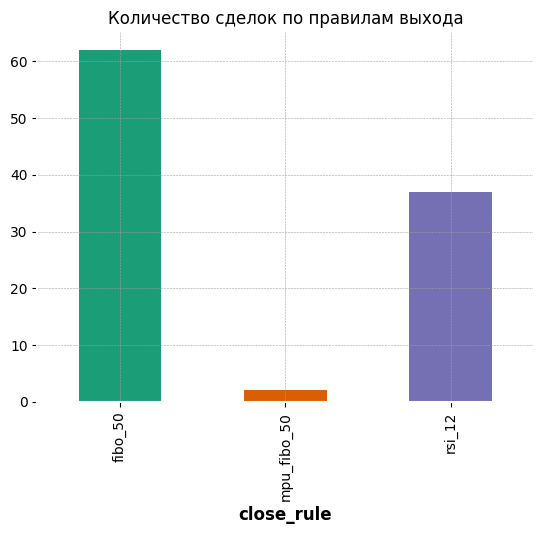

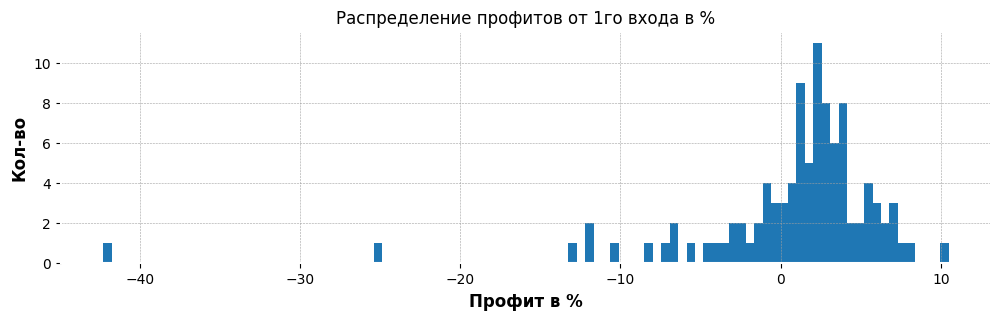

In [19]:
trades.groupby('close_rule').size().plot(kind='bar', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.title('Количество сделок по правилам выхода')
plt.show()
print('')

trades['profit_percent'].hist(bins=100, figsize=(12, 3))
plt.title('Распределение профитов от 1го входа в %')
plt.xlabel('Профит в %')
plt.ylabel('Кол-во')
plt.show()

In [20]:
# сумма профитов в % по правилу закрытия
print('сумма профитов в % по правилу закрытия')
display(trades.groupby(by='close_rule')['profit_percent'].sum())

# сумма профитов в %
print('\nCумма профитов первых входов: ', round(trades['profit_percent'].sum(), 2), '%\n')

# среднее профитов в % по правилу закрытия
print('среднее профитов в % по правилу закрытия')
display(trades.groupby(by='close_rule')['profit_percent'].mean())

# среднее время в сделке по правилу закрытия
print('среднее время в сделке по правилу закрытия')
display(trades.groupby(by='close_rule')['time_in_deal'].mean())

# медианное время в сделке по правилу закрытия
print('медианное время в сделке по правилу закрытия')
trades.groupby(by='close_rule')['time_in_deal'].median()

сумма профитов в % по правилу закрытия


,profit_percent
close_rule,
fibo_50,184.560
mpu_fibo_50,-67.500
rsi_12,-56.121



Cумма профитов первых входов:  60.94 %

среднее профитов в % по правилу закрытия


,profit_percent
close_rule,
fibo_50,2.976774
mpu_fibo_50,-33.750000
rsi_12,-1.516784


среднее время в сделке по правилу закрытия


,time_in_deal
close_rule,
fibo_50,6.774194
mpu_fibo_50,24.000000
rsi_12,20.432432


медианное время в сделке по правилу закрытия


,time_in_deal
close_rule,
fibo_50,5.5
mpu_fibo_50,24.0
rsi_12,20.0


In [21]:
print(f"Все даты алертов в списке трейдов уникальны (алерт отрабатывается единожды): {trades['alert_date'].nunique() == trades.shape[0]}")

Все даты алертов в списке трейдов уникальны (алерт отрабатывается единожды): True


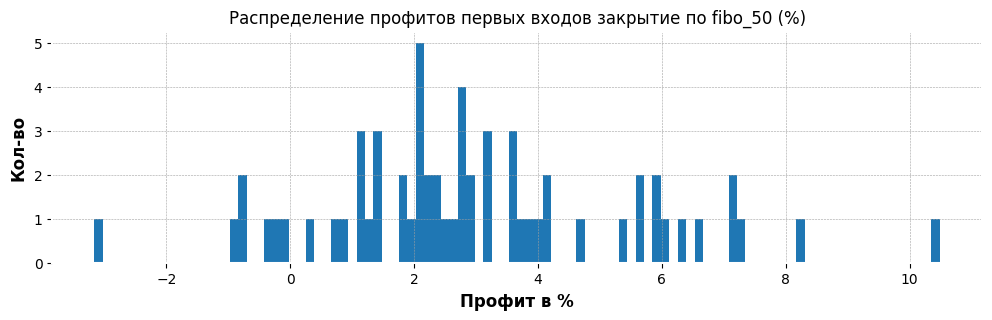

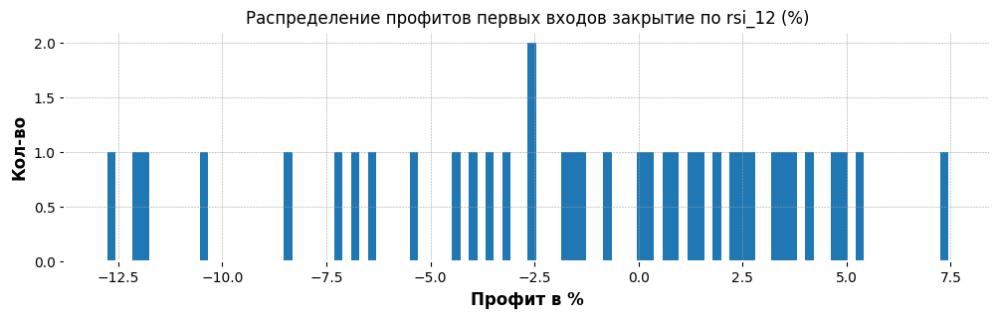

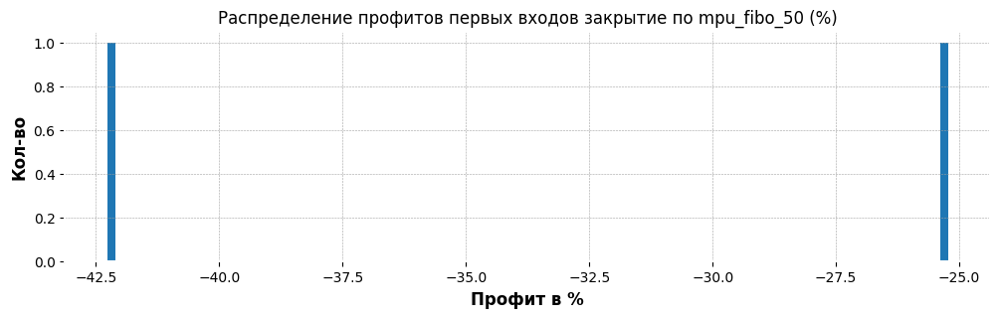

In [23]:
# Распределение профитов первых входов для каждого правила закрытия
for rule in trades['close_rule'].unique():
  trades[trades['close_rule']==rule]['profit_percent'].hist(bins=100, figsize=(12, 3))
  plt.title(f"Распределение профитов первых входов закрытие по {rule} (%)")
  plt.xlabel('Профит в %')
  plt.ylabel('Кол-во')
  plt.show()
  print('')


### Пересчет PNL  с усреднениями

In [24]:
# через сколько % усреднения
new_entry_lvl = 4

# комиссия в %
comission = 0.16

# кол-во повторых входов (начиная со 2го! если 0 - значит был только 1 вход)
trades['entry_cnt'] = (trades['mpu']/new_entry_lvl).astype(int)
#trades[['entry_cnt', 'mpu']]

# средняя цена входа при усреднениях
def get_open_price_mean(row):
  # возвращаем цену входа * уровень средней цены в %
  return row['open_price'] * ((row['entry_cnt'] * new_entry_lvl)/2 +100)/100
trades['open_price_mean'] = trades.apply(get_open_price_mean, axis=1)
#trades[['open_price', 'entry_cnt', 'mpu', 'open_price_mean' ]]

# пнл от средней цены с поправкой на несколько входов
trades['profit_percent_mean_price'] = round((trades['open_price_mean'] - trades['close_price']) / trades['open_price_mean']*100, 2)

# пнл с поправкой на несколько входов
trades['pnl_entr_cnt'] = round(trades['profit_percent_mean_price'] * (trades['entry_cnt'] + 1), 1)

# пнл с поправкой на несколько входов
trades['pnl_with_comission'] = trades['pnl_entr_cnt'] - (comission * (trades['entry_cnt'] + 1))

trades[['pnl_with_comission', 'pnl_entr_cnt', 'entry_cnt', 'profit_percent_mean_price', 'profit_percent', 'close_rule', 'mpu', 'open_price_mean', 'open_price' ]]

,pnl_with_comission,pnl_entr_cnt,entry_cnt,profit_percent_mean_price,profit_percent,close_rule,mpu,open_price_mean,open_price
0,13.72,14.2,2,4.73,0.916,fibo_50,9.7,0.021691,0.020857
1,15.12,15.6,2,5.21,1.422,fibo_50,8.1,0.016232,0.015608
2,4.28,4.6,1,2.31,0.356,fibo_50,7.8,0.014594,0.014308
3,29.08,30.2,6,4.32,-7.160,rsi_12,27.1,0.014829,0.013240
4,5.24,5.4,0,5.43,5.427,fibo_50,1.3,0.015357,0.015357
...,...,...,...,...,...,...,...,...,...
96,1.84,2.0,0,2.03,2.030,fibo_50,1.3,0.013668,0.013668
97,2.54,2.7,0,2.68,2.677,rsi_12,0.3,0.013970,0.013970
98,7.14,7.3,0,7.27,7.273,fibo_50,0.6,0.015584,0.015584
99,2.44,2.6,0,2.63,2.626,fibo_50,0.7,0.012813,0.012813


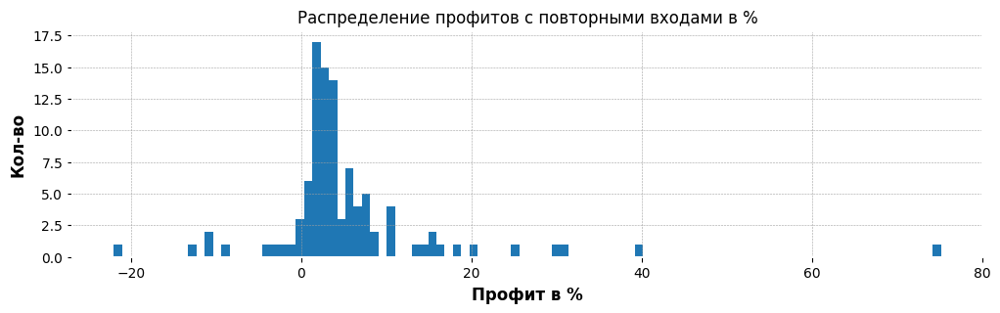

In [25]:
trades['pnl_entr_cnt'].hist(bins=100, figsize=(12, 3))
plt.title('Распределение профитов с повторными входами в %')
plt.xlabel('Профит в %')
plt.ylabel('Кол-во')
plt.show()

In [26]:
# сумма профитов в %  без учета комиссии
print('TOTAL PNL: ', round(trades['pnl_entr_cnt'].sum(), 1), '%')

# КОЛ-ВО сделок
print('\n', 'PNL на сделку: ', round(trades['pnl_entr_cnt'].sum()/trades.shape[0], 2), '%')

# + - pnl и умность
pnl_positive = trades[trades['pnl_entr_cnt']>0]['pnl_entr_cnt'].sum()
pnl_negative = trades[trades['pnl_entr_cnt']<=0]['pnl_entr_cnt'].sum()
intel_model = round(pnl_positive / (pnl_positive+(-pnl_negative))*100, 2)
print('\n', 'УМНОСТЬ МОДЕЛИ: ', intel_model, '%')

# сумма профитов в % по правилу закрытия без учета комиссии
display(trades.groupby(by='close_rule')['pnl_entr_cnt'].sum())

# + - pnl и умность  с комиссией
pnl_positive = trades[trades['pnl_with_comission']>0]['pnl_with_comission'].sum()
pnl_negative = trades[trades['pnl_with_comission']<=0]['pnl_with_comission'].sum()
intel_model = round(pnl_positive / (pnl_positive+(-pnl_negative))*100, 2)
print('\n', 'УМНОСТЬ с Комиссией: ', intel_model, '%')

# сумма профитов в % по правилу закрытия с учетом комиссии
print('\n', 'TOTAL PNL with Comission: ', round(trades['pnl_with_comission'].sum(), 1), '%')
display(trades.groupby(by='close_rule')['pnl_with_comission'].sum())

# среднее профитов в % по правилу закрытия
print('среднее профитов в % по правилу закрытия')
display(trades.groupby(by='close_rule')['pnl_entr_cnt'].mean())

# ТОП-3 самый большой убыток
print('ТОП-3 убытков в % без комиссии')
display(trades.sort_values(by='pnl_entr_cnt', ascending=True)[['open_date', 'pnl_entr_cnt']][:3])

# КОЛ-ВО сделок
print('\n', 'КОЛ-ВО сделок: ', trades.shape[0])

TOTAL PNL:  549.2 %

 PNL на сделку:  5.44 %

 УМНОСТЬ МОДЕЛИ:  89.12 %


,pnl_entr_cnt
close_rule,
fibo_50,438.0
mpu_fibo_50,-17.3
rsi_12,128.5



 УМНОСТЬ с Комиссией:  87.18 %

 TOTAL PNL with Comission:  512.4 %


,pnl_with_comission
close_rule,
fibo_50,422.96
mpu_fibo_50,-22.90
rsi_12,112.34


среднее профитов в % по правилу закрытия


,pnl_entr_cnt
close_rule,
fibo_50,7.064516
mpu_fibo_50,-8.650000
rsi_12,3.472973


ТОП-3 убытков в % без комиссии


,open_date,pnl_entr_cnt
9,2024-02-09 12:00:00,-22.0
14,2024-02-28 22:00:00,-12.9
59,2024-09-26 16:00:00,-11.2



 КОЛ-ВО сделок:  101


In [27]:
trades

,alert_date,alert_price,open_date,open_price,close_date,close_price,close_rule,mpu,mpp,fibo_potencial,fibo_entry_potencial,profit_percent,time_in_deal,time_btw_fibo_alert,entry_cnt,open_price_mean,profit_percent_mean_price,pnl_entr_cnt,pnl_with_comission
0,2023-12-21 21:00:00,0.020197,2023-12-21 22:00:00,0.020857,2023-12-22 02:00:00,0.020666,fibo_50,9.7,4.6,15.4,9.2,0.916,4.0,1.0,2,0.021691,4.73,14.2,13.72
1,2023-12-28 22:00:00,0.015425,2023-12-29 06:00:00,0.015608,2023-12-29 15:00:00,0.015386,fibo_50,8.1,3.9,12.5,8.0,1.422,9.0,8.0,2,0.016232,5.21,15.6,15.12
2,2024-01-01 20:00:00,0.014070,2024-01-01 22:00:00,0.014308,2024-01-02 07:00:00,0.014257,fibo_50,7.8,1.4,9.9,5.6,0.356,9.0,2.0,1,0.014594,2.31,4.6,4.28
3,2024-01-08 18:00:00,0.011175,2024-01-09 04:00:00,0.013240,2024-01-10 12:00:00,0.014188,rsi_12,27.1,9.4,34.6,21.2,-7.160,32.0,10.0,6,0.014829,4.32,30.2,29.08
4,2024-01-13 18:00:00,0.014860,2024-01-13 20:00:00,0.015357,2024-01-14 03:00:00,0.014523,fibo_50,1.3,5.4,11.6,11.2,5.427,7.0,2.0,0,0.015357,5.43,5.4,5.24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,2025-02-25 21:00:00,0.013514,2025-02-26 03:00:00,0.013668,2025-02-26 08:00:00,0.013390,fibo_50,1.3,2.5,4.1,4.1,2.030,5.0,6.0,0,0.013668,2.03,2.0,1.84
97,2025-02-27 06:00:00,0.013910,2025-02-27 10:00:00,0.013970,2025-02-27 14:00:00,0.013596,rsi_12,0.3,2.9,7.4,7.4,2.677,4.0,4.0,0,0.013970,2.68,2.7,2.54
98,2025-03-02 15:00:00,0.013897,2025-03-02 23:00:00,0.015584,2025-03-03 06:00:00,0.014451,fibo_50,0.6,8.6,14.5,14.5,7.273,7.0,8.0,0,0.015584,7.27,7.3,7.14
99,2025-03-07 14:00:00,0.012748,2025-03-07 18:00:00,0.012813,2025-03-07 19:00:00,0.012476,fibo_50,0.7,3.8,5.3,5.3,2.626,1.0,4.0,0,0.012813,2.63,2.6,2.44


## Выводы

За период с 2023-12-17 по 2025-03-19 модель совершила 101 сделку и заработала +549% (за вычетом комиссии +512%).

Доля прибыли от всех прибыльных сделок к сумме % от всех прибыльных и убыточных сделок по модулю: 89% (за вычетом комиссии 87%).

Средняя прибыль на сделку +5,4%.

Частота сделок в среднем: 1,1 сделка в день.

ТОП-3 самых убыточных сделки принесли -22%, -13% и -11% соответственно.

ТОП-3 самых убыточных сделки: +74%, +40%, +30%.

Время в сделке варьиоуется от 1 до 49 часов, в среднем одна сделка длилась 12 часов.

Максимальное кол-во усреднений в 1 сделке - 22 входа.

Волатильность модели (стандартное отклонение прибыли за вычетом комиссии): 10,7%.

Коэффицент восстановления (сколько средних по прибыли сделок понадобится модели, чтобы восстановить накопленную прибыль после максимального убытка): 4 сделки / 4 дня.